# Deep Convolutional GANs

In this notebook, you'll build a GAN using convolutional layers in the generator and discriminator. This is called a Deep Convolutional GAN, or DCGAN for short. The DCGAN architecture was first explored last year and has seen impressive results in generating new images, you can read the [original paper here](https://arxiv.org/pdf/1511.06434.pdf).

You'll be training DCGAN on the [Street View House Numbers](http://ufldl.stanford.edu/housenumbers/) (SVHN) dataset. These are color images of house numbers collected from Google street view. SVHN images are in color and much more variable than MNIST. 

![SVHN Examples](assets/SVHN_examples.png)

So, we'll need a deeper and more powerful network. This is accomplished through using convolutional layers in the discriminator and generator. It's also necessary to use batch normalization to get the convolutional networks to train. The only real changes compared to what [you saw previously](https://github.com/udacity/deep-learning/tree/master/gan_mnist) are in the generator and discriminator, otherwise the rest of the implementation is the same.

In [9]:
%matplotlib inline

import pickle as pkl

import matplotlib.pyplot as plt
import numpy as np
from scipy.io import loadmat
import tensorflow as tf

In [10]:
!mkdir data

mkdir: impossibile creare la directory "data": File già esistente


## Getting the data

Here you can download the SVHN dataset. Run the cell above and it'll download to your machine.

In [11]:
from urllib.request import urlretrieve
from os.path import isfile, isdir
from tqdm import tqdm

data_dir = 'data/'

if not isdir(data_dir):
    raise Exception("Data directory doesn't exist!")

class DLProgress(tqdm):
    last_block = 0

    def hook(self, block_num=1, block_size=1, total_size=None):
        self.total = total_size
        self.update((block_num - self.last_block) * block_size)
        self.last_block = block_num

if not isfile(data_dir + "train_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Training Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/train_32x32.mat',
            data_dir + 'train_32x32.mat',
            pbar.hook)

if not isfile(data_dir + "test_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Training Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/test_32x32.mat',
            data_dir + 'test_32x32.mat',
            pbar.hook)

These SVHN files are `.mat` files typically used with Matlab. However, we can load them in with `scipy.io.loadmat` which we imported above.

In [12]:
trainset = loadmat(data_dir + 'train_32x32.mat')
testset = loadmat(data_dir + 'test_32x32.mat')

Here I'm showing a small sample of the images. Each of these is 32x32 with 3 color channels (RGB). These are the real images we'll pass to the discriminator and what the generator will eventually fake.

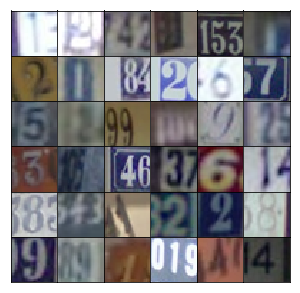

In [13]:
idx = np.random.randint(0, trainset['X'].shape[3], size=36)
fig, axes = plt.subplots(6, 6, sharex=True, sharey=True, figsize=(5,5),)
for ii, ax in zip(idx, axes.flatten()):
    ax.imshow(trainset['X'][:,:,:,ii], aspect='equal')
    ax.xaxis.set_visible(False)
    ax.yaxis.set_visible(False)
plt.subplots_adjust(wspace=0, hspace=0)

Here we need to do a bit of preprocessing and getting the images into a form where we can pass batches to the network. First off, we need to rescale the images to a range of -1 to 1, since the output of our generator is also in that range. We also have a set of test and validation images which could be used if we're trying to identify the numbers in the images.

In [14]:
def scale(x, feature_range=(-1, 1)):
    # scale to (0, 1)
    x = ((x - x.min())/(255 - x.min()))
    
    # scale to feature_range
    min, max = feature_range
    x = x * (max - min) + min
    return x

In [15]:
class Dataset:
    def __init__(self, train, test, val_frac=0.5, shuffle=False, scale_func=None):
        split_idx = int(len(test['y'])*(1 - val_frac))
        self.test_x, self.valid_x = test['X'][:,:,:,:split_idx], test['X'][:,:,:,split_idx:]
        self.test_y, self.valid_y = test['y'][:split_idx], test['y'][split_idx:]
        self.train_x, self.train_y = train['X'], train['y']
        
        self.train_x = np.rollaxis(self.train_x, 3)
        self.valid_x = np.rollaxis(self.valid_x, 3)
        self.test_x = np.rollaxis(self.test_x, 3)
        
        if scale_func is None:
            self.scaler = scale
        else:
            self.scaler = scale_func
        self.shuffle = shuffle
        
    def batches(self, batch_size):
        if self.shuffle:
            idx = np.arange(len(dataset.train_x))
            np.random.shuffle(idx)
            self.train_x = self.train_x[idx]
            self.train_y = self.train_y[idx]
        
        n_batches = len(self.train_y)//batch_size
        for ii in range(0, len(self.train_y), batch_size):
            x = self.train_x[ii:ii+batch_size]
            y = self.train_y[ii:ii+batch_size]
            
            yield self.scaler(x), self.scaler(y)

## Network Inputs

Here, just creating some placeholders like normal.

In [16]:
def model_inputs(real_dim, z_dim):
    inputs_real = tf.placeholder(tf.float32, (None, *real_dim), name='input_real')
    inputs_z = tf.placeholder(tf.float32, (None, z_dim), name='input_z')
    
    return inputs_real, inputs_z

## Generator

Here you'll build the generator network. The input will be our noise vector `z` as before. Also as before, the output will be a $tanh$ output, but this time with size 32x32 which is the size of our SVHN images.

What's new here is we'll use convolutional layers to create our new images. The first layer is a fully connected layer which is reshaped into a deep and narrow layer, something like 4x4x1024 as in the original DCGAN paper. Then we use batch normalization and a leaky ReLU activation. Next is a transposed convolution where typically you'd halve the depth and double the width and height of the previous layer. Again, we use batch normalization and leaky ReLU. For each of these layers, the general scheme is convolution > batch norm > leaky ReLU.

You keep stacking layers up like this until you get the final transposed convolution layer with shape 32x32x3. Below is the archicture used in the original DCGAN paper:

![DCGAN Generator](assets/dcgan.png)

Note that the final layer here is 64x64x3, while for our SVHN dataset, we only want it to be 32x32x3. 

>**Exercise:** Build the transposed convolutional network for the generator in the function below. Be sure to use leaky ReLUs on all the layers except for the last tanh layer, as well as batch normalization on all the transposed convolutional layers except the last one.

In [17]:
# Shape during CNN: 100 -> 4x4x512 -> 8x8x256 -> 16x16x128 -> 32x32x3

def generator(z, output_dim, reuse=False, alpha=0.2, training=True):
    with tf.variable_scope('generator', reuse=reuse):
        
        #1st block -> 4x4x512
        # First fully connected layer
        # From input (1D to 1D of 4*4*512)
        x = tf.layers.dense(z, units=(4*4*512))
        # Reshahe the fully connected result (HWC)
        x1 = tf.reshape(x, shape=(-1,4,4,512))
        # Batch Norm + Leaky ReLU
        x1 = tf.layers.batch_normalization(x1, training=training)
        x1 = tf.maximum(alpha * x1, x1)
        
        #2nd block -> 8x8x256
        # Strides 2 with padding 'same' give the output 8x8 (for the filters we explicitly set 256)
        # Kernel 5x5 set equal to solution
        x2 = tf.layers.conv2d_transpose(x1, filters=256, kernel_size=(5,5), strides=2,
                                        padding='same', activation=None)
        # Batch Norm + Leaky ReLU
        x2 = tf.layers.batch_normalization(x2, training=training)
        x2 = tf.maximum(alpha * x2, x2)
        
        #3rd block -> 16x16x128
        # Strides 2 with padding 'same' give the output 16x16 (for the filters we explicitly set 128)
        # Kernel 5x5 set equal to solution
        x3 = tf.layers.conv2d_transpose(x2, filters=128, kernel_size=(5,5), strides=2, 
                                        padding='same', activation=None,)
        x3 = tf.layers.batch_normalization(x3, training=training)
        x3 = tf.maximum(alpha * x3, x3)
        
        #4th block -> 32x32x3 (no batch normalization and tanh activation)
        logits = tf.layers.conv2d_transpose(x3, filters=output_dim, kernel_size=(5,5), strides=2,
                                        padding='same', activation=None)
        # Output layer, 32x32x3
        
        out = tf.tanh(logits)
        
        return out

## Discriminator

Here you'll build the discriminator. This is basically just a convolutional classifier like you've build before. The input to the discriminator are 32x32x3 tensors/images. You'll want a few convolutional layers, then a fully connected layer for the output. As before, we want a sigmoid output, and you'll need to return the logits as well. For the depths of the convolutional layers I suggest starting with 16, 32, 64 filters in the first layer, then double the depth as you add layers. Note that in the DCGAN paper, they did all the downsampling using only strided convolutional layers with no maxpool layers.

You'll also want to use batch normalization with `tf.layers.batch_normalization` on each layer except the first convolutional and output layers. Again, each layer should look something like convolution > batch norm > leaky ReLU.

Note: in this project, your batch normalization layers will always use batch statistics. (That is, always set `training` to `True`.) That's because we are only interested in using the discriminator to help train the generator. However, if you wanted to use the discriminator for inference later, then you would need to set the `training` parameter appropriately.

>**Exercise:** Build the convolutional network for the discriminator. The input is a 32x32x3 images, the output is a sigmoid plus the logits. Again, use Leaky ReLU activations and batch normalization on all the layers except the first.

In [18]:
# Shape during CNN: 32x32x3 -> 16x16x64 -> 8x8x128 -> 4x4x256 -> 1  

def discriminator(x, reuse=False, alpha=0.2):

    with tf.variable_scope('discriminator', reuse=reuse):
        # Input layer is 32x32x3 -> 16x16x64
        x = tf.layers.conv2d(inputs=x, filters=64, kernel_size=(5,5), strides=2, activation=None, padding='same')
        # No batch normalization, better results
        x = tf.maximum(alpha * x, x)
        
        # -> 8x8x128
        x1 = tf.layers.conv2d(x, filters = 128, kernel_size=(5,5), strides=2, activation=None, padding='same')
        x1 = tf.layers.batch_normalization(x1, training=True)
        x1 = tf.maximum(alpha * x1, x1)
        
        # -> 4x4x256
        x2 = tf.layers.conv2d(x1, filters=256, kernel_size=(5,5), strides=2, activation=None, padding='same')
        x2 = tf.layers.batch_normalization(x2, training=True)
        x2 = tf.maximum(alpha * x2, x2)
        
        # Reshape for final dense layer -> units = 1 for sigmoid
        x3 = tf.reshape(x2, shape=(-1, 4*4*256))
        
        logits = tf.layers.dense(inputs=x3, units=1)
        out = tf.sigmoid(logits)
        
        return out, logits

## Model Loss

Calculating the loss like before, nothing new here.

In [19]:
def model_loss(input_real, input_z, output_dim, alpha=0.2):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    #g_model is the output from the generator, d_model is the output from the discriminator,
    # we need to use logits to calculate the loss, not the final output
    g_model = generator(input_z, output_dim, alpha=alpha)
    d_model_real, d_logits_real = discriminator(input_real, alpha=alpha)
    d_model_fake, d_logits_fake = discriminator(g_model, reuse=True, alpha=alpha)

    d_loss_real = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real, labels=tf.ones_like(d_model_real)))
    d_loss_fake = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.zeros_like(d_model_fake)))
    g_loss = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.ones_like(d_model_fake)))

    d_loss = d_loss_real + d_loss_fake

    return d_loss, g_loss

## Optimizers

Not much new here, but notice how the train operations are wrapped in a `with tf.control_dependencies` block so the batch normalization layers can update their population statistics.

In [20]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    # Get weights and bias to update
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]

    # Optimize
    with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
        d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
        g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(g_loss, var_list=g_vars)

    return d_train_opt, g_train_opt

## Building the model

Here we can use the functions we defined about to build the model as a class. This will make it easier to move the network around in our code since the nodes and operations in the graph are packaged in one object.

In [21]:
class GAN:
    def __init__(self, real_size, z_size, learning_rate, alpha=0.2, beta1=0.5):
        tf.reset_default_graph()
        
        self.input_real, self.input_z = model_inputs(real_size, z_size)
        
        self.d_loss, self.g_loss = model_loss(self.input_real, self.input_z,
                                              real_size[2], alpha=0.2)
        
        self.d_opt, self.g_opt = model_opt(self.d_loss, self.g_loss, learning_rate, 0.5)

Here is a function for displaying generated images.

In [22]:
def view_samples(epoch, samples, nrows, ncols, figsize=(5,5)):
    fig, axes = plt.subplots(figsize=figsize, nrows=nrows, ncols=ncols, 
                             sharey=True, sharex=True)
    for ax, img in zip(axes.flatten(), samples[epoch]):
        ax.axis('off')
        img = ((img - img.min())*255 / (img.max() - img.min())).astype(np.uint8)
        ax.set_adjustable('box-forced')
        im = ax.imshow(img, aspect='equal')
   
    plt.subplots_adjust(wspace=0, hspace=0)
    return fig, axes

And another function we can use to train our network. Notice when we call `generator` to create the samples to display, we set `training` to `False`. That's so the batch normalization layers will use the population statistics rather than the batch statistics. Also notice that we set the `net.input_real` placeholder when we run the generator's optimizer. The generator doesn't actually use it, but we'd get an errror without it because of the `tf.control_dependencies` block we created in `model_opt`. 

In [23]:
def train(net, dataset, epochs, batch_size, print_every=10, show_every=100, figsize=(5,5)):
    saver = tf.train.Saver()
    sample_z = np.random.uniform(-1, 1, size=(72, z_size))

    samples, losses = [], []
    steps = 0

    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for e in range(epochs):
            for x, y in dataset.batches(batch_size):
                steps += 1

                # Sample random noise for G
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_size))

                # Run optimizers
                _ = sess.run(net.d_opt, feed_dict={net.input_real: x, net.input_z: batch_z})
                _ = sess.run(net.g_opt, feed_dict={net.input_z: batch_z, net.input_real: x})

                if steps % print_every == 0:
                    # At the end of each epoch, get the losses and print them out
                    train_loss_d = net.d_loss.eval({net.input_z: batch_z, net.input_real: x})
                    train_loss_g = net.g_loss.eval({net.input_z: batch_z})

                    print("Epoch {}/{}...".format(e+1, epochs),
                          "Discriminator Loss: {:.4f}...".format(train_loss_d),
                          "Generator Loss: {:.4f}".format(train_loss_g))
                    # Save losses to view after training
                    losses.append((train_loss_d, train_loss_g))

                if steps % show_every == 0:
                    gen_samples = sess.run(
                                   generator(net.input_z, 3, reuse=True, training=False),
                                   feed_dict={net.input_z: sample_z})
                    samples.append(gen_samples)
                    _ = view_samples(-1, samples, 6, 12, figsize=figsize)
                    plt.show()

        saver.save(sess, './checkpoints/generator.ckpt')

    with open('samples.pkl', 'wb') as f:
        pkl.dump(samples, f)
    
    return losses, samples

## Hyperparameters

GANs are very senstive to hyperparameters. A lot of experimentation goes into finding the best hyperparameters such that the generator and discriminator don't overpower each other. Try out your own hyperparameters or read [the DCGAN paper](https://arxiv.org/pdf/1511.06434.pdf) to see what worked for them.

>**Exercise:** Find hyperparameters to train this GAN. The values found in the DCGAN paper work well, or you can experiment on your own. In general, you want the discriminator loss to be around 0.3, this means it is correctly classifying images as fake or real about 50% of the time.

In [26]:
real_size = (32,32,3)
z_size = 100
# Magic numbers from DCGAN paper
learning_rate = 0.0002
batch_size = 128
epochs = 25
alpha = 0.2
beta1 = 0.5

# Create the network
net = GAN(real_size, z_size, learning_rate, alpha=alpha, beta1=beta1)

Epoch 1/25... Discriminator Loss: 1.4240... Generator Loss: 0.6111
Epoch 1/25... Discriminator Loss: 0.5916... Generator Loss: 1.1925
Epoch 1/25... Discriminator Loss: 0.2566... Generator Loss: 2.0120
Epoch 1/25... Discriminator Loss: 0.1908... Generator Loss: 2.4833
Epoch 1/25... Discriminator Loss: 0.1307... Generator Loss: 2.9911
Epoch 1/25... Discriminator Loss: 0.1305... Generator Loss: 2.7072
Epoch 1/25... Discriminator Loss: 0.1397... Generator Loss: 2.9191
Epoch 1/25... Discriminator Loss: 0.1793... Generator Loss: 2.6772
Epoch 1/25... Discriminator Loss: 0.1929... Generator Loss: 2.6092
Epoch 1/25... Discriminator Loss: 1.5158... Generator Loss: 0.7005


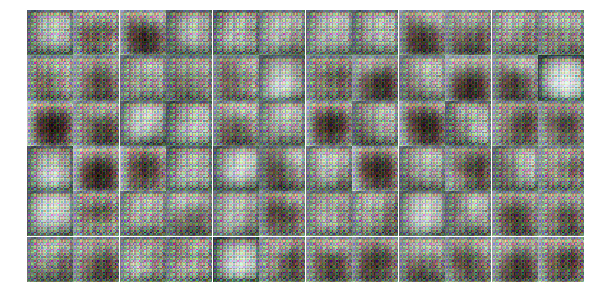

Epoch 1/25... Discriminator Loss: 0.6725... Generator Loss: 1.3368
Epoch 1/25... Discriminator Loss: 0.5253... Generator Loss: 2.2979
Epoch 1/25... Discriminator Loss: 1.1635... Generator Loss: 1.0173
Epoch 1/25... Discriminator Loss: 0.3339... Generator Loss: 1.9287
Epoch 1/25... Discriminator Loss: 0.5774... Generator Loss: 1.5711
Epoch 1/25... Discriminator Loss: 0.6762... Generator Loss: 2.6662
Epoch 1/25... Discriminator Loss: 0.2219... Generator Loss: 2.3172
Epoch 1/25... Discriminator Loss: 0.3469... Generator Loss: 4.6602
Epoch 1/25... Discriminator Loss: 0.3351... Generator Loss: 2.1422
Epoch 1/25... Discriminator Loss: 0.1539... Generator Loss: 2.7335


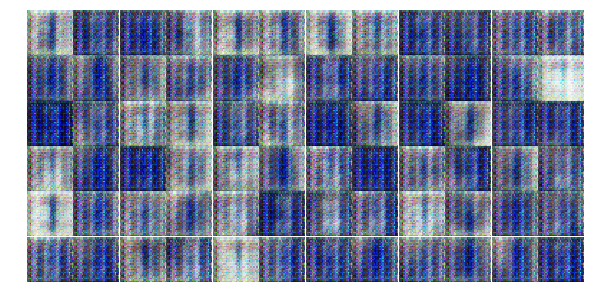

Epoch 1/25... Discriminator Loss: 0.1443... Generator Loss: 3.4582
Epoch 1/25... Discriminator Loss: 1.1428... Generator Loss: 0.6988
Epoch 1/25... Discriminator Loss: 0.7488... Generator Loss: 1.6720
Epoch 1/25... Discriminator Loss: 0.6536... Generator Loss: 1.2956
Epoch 1/25... Discriminator Loss: 2.9967... Generator Loss: 6.9527
Epoch 1/25... Discriminator Loss: 0.7536... Generator Loss: 1.5404
Epoch 1/25... Discriminator Loss: 0.4703... Generator Loss: 3.8962
Epoch 1/25... Discriminator Loss: 0.7971... Generator Loss: 0.9700
Epoch 1/25... Discriminator Loss: 0.9515... Generator Loss: 0.8672
Epoch 1/25... Discriminator Loss: 0.6481... Generator Loss: 1.7860


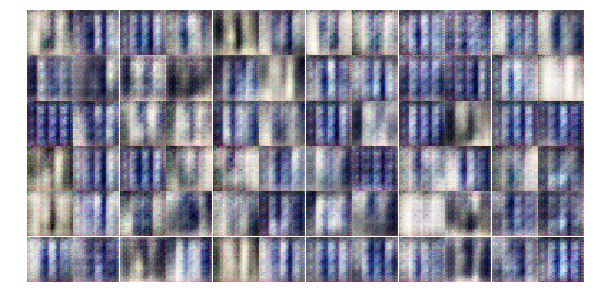

Epoch 1/25... Discriminator Loss: 0.4566... Generator Loss: 2.7318
Epoch 1/25... Discriminator Loss: 0.6995... Generator Loss: 1.6556
Epoch 1/25... Discriminator Loss: 0.4384... Generator Loss: 1.5990
Epoch 1/25... Discriminator Loss: 0.5868... Generator Loss: 1.6055
Epoch 1/25... Discriminator Loss: 0.2671... Generator Loss: 2.9913
Epoch 1/25... Discriminator Loss: 0.3397... Generator Loss: 2.0125
Epoch 1/25... Discriminator Loss: 0.7503... Generator Loss: 1.4666
Epoch 1/25... Discriminator Loss: 0.5646... Generator Loss: 1.8648
Epoch 1/25... Discriminator Loss: 0.5277... Generator Loss: 1.8122
Epoch 1/25... Discriminator Loss: 0.4985... Generator Loss: 2.1781


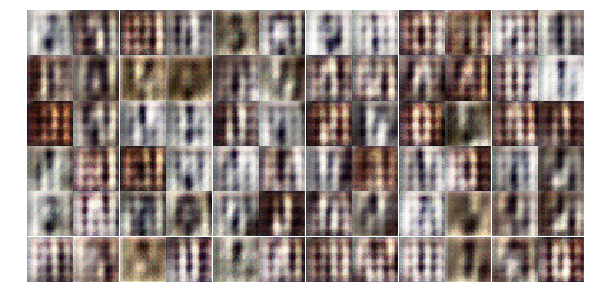

Epoch 1/25... Discriminator Loss: 0.3890... Generator Loss: 1.8116
Epoch 1/25... Discriminator Loss: 0.5359... Generator Loss: 2.7070
Epoch 1/25... Discriminator Loss: 0.6063... Generator Loss: 1.5523
Epoch 1/25... Discriminator Loss: 0.4342... Generator Loss: 2.4228
Epoch 1/25... Discriminator Loss: 1.2967... Generator Loss: 3.6004
Epoch 1/25... Discriminator Loss: 1.1820... Generator Loss: 0.6447
Epoch 1/25... Discriminator Loss: 0.6794... Generator Loss: 1.4303
Epoch 1/25... Discriminator Loss: 0.7071... Generator Loss: 1.4035
Epoch 1/25... Discriminator Loss: 0.7731... Generator Loss: 1.0620
Epoch 1/25... Discriminator Loss: 0.4480... Generator Loss: 1.7489


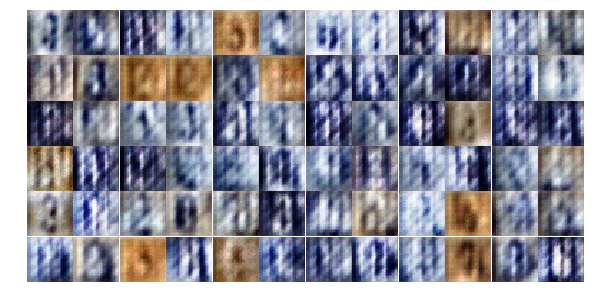

Epoch 1/25... Discriminator Loss: 0.8952... Generator Loss: 2.1899
Epoch 1/25... Discriminator Loss: 0.7492... Generator Loss: 0.9546
Epoch 1/25... Discriminator Loss: 0.6841... Generator Loss: 1.6664
Epoch 1/25... Discriminator Loss: 0.9764... Generator Loss: 0.9128
Epoch 1/25... Discriminator Loss: 0.6722... Generator Loss: 1.9226
Epoch 1/25... Discriminator Loss: 0.9332... Generator Loss: 0.8359
Epoch 1/25... Discriminator Loss: 0.8062... Generator Loss: 1.2503
Epoch 2/25... Discriminator Loss: 1.0939... Generator Loss: 1.3661
Epoch 2/25... Discriminator Loss: 1.1818... Generator Loss: 1.3113
Epoch 2/25... Discriminator Loss: 0.6557... Generator Loss: 1.4944


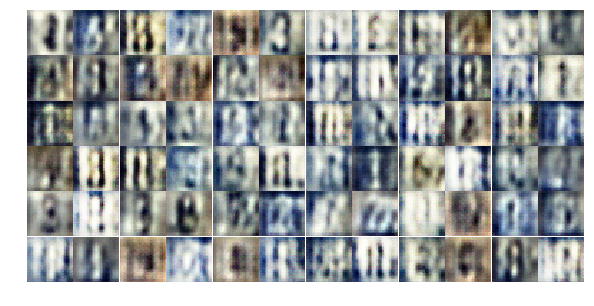

Epoch 2/25... Discriminator Loss: 0.9668... Generator Loss: 1.1023
Epoch 2/25... Discriminator Loss: 0.6117... Generator Loss: 1.8233
Epoch 2/25... Discriminator Loss: 1.4432... Generator Loss: 0.6881
Epoch 2/25... Discriminator Loss: 1.0512... Generator Loss: 1.0653
Epoch 2/25... Discriminator Loss: 0.9773... Generator Loss: 1.0471
Epoch 2/25... Discriminator Loss: 0.6340... Generator Loss: 1.2848
Epoch 2/25... Discriminator Loss: 0.9486... Generator Loss: 1.1159
Epoch 2/25... Discriminator Loss: 1.3065... Generator Loss: 1.1384
Epoch 2/25... Discriminator Loss: 1.5859... Generator Loss: 0.3728
Epoch 2/25... Discriminator Loss: 0.7268... Generator Loss: 1.3722


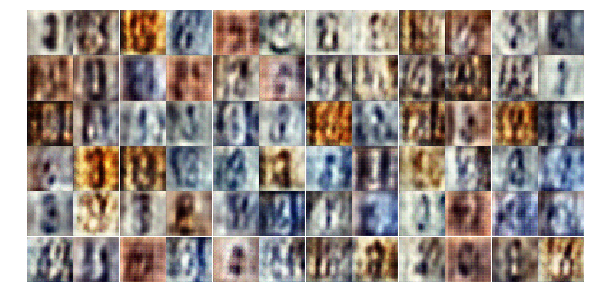

Epoch 2/25... Discriminator Loss: 1.0453... Generator Loss: 0.8766
Epoch 2/25... Discriminator Loss: 0.8527... Generator Loss: 1.1996
Epoch 2/25... Discriminator Loss: 0.7818... Generator Loss: 1.3021
Epoch 2/25... Discriminator Loss: 1.0940... Generator Loss: 0.9973
Epoch 2/25... Discriminator Loss: 1.3287... Generator Loss: 1.1453
Epoch 2/25... Discriminator Loss: 1.2250... Generator Loss: 1.0950
Epoch 2/25... Discriminator Loss: 1.1947... Generator Loss: 0.6885
Epoch 2/25... Discriminator Loss: 1.0241... Generator Loss: 0.8440
Epoch 2/25... Discriminator Loss: 0.8742... Generator Loss: 1.0215
Epoch 2/25... Discriminator Loss: 0.9229... Generator Loss: 1.0899


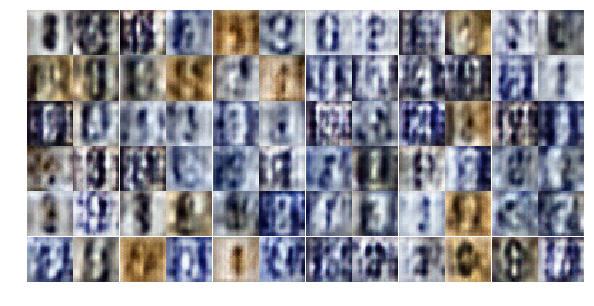

Epoch 2/25... Discriminator Loss: 1.1335... Generator Loss: 0.9184
Epoch 2/25... Discriminator Loss: 1.0412... Generator Loss: 1.0125
Epoch 2/25... Discriminator Loss: 1.0151... Generator Loss: 1.1184
Epoch 2/25... Discriminator Loss: 1.0183... Generator Loss: 1.2042
Epoch 2/25... Discriminator Loss: 1.1562... Generator Loss: 1.0456
Epoch 2/25... Discriminator Loss: 1.0354... Generator Loss: 1.0551
Epoch 2/25... Discriminator Loss: 1.3202... Generator Loss: 0.5678
Epoch 2/25... Discriminator Loss: 0.8313... Generator Loss: 0.9755
Epoch 2/25... Discriminator Loss: 1.3064... Generator Loss: 0.5972
Epoch 2/25... Discriminator Loss: 1.1356... Generator Loss: 0.9506


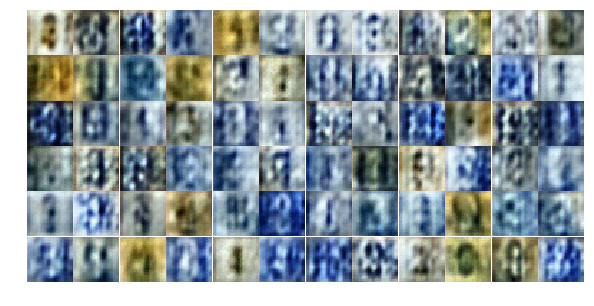

Epoch 2/25... Discriminator Loss: 1.2334... Generator Loss: 0.8126
Epoch 2/25... Discriminator Loss: 1.1805... Generator Loss: 1.0085
Epoch 2/25... Discriminator Loss: 1.5097... Generator Loss: 0.6660
Epoch 2/25... Discriminator Loss: 1.0942... Generator Loss: 0.9180
Epoch 2/25... Discriminator Loss: 0.9593... Generator Loss: 1.0652
Epoch 2/25... Discriminator Loss: 1.0024... Generator Loss: 1.0327
Epoch 2/25... Discriminator Loss: 1.1008... Generator Loss: 1.0077
Epoch 2/25... Discriminator Loss: 0.7984... Generator Loss: 1.3858
Epoch 2/25... Discriminator Loss: 1.0691... Generator Loss: 1.1305
Epoch 2/25... Discriminator Loss: 1.0711... Generator Loss: 0.9875


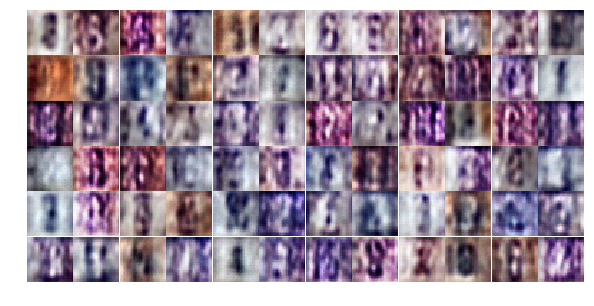

Epoch 2/25... Discriminator Loss: 0.9227... Generator Loss: 1.4074
Epoch 2/25... Discriminator Loss: 1.0625... Generator Loss: 0.8606
Epoch 2/25... Discriminator Loss: 0.8343... Generator Loss: 0.9834
Epoch 2/25... Discriminator Loss: 0.9980... Generator Loss: 0.9400
Epoch 2/25... Discriminator Loss: 1.2815... Generator Loss: 0.9563
Epoch 2/25... Discriminator Loss: 1.0597... Generator Loss: 1.0408
Epoch 2/25... Discriminator Loss: 0.9617... Generator Loss: 1.7492
Epoch 2/25... Discriminator Loss: 1.0726... Generator Loss: 0.8560
Epoch 2/25... Discriminator Loss: 0.8249... Generator Loss: 1.2476
Epoch 2/25... Discriminator Loss: 0.8597... Generator Loss: 1.0118


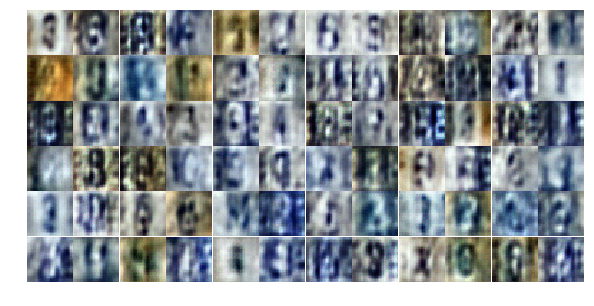

Epoch 2/25... Discriminator Loss: 0.8336... Generator Loss: 1.2905
Epoch 2/25... Discriminator Loss: 0.9552... Generator Loss: 0.9611
Epoch 2/25... Discriminator Loss: 1.0367... Generator Loss: 0.6910
Epoch 2/25... Discriminator Loss: 1.0192... Generator Loss: 0.7837
Epoch 3/25... Discriminator Loss: 0.7525... Generator Loss: 1.7787
Epoch 3/25... Discriminator Loss: 0.9020... Generator Loss: 1.1857
Epoch 3/25... Discriminator Loss: 0.8307... Generator Loss: 1.1814
Epoch 3/25... Discriminator Loss: 0.6532... Generator Loss: 1.3910
Epoch 3/25... Discriminator Loss: 0.8782... Generator Loss: 1.5428
Epoch 3/25... Discriminator Loss: 1.1361... Generator Loss: 1.9183


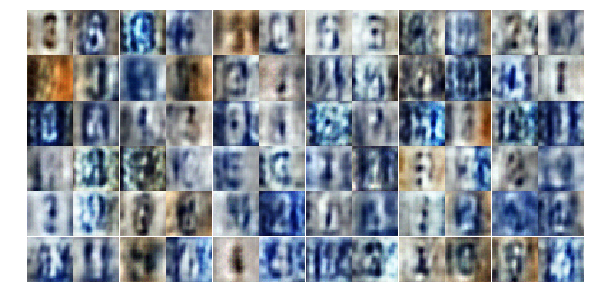

Epoch 3/25... Discriminator Loss: 0.8673... Generator Loss: 1.2703
Epoch 3/25... Discriminator Loss: 0.6352... Generator Loss: 1.4407
Epoch 3/25... Discriminator Loss: 0.8557... Generator Loss: 0.7897
Epoch 3/25... Discriminator Loss: 1.3377... Generator Loss: 0.4547
Epoch 3/25... Discriminator Loss: 0.8361... Generator Loss: 0.9848
Epoch 3/25... Discriminator Loss: 0.9649... Generator Loss: 1.1347
Epoch 3/25... Discriminator Loss: 0.9512... Generator Loss: 0.9813
Epoch 3/25... Discriminator Loss: 0.6839... Generator Loss: 1.7979
Epoch 3/25... Discriminator Loss: 0.7523... Generator Loss: 0.8675
Epoch 3/25... Discriminator Loss: 0.9843... Generator Loss: 0.8236


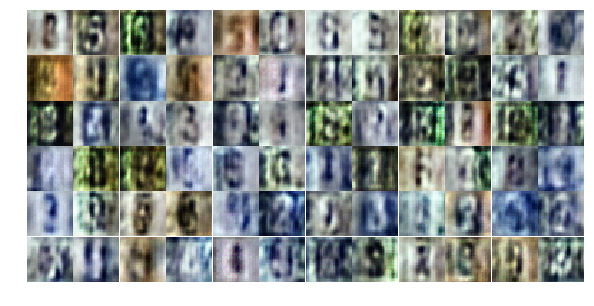

Epoch 3/25... Discriminator Loss: 0.7405... Generator Loss: 1.2319
Epoch 3/25... Discriminator Loss: 1.0283... Generator Loss: 0.6705
Epoch 3/25... Discriminator Loss: 0.3494... Generator Loss: 1.9055
Epoch 3/25... Discriminator Loss: 1.2695... Generator Loss: 2.0742
Epoch 3/25... Discriminator Loss: 0.4687... Generator Loss: 1.8083
Epoch 3/25... Discriminator Loss: 0.7337... Generator Loss: 1.4363
Epoch 3/25... Discriminator Loss: 1.5338... Generator Loss: 1.8801
Epoch 3/25... Discriminator Loss: 0.7197... Generator Loss: 1.6963
Epoch 3/25... Discriminator Loss: 1.0059... Generator Loss: 0.6687
Epoch 3/25... Discriminator Loss: 0.6371... Generator Loss: 1.3990


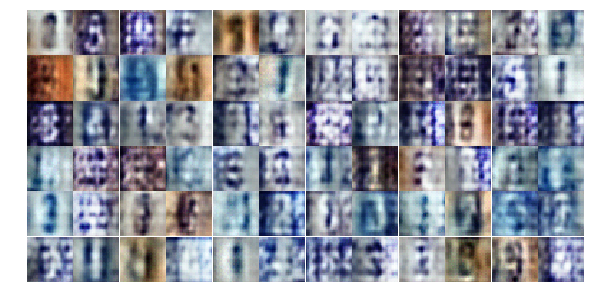

Epoch 3/25... Discriminator Loss: 0.4723... Generator Loss: 1.7177
Epoch 3/25... Discriminator Loss: 0.5611... Generator Loss: 1.2991
Epoch 3/25... Discriminator Loss: 0.5605... Generator Loss: 1.3181
Epoch 3/25... Discriminator Loss: 0.9457... Generator Loss: 0.7370
Epoch 3/25... Discriminator Loss: 0.5951... Generator Loss: 2.2710
Epoch 3/25... Discriminator Loss: 0.6590... Generator Loss: 1.2970
Epoch 3/25... Discriminator Loss: 0.7081... Generator Loss: 1.4078
Epoch 3/25... Discriminator Loss: 1.4385... Generator Loss: 3.3762
Epoch 3/25... Discriminator Loss: 0.6164... Generator Loss: 1.9293
Epoch 3/25... Discriminator Loss: 0.6401... Generator Loss: 1.9229


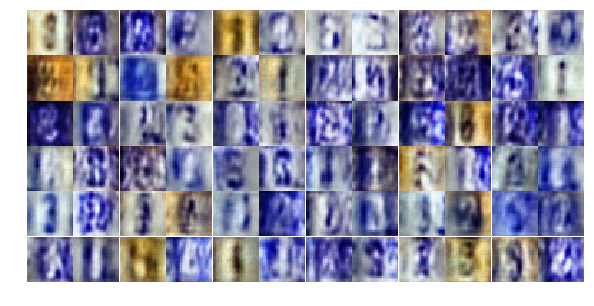

Epoch 3/25... Discriminator Loss: 0.5079... Generator Loss: 2.5758
Epoch 3/25... Discriminator Loss: 0.2853... Generator Loss: 2.7862
Epoch 3/25... Discriminator Loss: 0.8351... Generator Loss: 0.9083
Epoch 3/25... Discriminator Loss: 0.7568... Generator Loss: 1.3705
Epoch 3/25... Discriminator Loss: 0.5050... Generator Loss: 1.7635
Epoch 3/25... Discriminator Loss: 0.5700... Generator Loss: 1.6646
Epoch 3/25... Discriminator Loss: 0.4070... Generator Loss: 1.8659
Epoch 3/25... Discriminator Loss: 0.5449... Generator Loss: 1.4224
Epoch 3/25... Discriminator Loss: 1.6613... Generator Loss: 0.3379
Epoch 3/25... Discriminator Loss: 0.9565... Generator Loss: 0.8208


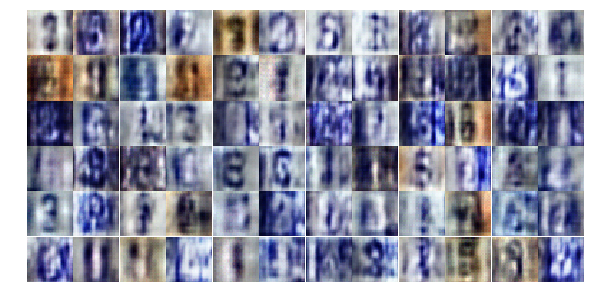

Epoch 3/25... Discriminator Loss: 0.9079... Generator Loss: 1.0407
Epoch 3/25... Discriminator Loss: 1.6584... Generator Loss: 0.3681
Epoch 3/25... Discriminator Loss: 0.8163... Generator Loss: 2.8348
Epoch 3/25... Discriminator Loss: 0.8949... Generator Loss: 0.8816
Epoch 3/25... Discriminator Loss: 0.4169... Generator Loss: 1.9321
Epoch 3/25... Discriminator Loss: 0.3602... Generator Loss: 2.2312
Epoch 3/25... Discriminator Loss: 0.5030... Generator Loss: 1.7429
Epoch 3/25... Discriminator Loss: 0.5381... Generator Loss: 2.1053
Epoch 3/25... Discriminator Loss: 0.3985... Generator Loss: 1.9851
Epoch 3/25... Discriminator Loss: 0.4450... Generator Loss: 1.9983


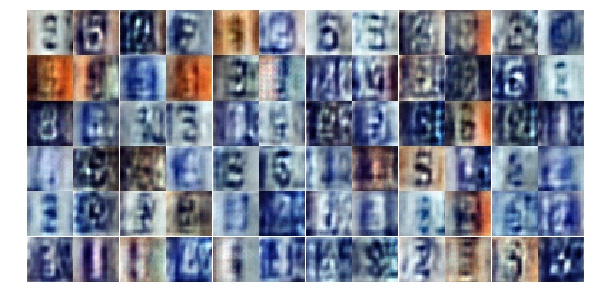

Epoch 3/25... Discriminator Loss: 2.0512... Generator Loss: 0.2214
Epoch 4/25... Discriminator Loss: 0.9553... Generator Loss: 0.7453
Epoch 4/25... Discriminator Loss: 0.3809... Generator Loss: 1.8641
Epoch 4/25... Discriminator Loss: 0.6344... Generator Loss: 1.0462
Epoch 4/25... Discriminator Loss: 0.7685... Generator Loss: 1.7498
Epoch 4/25... Discriminator Loss: 0.7125... Generator Loss: 2.0971
Epoch 4/25... Discriminator Loss: 0.6040... Generator Loss: 1.5607
Epoch 4/25... Discriminator Loss: 0.6609... Generator Loss: 1.4394
Epoch 4/25... Discriminator Loss: 0.5807... Generator Loss: 1.9527
Epoch 4/25... Discriminator Loss: 1.2830... Generator Loss: 0.4788


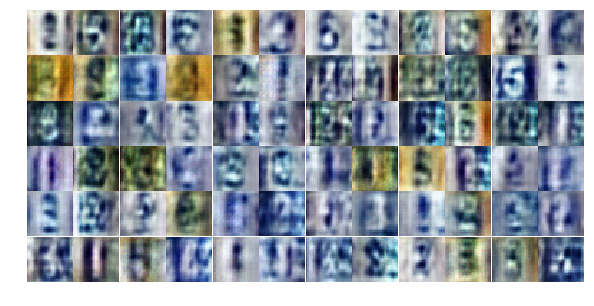

Epoch 4/25... Discriminator Loss: 0.4259... Generator Loss: 1.6121
Epoch 4/25... Discriminator Loss: 0.5429... Generator Loss: 2.1443
Epoch 4/25... Discriminator Loss: 0.6686... Generator Loss: 1.1289
Epoch 4/25... Discriminator Loss: 2.2289... Generator Loss: 3.9907
Epoch 4/25... Discriminator Loss: 1.1175... Generator Loss: 0.6058
Epoch 4/25... Discriminator Loss: 0.8337... Generator Loss: 0.7740
Epoch 4/25... Discriminator Loss: 2.0254... Generator Loss: 0.2232
Epoch 4/25... Discriminator Loss: 0.5323... Generator Loss: 1.8514
Epoch 4/25... Discriminator Loss: 0.4891... Generator Loss: 1.4875
Epoch 4/25... Discriminator Loss: 0.5579... Generator Loss: 1.5526


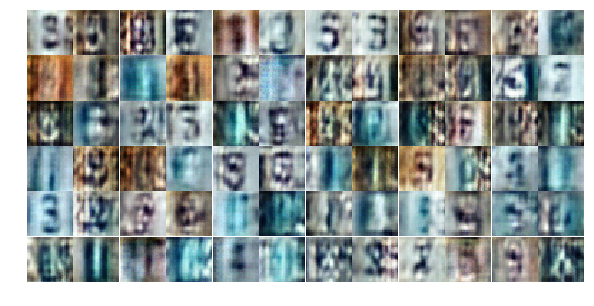

Epoch 4/25... Discriminator Loss: 0.4101... Generator Loss: 1.9419
Epoch 4/25... Discriminator Loss: 0.4041... Generator Loss: 1.6741
Epoch 4/25... Discriminator Loss: 0.3573... Generator Loss: 1.8038
Epoch 4/25... Discriminator Loss: 0.5125... Generator Loss: 1.4330
Epoch 4/25... Discriminator Loss: 0.4662... Generator Loss: 2.9954
Epoch 4/25... Discriminator Loss: 0.4481... Generator Loss: 1.4331
Epoch 4/25... Discriminator Loss: 0.9707... Generator Loss: 0.8111
Epoch 4/25... Discriminator Loss: 0.7768... Generator Loss: 0.9147
Epoch 4/25... Discriminator Loss: 0.3188... Generator Loss: 1.9260
Epoch 4/25... Discriminator Loss: 1.0138... Generator Loss: 0.6766


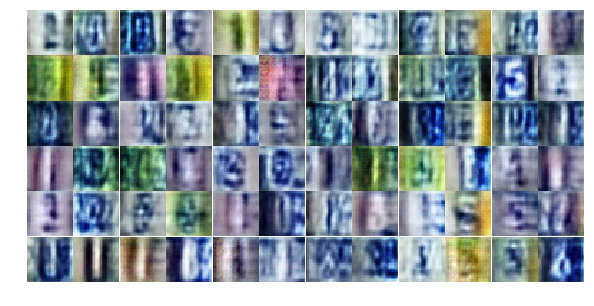

Epoch 4/25... Discriminator Loss: 0.3541... Generator Loss: 1.8284
Epoch 4/25... Discriminator Loss: 0.4803... Generator Loss: 2.9362
Epoch 4/25... Discriminator Loss: 0.4017... Generator Loss: 1.7718
Epoch 4/25... Discriminator Loss: 0.5369... Generator Loss: 1.4420
Epoch 4/25... Discriminator Loss: 0.4328... Generator Loss: 2.2537
Epoch 4/25... Discriminator Loss: 0.6496... Generator Loss: 1.0406
Epoch 4/25... Discriminator Loss: 0.6154... Generator Loss: 2.8970
Epoch 4/25... Discriminator Loss: 0.4018... Generator Loss: 3.5254
Epoch 4/25... Discriminator Loss: 0.9167... Generator Loss: 0.7086
Epoch 4/25... Discriminator Loss: 0.6822... Generator Loss: 1.2528


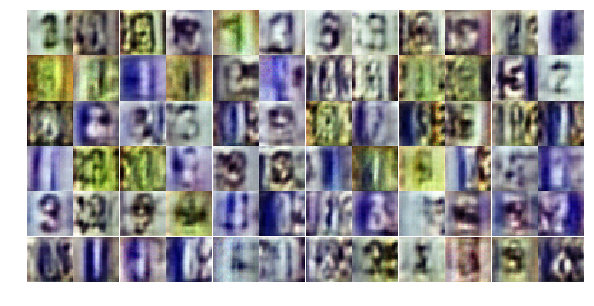

Epoch 4/25... Discriminator Loss: 0.8754... Generator Loss: 0.8213
Epoch 4/25... Discriminator Loss: 0.2542... Generator Loss: 2.4240
Epoch 4/25... Discriminator Loss: 0.5065... Generator Loss: 3.3062
Epoch 4/25... Discriminator Loss: 0.4540... Generator Loss: 1.6130
Epoch 4/25... Discriminator Loss: 0.3076... Generator Loss: 2.0370
Epoch 4/25... Discriminator Loss: 0.8238... Generator Loss: 1.2007
Epoch 4/25... Discriminator Loss: 1.9177... Generator Loss: 0.2663
Epoch 4/25... Discriminator Loss: 0.5400... Generator Loss: 1.5817
Epoch 4/25... Discriminator Loss: 0.4892... Generator Loss: 1.3326
Epoch 4/25... Discriminator Loss: 0.5042... Generator Loss: 1.4704


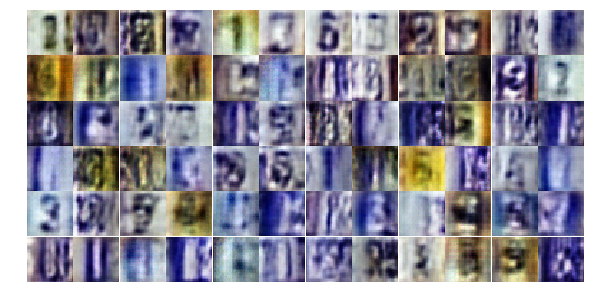

Epoch 4/25... Discriminator Loss: 0.8888... Generator Loss: 0.7583
Epoch 4/25... Discriminator Loss: 0.5207... Generator Loss: 1.4619
Epoch 4/25... Discriminator Loss: 0.2563... Generator Loss: 4.1943
Epoch 4/25... Discriminator Loss: 0.5578... Generator Loss: 3.7604
Epoch 4/25... Discriminator Loss: 0.7729... Generator Loss: 1.6970
Epoch 4/25... Discriminator Loss: 0.9983... Generator Loss: 0.6403
Epoch 4/25... Discriminator Loss: 0.5350... Generator Loss: 1.2730
Epoch 4/25... Discriminator Loss: 0.9937... Generator Loss: 3.0454
Epoch 4/25... Discriminator Loss: 0.5906... Generator Loss: 1.2547
Epoch 5/25... Discriminator Loss: 0.3285... Generator Loss: 2.1080


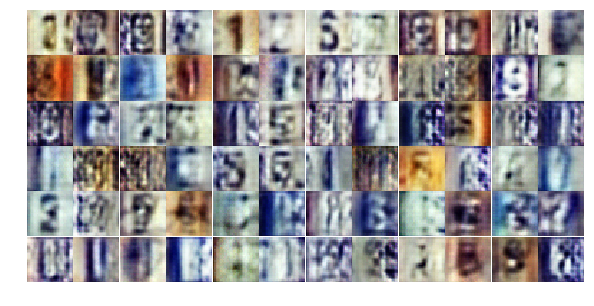

Epoch 5/25... Discriminator Loss: 0.4594... Generator Loss: 1.5982
Epoch 5/25... Discriminator Loss: 0.3777... Generator Loss: 1.7459
Epoch 5/25... Discriminator Loss: 0.3526... Generator Loss: 1.7961
Epoch 5/25... Discriminator Loss: 0.6092... Generator Loss: 1.0820
Epoch 5/25... Discriminator Loss: 0.4085... Generator Loss: 2.4484
Epoch 5/25... Discriminator Loss: 0.4610... Generator Loss: 1.6703
Epoch 5/25... Discriminator Loss: 0.8108... Generator Loss: 0.8547
Epoch 5/25... Discriminator Loss: 0.3319... Generator Loss: 2.2898
Epoch 5/25... Discriminator Loss: 0.6798... Generator Loss: 0.9919
Epoch 5/25... Discriminator Loss: 0.4936... Generator Loss: 1.3279


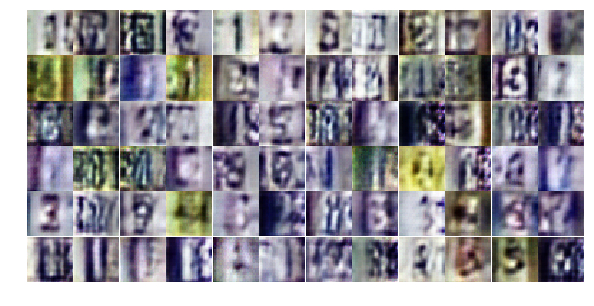

Epoch 5/25... Discriminator Loss: 0.6747... Generator Loss: 0.9614
Epoch 5/25... Discriminator Loss: 0.4026... Generator Loss: 1.8349
Epoch 5/25... Discriminator Loss: 0.3849... Generator Loss: 1.7404
Epoch 5/25... Discriminator Loss: 1.9819... Generator Loss: 0.2033
Epoch 5/25... Discriminator Loss: 0.5729... Generator Loss: 1.5176
Epoch 5/25... Discriminator Loss: 0.5789... Generator Loss: 1.3853
Epoch 5/25... Discriminator Loss: 0.6679... Generator Loss: 1.4131
Epoch 5/25... Discriminator Loss: 0.3146... Generator Loss: 3.0534
Epoch 5/25... Discriminator Loss: 0.4671... Generator Loss: 1.5572
Epoch 5/25... Discriminator Loss: 0.5299... Generator Loss: 1.4230


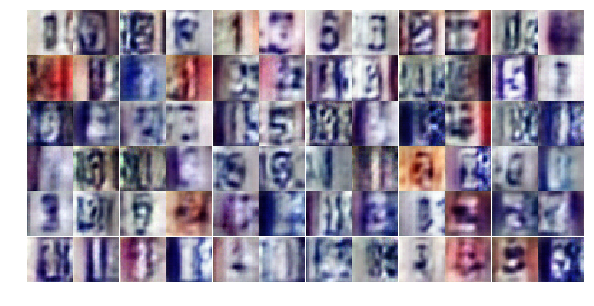

Epoch 5/25... Discriminator Loss: 0.5092... Generator Loss: 1.2962
Epoch 5/25... Discriminator Loss: 0.6900... Generator Loss: 0.9360
Epoch 5/25... Discriminator Loss: 0.5572... Generator Loss: 1.2380
Epoch 5/25... Discriminator Loss: 0.5293... Generator Loss: 1.4462
Epoch 5/25... Discriminator Loss: 1.0300... Generator Loss: 0.5934
Epoch 5/25... Discriminator Loss: 0.5091... Generator Loss: 1.2501
Epoch 5/25... Discriminator Loss: 0.6530... Generator Loss: 1.2723
Epoch 5/25... Discriminator Loss: 0.8300... Generator Loss: 0.8092
Epoch 5/25... Discriminator Loss: 0.8856... Generator Loss: 1.5119
Epoch 5/25... Discriminator Loss: 0.3510... Generator Loss: 1.8308


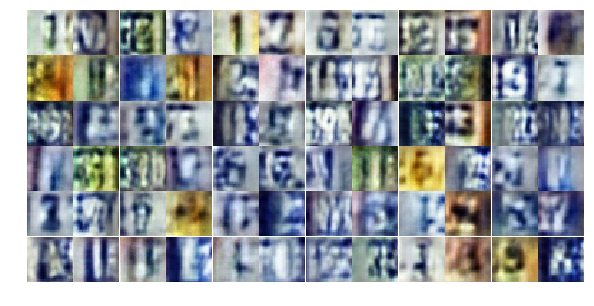

Epoch 5/25... Discriminator Loss: 0.4726... Generator Loss: 2.6535
Epoch 5/25... Discriminator Loss: 0.5563... Generator Loss: 1.2943
Epoch 5/25... Discriminator Loss: 0.5648... Generator Loss: 1.2239
Epoch 5/25... Discriminator Loss: 0.7203... Generator Loss: 0.9676
Epoch 5/25... Discriminator Loss: 0.5598... Generator Loss: 1.7105
Epoch 5/25... Discriminator Loss: 0.2848... Generator Loss: 2.9938
Epoch 5/25... Discriminator Loss: 0.7261... Generator Loss: 0.9495
Epoch 5/25... Discriminator Loss: 0.4243... Generator Loss: 1.7454
Epoch 5/25... Discriminator Loss: 0.4688... Generator Loss: 1.4478
Epoch 5/25... Discriminator Loss: 0.3474... Generator Loss: 1.8870


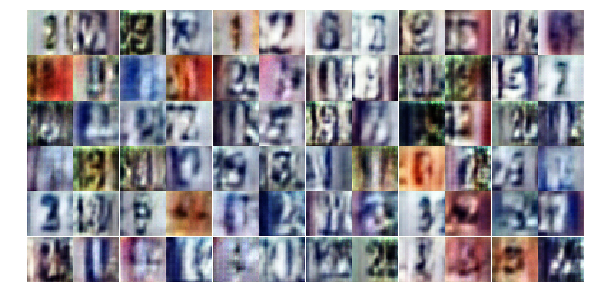

Epoch 5/25... Discriminator Loss: 0.3476... Generator Loss: 1.7265
Epoch 5/25... Discriminator Loss: 0.3801... Generator Loss: 2.0671
Epoch 5/25... Discriminator Loss: 1.4643... Generator Loss: 0.3736
Epoch 5/25... Discriminator Loss: 1.0739... Generator Loss: 0.9172
Epoch 5/25... Discriminator Loss: 0.6046... Generator Loss: 1.2607
Epoch 5/25... Discriminator Loss: 0.6902... Generator Loss: 1.0928
Epoch 5/25... Discriminator Loss: 0.9839... Generator Loss: 0.7112
Epoch 5/25... Discriminator Loss: 0.3933... Generator Loss: 1.8967
Epoch 5/25... Discriminator Loss: 0.3411... Generator Loss: 1.9543
Epoch 5/25... Discriminator Loss: 0.4878... Generator Loss: 1.3686


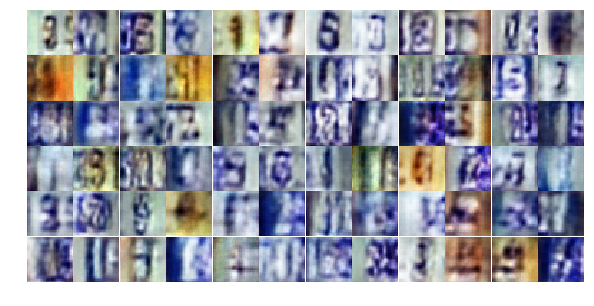

Epoch 5/25... Discriminator Loss: 1.5866... Generator Loss: 0.4055
Epoch 5/25... Discriminator Loss: 0.5528... Generator Loss: 1.7374
Epoch 5/25... Discriminator Loss: 0.8500... Generator Loss: 0.9391
Epoch 5/25... Discriminator Loss: 0.6161... Generator Loss: 1.2409
Epoch 5/25... Discriminator Loss: 0.6484... Generator Loss: 1.0345
Epoch 5/25... Discriminator Loss: 0.5930... Generator Loss: 1.1362
Epoch 6/25... Discriminator Loss: 0.7115... Generator Loss: 0.9033
Epoch 6/25... Discriminator Loss: 0.2254... Generator Loss: 2.4763
Epoch 6/25... Discriminator Loss: 0.4490... Generator Loss: 1.8900
Epoch 6/25... Discriminator Loss: 0.6648... Generator Loss: 1.4416


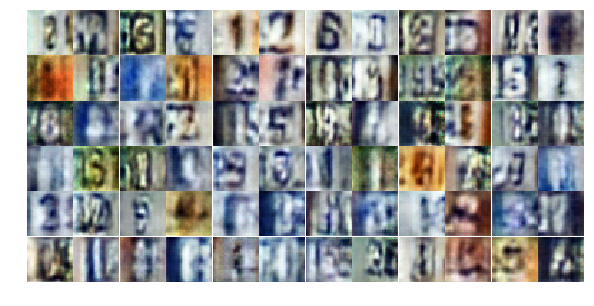

Epoch 6/25... Discriminator Loss: 0.4746... Generator Loss: 1.4941
Epoch 6/25... Discriminator Loss: 1.0971... Generator Loss: 0.6935
Epoch 6/25... Discriminator Loss: 0.5317... Generator Loss: 1.5001
Epoch 6/25... Discriminator Loss: 0.7421... Generator Loss: 1.5188
Epoch 6/25... Discriminator Loss: 0.8236... Generator Loss: 0.7629
Epoch 6/25... Discriminator Loss: 0.6443... Generator Loss: 0.9483
Epoch 6/25... Discriminator Loss: 0.4551... Generator Loss: 1.4268
Epoch 6/25... Discriminator Loss: 0.5340... Generator Loss: 1.7342
Epoch 6/25... Discriminator Loss: 0.4354... Generator Loss: 1.3904
Epoch 6/25... Discriminator Loss: 0.6553... Generator Loss: 1.5804


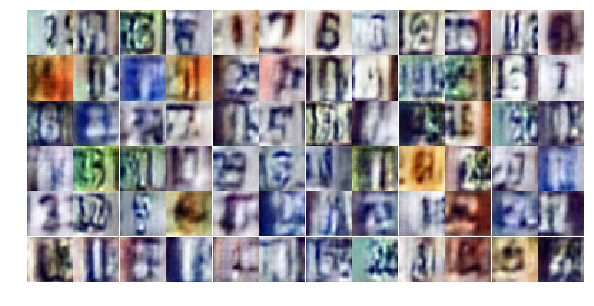

Epoch 6/25... Discriminator Loss: 0.7509... Generator Loss: 1.4819
Epoch 6/25... Discriminator Loss: 0.4978... Generator Loss: 1.8517
Epoch 6/25... Discriminator Loss: 0.6969... Generator Loss: 0.9587
Epoch 6/25... Discriminator Loss: 0.5218... Generator Loss: 1.2470
Epoch 6/25... Discriminator Loss: 0.2864... Generator Loss: 2.0340
Epoch 6/25... Discriminator Loss: 0.3965... Generator Loss: 2.1512
Epoch 6/25... Discriminator Loss: 0.3522... Generator Loss: 1.9165
Epoch 6/25... Discriminator Loss: 0.6933... Generator Loss: 1.2031
Epoch 6/25... Discriminator Loss: 0.6583... Generator Loss: 2.8649
Epoch 6/25... Discriminator Loss: 0.6277... Generator Loss: 1.0951


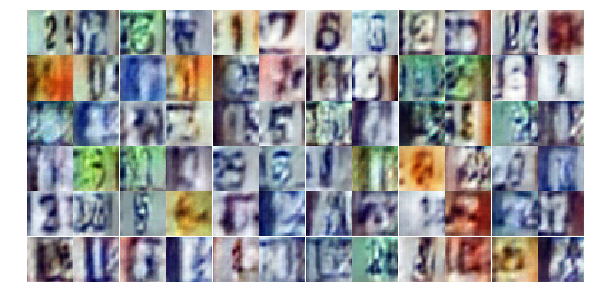

Epoch 6/25... Discriminator Loss: 0.8249... Generator Loss: 0.7698
Epoch 6/25... Discriminator Loss: 0.9469... Generator Loss: 0.6938
Epoch 6/25... Discriminator Loss: 0.6042... Generator Loss: 1.1197
Epoch 6/25... Discriminator Loss: 0.5246... Generator Loss: 1.2911
Epoch 6/25... Discriminator Loss: 0.8478... Generator Loss: 2.7876
Epoch 6/25... Discriminator Loss: 1.1505... Generator Loss: 0.6050
Epoch 6/25... Discriminator Loss: 0.5530... Generator Loss: 1.3910
Epoch 6/25... Discriminator Loss: 0.4015... Generator Loss: 2.6718
Epoch 6/25... Discriminator Loss: 0.8094... Generator Loss: 0.9897
Epoch 6/25... Discriminator Loss: 0.4192... Generator Loss: 1.8595


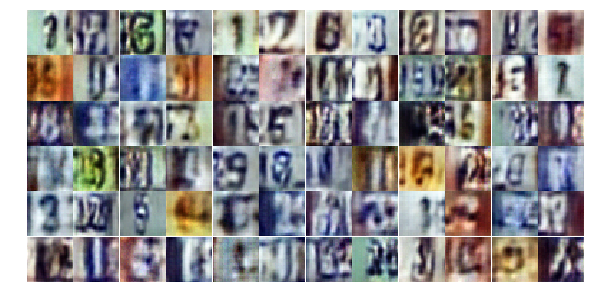

Epoch 6/25... Discriminator Loss: 0.8662... Generator Loss: 0.8292
Epoch 6/25... Discriminator Loss: 0.8807... Generator Loss: 0.7749
Epoch 6/25... Discriminator Loss: 0.8653... Generator Loss: 0.8074
Epoch 6/25... Discriminator Loss: 0.4035... Generator Loss: 1.4780
Epoch 6/25... Discriminator Loss: 0.8491... Generator Loss: 0.8769
Epoch 6/25... Discriminator Loss: 0.3940... Generator Loss: 1.9849
Epoch 6/25... Discriminator Loss: 0.3009... Generator Loss: 2.1036
Epoch 6/25... Discriminator Loss: 0.8492... Generator Loss: 3.2648
Epoch 6/25... Discriminator Loss: 0.8591... Generator Loss: 0.7705
Epoch 6/25... Discriminator Loss: 0.4946... Generator Loss: 1.2711


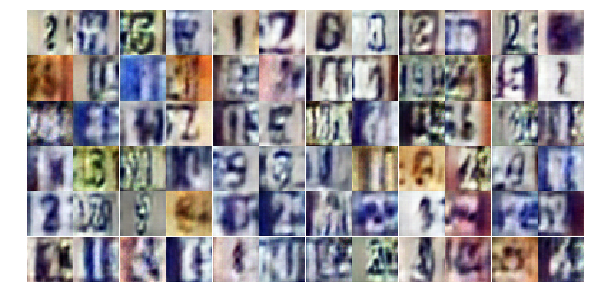

Epoch 6/25... Discriminator Loss: 0.5488... Generator Loss: 1.1912
Epoch 6/25... Discriminator Loss: 0.5256... Generator Loss: 2.2500
Epoch 6/25... Discriminator Loss: 0.6792... Generator Loss: 2.1660
Epoch 6/25... Discriminator Loss: 1.0445... Generator Loss: 0.7391
Epoch 6/25... Discriminator Loss: 0.8155... Generator Loss: 0.7643
Epoch 6/25... Discriminator Loss: 0.6273... Generator Loss: 1.0475
Epoch 6/25... Discriminator Loss: 0.9309... Generator Loss: 0.7210
Epoch 6/25... Discriminator Loss: 1.3063... Generator Loss: 0.3967
Epoch 6/25... Discriminator Loss: 0.9254... Generator Loss: 0.8139
Epoch 6/25... Discriminator Loss: 1.5122... Generator Loss: 0.3683


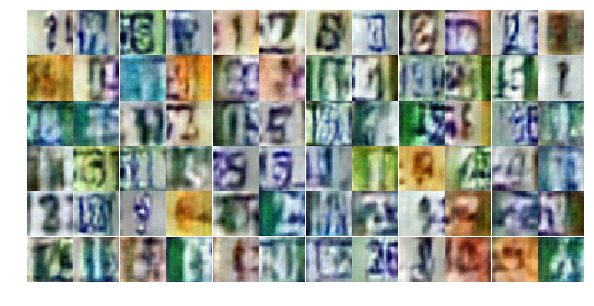

Epoch 6/25... Discriminator Loss: 0.6752... Generator Loss: 3.5360
Epoch 6/25... Discriminator Loss: 1.0369... Generator Loss: 0.6235
Epoch 6/25... Discriminator Loss: 1.1253... Generator Loss: 0.9686
Epoch 7/25... Discriminator Loss: 0.5491... Generator Loss: 1.2574
Epoch 7/25... Discriminator Loss: 0.5668... Generator Loss: 1.2831
Epoch 7/25... Discriminator Loss: 0.4432... Generator Loss: 1.6342
Epoch 7/25... Discriminator Loss: 0.6693... Generator Loss: 0.9607
Epoch 7/25... Discriminator Loss: 0.4312... Generator Loss: 2.2265
Epoch 7/25... Discriminator Loss: 0.3557... Generator Loss: 1.6591
Epoch 7/25... Discriminator Loss: 0.9739... Generator Loss: 0.6621


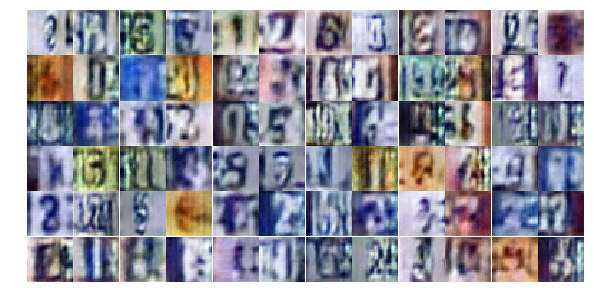

Epoch 7/25... Discriminator Loss: 0.4999... Generator Loss: 2.3829
Epoch 7/25... Discriminator Loss: 0.5772... Generator Loss: 1.0975
Epoch 7/25... Discriminator Loss: 1.8400... Generator Loss: 0.2336
Epoch 7/25... Discriminator Loss: 0.7976... Generator Loss: 1.2334
Epoch 7/25... Discriminator Loss: 0.7725... Generator Loss: 0.8188
Epoch 7/25... Discriminator Loss: 0.4609... Generator Loss: 1.3690
Epoch 7/25... Discriminator Loss: 0.8082... Generator Loss: 3.0280
Epoch 7/25... Discriminator Loss: 0.5231... Generator Loss: 1.7989
Epoch 7/25... Discriminator Loss: 1.1501... Generator Loss: 3.1385
Epoch 7/25... Discriminator Loss: 0.9025... Generator Loss: 0.7253


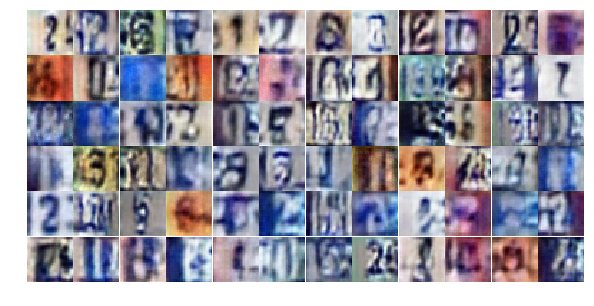

Epoch 7/25... Discriminator Loss: 0.6578... Generator Loss: 1.0823
Epoch 7/25... Discriminator Loss: 0.4739... Generator Loss: 1.6722
Epoch 7/25... Discriminator Loss: 0.5312... Generator Loss: 1.2323
Epoch 7/25... Discriminator Loss: 0.4910... Generator Loss: 1.6381
Epoch 7/25... Discriminator Loss: 0.4769... Generator Loss: 1.2850
Epoch 7/25... Discriminator Loss: 0.6082... Generator Loss: 2.9044
Epoch 7/25... Discriminator Loss: 0.4838... Generator Loss: 1.7975
Epoch 7/25... Discriminator Loss: 0.7025... Generator Loss: 1.2104
Epoch 7/25... Discriminator Loss: 0.4025... Generator Loss: 2.0411
Epoch 7/25... Discriminator Loss: 0.4297... Generator Loss: 1.7413


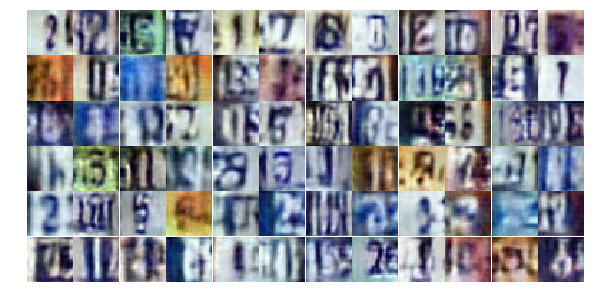

Epoch 7/25... Discriminator Loss: 0.5757... Generator Loss: 1.1782
Epoch 7/25... Discriminator Loss: 0.9072... Generator Loss: 0.7572
Epoch 7/25... Discriminator Loss: 0.5305... Generator Loss: 1.3185
Epoch 7/25... Discriminator Loss: 0.7354... Generator Loss: 0.9096
Epoch 7/25... Discriminator Loss: 0.7144... Generator Loss: 0.8717
Epoch 7/25... Discriminator Loss: 1.0139... Generator Loss: 0.6083
Epoch 7/25... Discriminator Loss: 0.3189... Generator Loss: 1.7970
Epoch 7/25... Discriminator Loss: 1.0918... Generator Loss: 2.6507
Epoch 7/25... Discriminator Loss: 1.6117... Generator Loss: 1.6195
Epoch 7/25... Discriminator Loss: 1.0141... Generator Loss: 2.4315


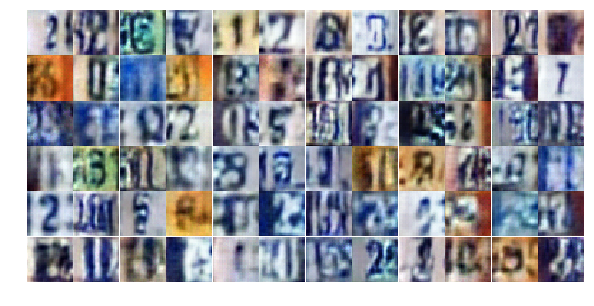

Epoch 7/25... Discriminator Loss: 0.9905... Generator Loss: 0.8562
Epoch 7/25... Discriminator Loss: 0.7693... Generator Loss: 0.9902
Epoch 7/25... Discriminator Loss: 0.3924... Generator Loss: 1.8591
Epoch 7/25... Discriminator Loss: 0.5530... Generator Loss: 1.2247
Epoch 7/25... Discriminator Loss: 0.7014... Generator Loss: 0.9460
Epoch 7/25... Discriminator Loss: 0.3338... Generator Loss: 1.9036
Epoch 7/25... Discriminator Loss: 0.4902... Generator Loss: 1.4839
Epoch 7/25... Discriminator Loss: 0.6821... Generator Loss: 0.9717
Epoch 7/25... Discriminator Loss: 0.2858... Generator Loss: 2.5230
Epoch 7/25... Discriminator Loss: 0.8877... Generator Loss: 1.5321


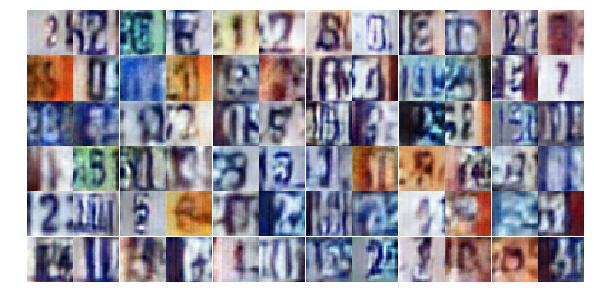

Epoch 7/25... Discriminator Loss: 0.3429... Generator Loss: 1.8807
Epoch 7/25... Discriminator Loss: 0.6082... Generator Loss: 1.0458
Epoch 7/25... Discriminator Loss: 0.6664... Generator Loss: 1.1423
Epoch 7/25... Discriminator Loss: 0.6723... Generator Loss: 1.0009
Epoch 7/25... Discriminator Loss: 0.9424... Generator Loss: 1.5000
Epoch 7/25... Discriminator Loss: 0.7617... Generator Loss: 1.9805
Epoch 7/25... Discriminator Loss: 1.5394... Generator Loss: 0.3216
Epoch 7/25... Discriminator Loss: 0.6530... Generator Loss: 1.3671
Epoch 7/25... Discriminator Loss: 0.9122... Generator Loss: 0.7160
Epoch 7/25... Discriminator Loss: 0.5955... Generator Loss: 1.0673


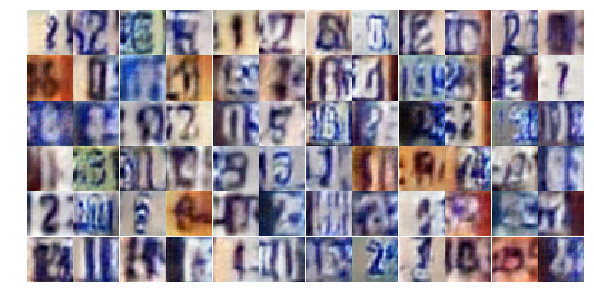

Epoch 7/25... Discriminator Loss: 1.0110... Generator Loss: 3.1202
Epoch 8/25... Discriminator Loss: 0.5264... Generator Loss: 1.6335
Epoch 8/25... Discriminator Loss: 0.6135... Generator Loss: 1.1068
Epoch 8/25... Discriminator Loss: 0.5781... Generator Loss: 1.3255
Epoch 8/25... Discriminator Loss: 0.4592... Generator Loss: 1.7117
Epoch 8/25... Discriminator Loss: 1.0315... Generator Loss: 0.5921
Epoch 8/25... Discriminator Loss: 0.8205... Generator Loss: 0.7938
Epoch 8/25... Discriminator Loss: 0.9172... Generator Loss: 3.2910
Epoch 8/25... Discriminator Loss: 0.6850... Generator Loss: 1.1630
Epoch 8/25... Discriminator Loss: 0.5859... Generator Loss: 1.1820


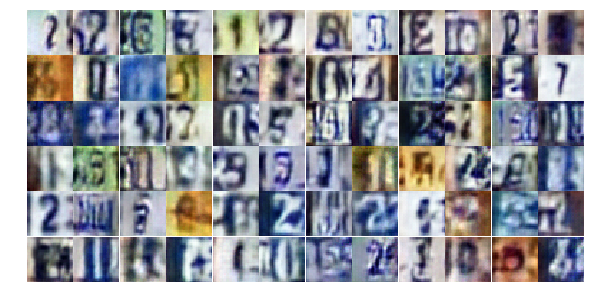

Epoch 8/25... Discriminator Loss: 0.3535... Generator Loss: 2.2095
Epoch 8/25... Discriminator Loss: 0.3997... Generator Loss: 1.6849
Epoch 8/25... Discriminator Loss: 0.6873... Generator Loss: 0.9589
Epoch 8/25... Discriminator Loss: 0.3199... Generator Loss: 2.0667
Epoch 8/25... Discriminator Loss: 0.9757... Generator Loss: 0.7032
Epoch 8/25... Discriminator Loss: 0.5096... Generator Loss: 2.3691
Epoch 8/25... Discriminator Loss: 0.4316... Generator Loss: 1.6681
Epoch 8/25... Discriminator Loss: 0.2699... Generator Loss: 2.4719
Epoch 8/25... Discriminator Loss: 0.4278... Generator Loss: 2.6037
Epoch 8/25... Discriminator Loss: 1.1713... Generator Loss: 0.6319


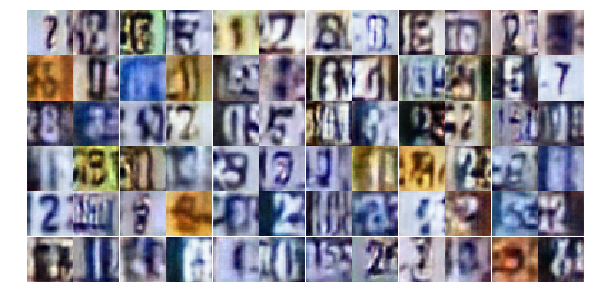

Epoch 8/25... Discriminator Loss: 0.3981... Generator Loss: 1.8227
Epoch 8/25... Discriminator Loss: 0.7612... Generator Loss: 0.8262
Epoch 8/25... Discriminator Loss: 0.5301... Generator Loss: 1.8530
Epoch 8/25... Discriminator Loss: 0.4872... Generator Loss: 1.7283
Epoch 8/25... Discriminator Loss: 0.3669... Generator Loss: 1.6997
Epoch 8/25... Discriminator Loss: 0.5405... Generator Loss: 2.0682
Epoch 8/25... Discriminator Loss: 0.6699... Generator Loss: 1.6446
Epoch 8/25... Discriminator Loss: 0.5390... Generator Loss: 2.6876
Epoch 8/25... Discriminator Loss: 0.7595... Generator Loss: 2.3337
Epoch 8/25... Discriminator Loss: 0.7014... Generator Loss: 1.6288


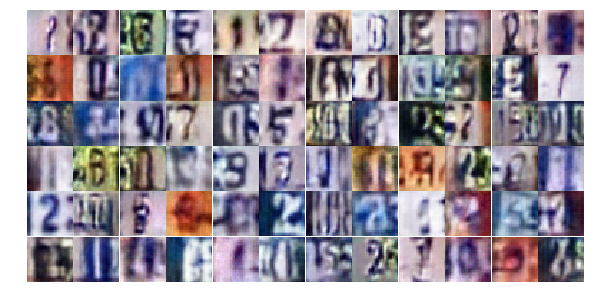

Epoch 8/25... Discriminator Loss: 0.6479... Generator Loss: 1.0873
Epoch 8/25... Discriminator Loss: 0.6529... Generator Loss: 1.0134
Epoch 8/25... Discriminator Loss: 0.4912... Generator Loss: 1.6219
Epoch 8/25... Discriminator Loss: 0.6377... Generator Loss: 1.5517
Epoch 8/25... Discriminator Loss: 0.9381... Generator Loss: 0.8754
Epoch 8/25... Discriminator Loss: 0.5218... Generator Loss: 1.3234
Epoch 8/25... Discriminator Loss: 0.4157... Generator Loss: 1.8562
Epoch 8/25... Discriminator Loss: 0.4819... Generator Loss: 1.5652
Epoch 8/25... Discriminator Loss: 0.5965... Generator Loss: 1.2785
Epoch 8/25... Discriminator Loss: 0.3514... Generator Loss: 1.8874


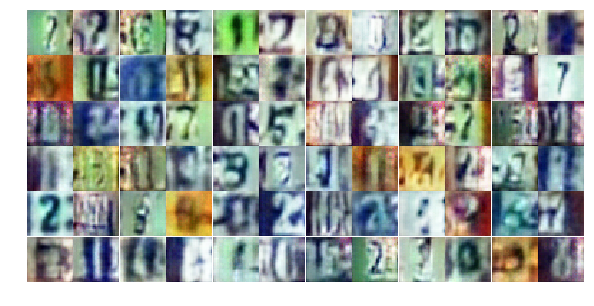

Epoch 8/25... Discriminator Loss: 0.4071... Generator Loss: 2.5641
Epoch 8/25... Discriminator Loss: 1.0268... Generator Loss: 0.6764
Epoch 8/25... Discriminator Loss: 0.2650... Generator Loss: 2.0150
Epoch 8/25... Discriminator Loss: 0.3455... Generator Loss: 1.9803
Epoch 8/25... Discriminator Loss: 1.9445... Generator Loss: 4.7536
Epoch 8/25... Discriminator Loss: 0.7480... Generator Loss: 1.0003
Epoch 8/25... Discriminator Loss: 0.2905... Generator Loss: 2.2411
Epoch 8/25... Discriminator Loss: 1.3064... Generator Loss: 0.4228
Epoch 8/25... Discriminator Loss: 0.5483... Generator Loss: 1.2797
Epoch 8/25... Discriminator Loss: 0.6290... Generator Loss: 1.2157


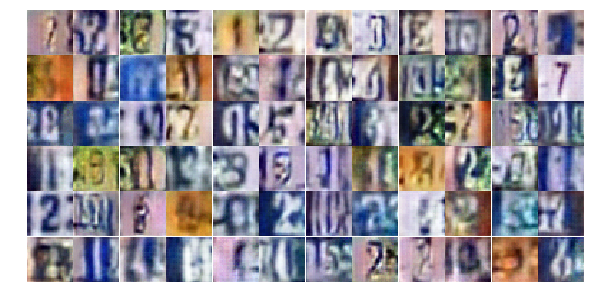

Epoch 8/25... Discriminator Loss: 0.5803... Generator Loss: 1.1102
Epoch 8/25... Discriminator Loss: 0.3902... Generator Loss: 2.0067
Epoch 8/25... Discriminator Loss: 0.2875... Generator Loss: 1.9173
Epoch 8/25... Discriminator Loss: 0.9006... Generator Loss: 0.6712
Epoch 8/25... Discriminator Loss: 0.2671... Generator Loss: 2.5107
Epoch 8/25... Discriminator Loss: 0.7564... Generator Loss: 1.8393
Epoch 8/25... Discriminator Loss: 0.7745... Generator Loss: 0.8319
Epoch 8/25... Discriminator Loss: 0.6912... Generator Loss: 3.3201
Epoch 9/25... Discriminator Loss: 1.1480... Generator Loss: 0.5210
Epoch 9/25... Discriminator Loss: 0.6623... Generator Loss: 1.0094


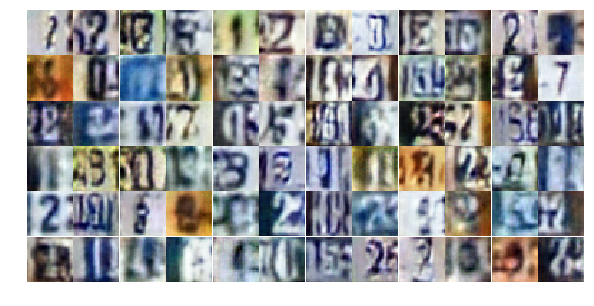

Epoch 9/25... Discriminator Loss: 0.5371... Generator Loss: 1.1885
Epoch 9/25... Discriminator Loss: 0.4047... Generator Loss: 2.2193
Epoch 9/25... Discriminator Loss: 0.7709... Generator Loss: 0.8280
Epoch 9/25... Discriminator Loss: 0.4451... Generator Loss: 1.5341
Epoch 9/25... Discriminator Loss: 0.7334... Generator Loss: 0.9173
Epoch 9/25... Discriminator Loss: 0.4524... Generator Loss: 2.5335
Epoch 9/25... Discriminator Loss: 0.5836... Generator Loss: 1.3207
Epoch 9/25... Discriminator Loss: 0.5529... Generator Loss: 1.2941
Epoch 9/25... Discriminator Loss: 0.5076... Generator Loss: 1.2337
Epoch 9/25... Discriminator Loss: 0.4623... Generator Loss: 1.4382


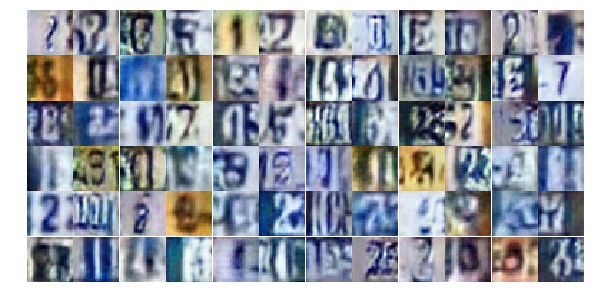

Epoch 9/25... Discriminator Loss: 0.8383... Generator Loss: 0.7472
Epoch 9/25... Discriminator Loss: 0.5345... Generator Loss: 1.3209
Epoch 9/25... Discriminator Loss: 0.3609... Generator Loss: 1.8003
Epoch 9/25... Discriminator Loss: 1.2143... Generator Loss: 0.4888
Epoch 9/25... Discriminator Loss: 0.7165... Generator Loss: 2.7290
Epoch 9/25... Discriminator Loss: 1.1205... Generator Loss: 0.7602
Epoch 9/25... Discriminator Loss: 0.8275... Generator Loss: 0.8779
Epoch 9/25... Discriminator Loss: 0.4157... Generator Loss: 1.7679
Epoch 9/25... Discriminator Loss: 1.0753... Generator Loss: 0.5608
Epoch 9/25... Discriminator Loss: 0.7239... Generator Loss: 1.0189


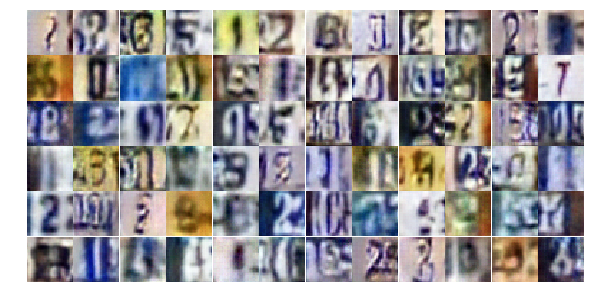

Epoch 9/25... Discriminator Loss: 0.8485... Generator Loss: 1.0660
Epoch 9/25... Discriminator Loss: 0.5423... Generator Loss: 1.4908
Epoch 9/25... Discriminator Loss: 0.3934... Generator Loss: 2.3107
Epoch 9/25... Discriminator Loss: 0.5759... Generator Loss: 1.5883
Epoch 9/25... Discriminator Loss: 1.0780... Generator Loss: 3.1009
Epoch 9/25... Discriminator Loss: 0.4943... Generator Loss: 1.6312
Epoch 9/25... Discriminator Loss: 0.9900... Generator Loss: 0.6764
Epoch 9/25... Discriminator Loss: 1.0975... Generator Loss: 3.4089
Epoch 9/25... Discriminator Loss: 0.5741... Generator Loss: 1.2559
Epoch 9/25... Discriminator Loss: 0.5567... Generator Loss: 1.0800


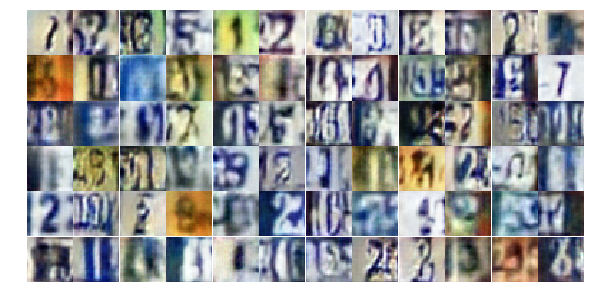

Epoch 9/25... Discriminator Loss: 0.4322... Generator Loss: 1.4826
Epoch 9/25... Discriminator Loss: 0.5895... Generator Loss: 1.1462
Epoch 9/25... Discriminator Loss: 1.0409... Generator Loss: 0.5633
Epoch 9/25... Discriminator Loss: 0.7927... Generator Loss: 0.9311
Epoch 9/25... Discriminator Loss: 0.5181... Generator Loss: 1.3990
Epoch 9/25... Discriminator Loss: 0.6202... Generator Loss: 2.2067
Epoch 9/25... Discriminator Loss: 0.5340... Generator Loss: 1.5926
Epoch 9/25... Discriminator Loss: 0.3416... Generator Loss: 2.2559
Epoch 9/25... Discriminator Loss: 1.0227... Generator Loss: 0.5917
Epoch 9/25... Discriminator Loss: 0.6358... Generator Loss: 1.0664


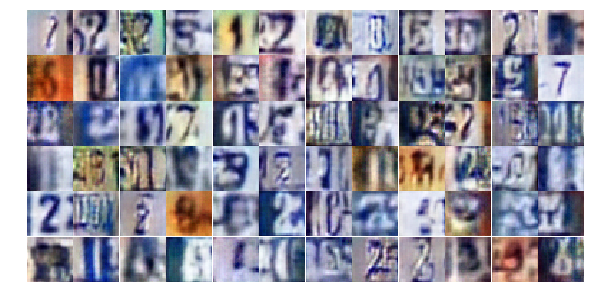

Epoch 9/25... Discriminator Loss: 0.4618... Generator Loss: 1.5158
Epoch 9/25... Discriminator Loss: 0.3583... Generator Loss: 1.7691
Epoch 9/25... Discriminator Loss: 2.3137... Generator Loss: 0.2282
Epoch 9/25... Discriminator Loss: 0.7484... Generator Loss: 1.3332
Epoch 9/25... Discriminator Loss: 0.5295... Generator Loss: 1.3976
Epoch 9/25... Discriminator Loss: 0.6147... Generator Loss: 1.1472
Epoch 9/25... Discriminator Loss: 0.6209... Generator Loss: 1.8804
Epoch 9/25... Discriminator Loss: 0.6821... Generator Loss: 1.1750
Epoch 9/25... Discriminator Loss: 0.7310... Generator Loss: 0.9125
Epoch 9/25... Discriminator Loss: 0.6672... Generator Loss: 2.0547


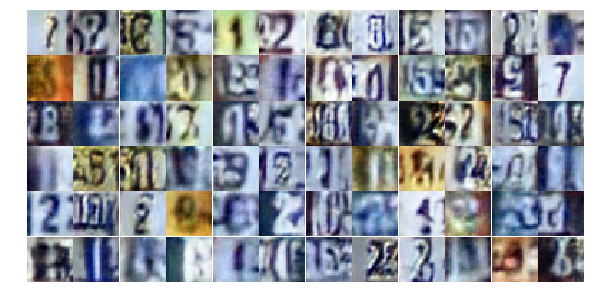

Epoch 9/25... Discriminator Loss: 0.8965... Generator Loss: 0.8470
Epoch 9/25... Discriminator Loss: 0.5850... Generator Loss: 2.9570
Epoch 9/25... Discriminator Loss: 0.5238... Generator Loss: 1.4224
Epoch 9/25... Discriminator Loss: 1.5448... Generator Loss: 0.3131
Epoch 9/25... Discriminator Loss: 0.8257... Generator Loss: 0.8522
Epoch 10/25... Discriminator Loss: 0.6114... Generator Loss: 1.0422
Epoch 10/25... Discriminator Loss: 0.5602... Generator Loss: 1.4028
Epoch 10/25... Discriminator Loss: 0.6914... Generator Loss: 0.9754
Epoch 10/25... Discriminator Loss: 0.8758... Generator Loss: 0.7462
Epoch 10/25... Discriminator Loss: 1.0689... Generator Loss: 0.5748


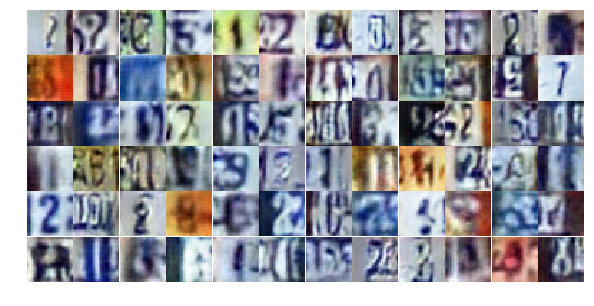

Epoch 10/25... Discriminator Loss: 0.5170... Generator Loss: 1.7162
Epoch 10/25... Discriminator Loss: 0.6555... Generator Loss: 1.0942
Epoch 10/25... Discriminator Loss: 0.5619... Generator Loss: 1.1836
Epoch 10/25... Discriminator Loss: 0.7335... Generator Loss: 1.0831
Epoch 10/25... Discriminator Loss: 0.4534... Generator Loss: 1.7397
Epoch 10/25... Discriminator Loss: 0.5449... Generator Loss: 1.2442
Epoch 10/25... Discriminator Loss: 0.5127... Generator Loss: 1.2683
Epoch 10/25... Discriminator Loss: 0.8044... Generator Loss: 0.8514
Epoch 10/25... Discriminator Loss: 1.8560... Generator Loss: 0.2795
Epoch 10/25... Discriminator Loss: 0.9342... Generator Loss: 0.8171


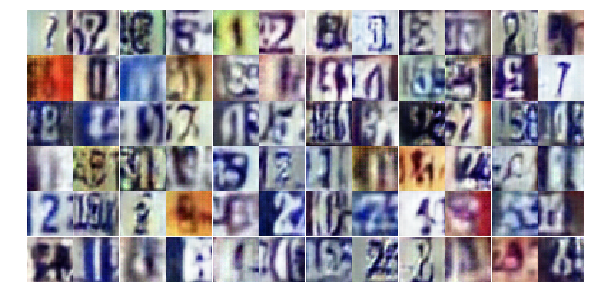

Epoch 10/25... Discriminator Loss: 0.5096... Generator Loss: 1.7451
Epoch 10/25... Discriminator Loss: 0.8015... Generator Loss: 0.8366
Epoch 10/25... Discriminator Loss: 0.6414... Generator Loss: 1.0416
Epoch 10/25... Discriminator Loss: 1.0679... Generator Loss: 0.5818
Epoch 10/25... Discriminator Loss: 0.4599... Generator Loss: 1.5058
Epoch 10/25... Discriminator Loss: 0.8576... Generator Loss: 0.7320
Epoch 10/25... Discriminator Loss: 0.8280... Generator Loss: 0.8188
Epoch 10/25... Discriminator Loss: 0.4441... Generator Loss: 1.5144
Epoch 10/25... Discriminator Loss: 0.5015... Generator Loss: 1.4100
Epoch 10/25... Discriminator Loss: 0.2915... Generator Loss: 3.2316


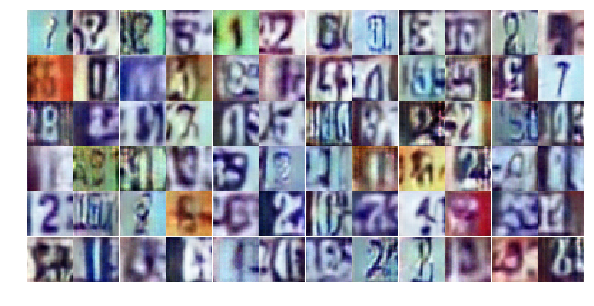

Epoch 10/25... Discriminator Loss: 0.9718... Generator Loss: 0.6217
Epoch 10/25... Discriminator Loss: 0.6115... Generator Loss: 1.0854
Epoch 10/25... Discriminator Loss: 0.4697... Generator Loss: 1.2696
Epoch 10/25... Discriminator Loss: 0.5155... Generator Loss: 2.6603
Epoch 10/25... Discriminator Loss: 0.9939... Generator Loss: 0.6292
Epoch 10/25... Discriminator Loss: 0.3945... Generator Loss: 1.9771
Epoch 10/25... Discriminator Loss: 0.4402... Generator Loss: 2.1409
Epoch 10/25... Discriminator Loss: 0.6508... Generator Loss: 1.0102
Epoch 10/25... Discriminator Loss: 0.7969... Generator Loss: 0.8255
Epoch 10/25... Discriminator Loss: 0.7935... Generator Loss: 0.7850


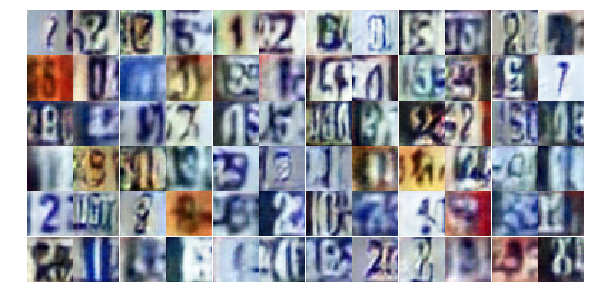

Epoch 10/25... Discriminator Loss: 1.0973... Generator Loss: 3.2993
Epoch 10/25... Discriminator Loss: 0.8544... Generator Loss: 0.7572
Epoch 10/25... Discriminator Loss: 0.5180... Generator Loss: 1.2924
Epoch 10/25... Discriminator Loss: 0.5719... Generator Loss: 1.5054
Epoch 10/25... Discriminator Loss: 0.7364... Generator Loss: 0.9791
Epoch 10/25... Discriminator Loss: 0.5795... Generator Loss: 1.4110
Epoch 10/25... Discriminator Loss: 0.5658... Generator Loss: 1.2023
Epoch 10/25... Discriminator Loss: 0.5914... Generator Loss: 1.1521
Epoch 10/25... Discriminator Loss: 0.5320... Generator Loss: 1.4659
Epoch 10/25... Discriminator Loss: 0.5154... Generator Loss: 2.2193


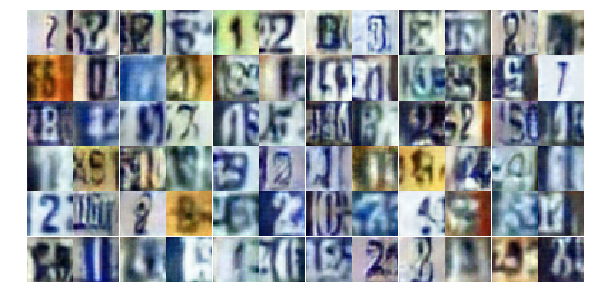

Epoch 10/25... Discriminator Loss: 1.2875... Generator Loss: 0.4794
Epoch 10/25... Discriminator Loss: 0.7306... Generator Loss: 1.3965
Epoch 10/25... Discriminator Loss: 0.5500... Generator Loss: 1.4791
Epoch 10/25... Discriminator Loss: 1.3577... Generator Loss: 0.4188
Epoch 10/25... Discriminator Loss: 0.4939... Generator Loss: 1.6578
Epoch 10/25... Discriminator Loss: 0.4602... Generator Loss: 1.9357
Epoch 10/25... Discriminator Loss: 0.5463... Generator Loss: 1.3210
Epoch 10/25... Discriminator Loss: 0.3184... Generator Loss: 1.9136
Epoch 10/25... Discriminator Loss: 0.7411... Generator Loss: 2.5907
Epoch 10/25... Discriminator Loss: 0.7174... Generator Loss: 0.9288


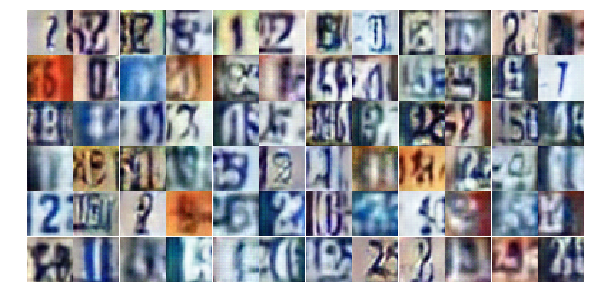

Epoch 10/25... Discriminator Loss: 0.6062... Generator Loss: 1.4532
Epoch 10/25... Discriminator Loss: 0.4418... Generator Loss: 1.4618
Epoch 10/25... Discriminator Loss: 0.4821... Generator Loss: 1.2493
Epoch 11/25... Discriminator Loss: 1.1975... Generator Loss: 0.4957
Epoch 11/25... Discriminator Loss: 0.4693... Generator Loss: 1.3690
Epoch 11/25... Discriminator Loss: 1.1325... Generator Loss: 0.5266
Epoch 11/25... Discriminator Loss: 0.6790... Generator Loss: 1.1431
Epoch 11/25... Discriminator Loss: 0.6186... Generator Loss: 1.4622
Epoch 11/25... Discriminator Loss: 1.9243... Generator Loss: 0.2280
Epoch 11/25... Discriminator Loss: 1.1280... Generator Loss: 0.6130


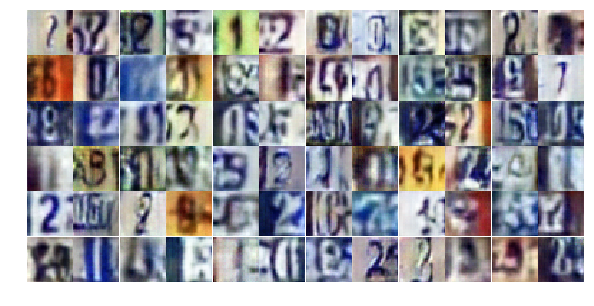

Epoch 11/25... Discriminator Loss: 0.5698... Generator Loss: 1.3607
Epoch 11/25... Discriminator Loss: 0.5586... Generator Loss: 1.4034
Epoch 11/25... Discriminator Loss: 0.4919... Generator Loss: 1.3768
Epoch 11/25... Discriminator Loss: 0.4425... Generator Loss: 1.7818
Epoch 11/25... Discriminator Loss: 0.7294... Generator Loss: 1.6732
Epoch 11/25... Discriminator Loss: 0.3981... Generator Loss: 1.8577
Epoch 11/25... Discriminator Loss: 0.4951... Generator Loss: 1.5991
Epoch 11/25... Discriminator Loss: 0.3534... Generator Loss: 2.4683
Epoch 11/25... Discriminator Loss: 0.4461... Generator Loss: 1.6152
Epoch 11/25... Discriminator Loss: 1.2378... Generator Loss: 0.5017


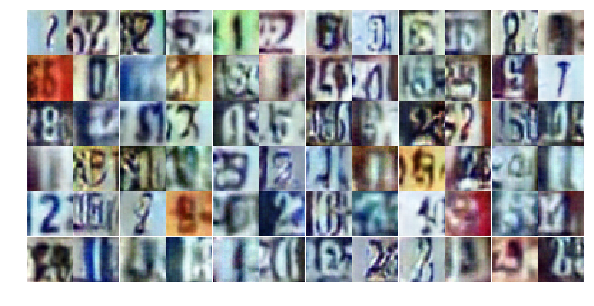

Epoch 11/25... Discriminator Loss: 0.8231... Generator Loss: 0.7722
Epoch 11/25... Discriminator Loss: 0.4520... Generator Loss: 2.4502
Epoch 11/25... Discriminator Loss: 0.8928... Generator Loss: 0.7068
Epoch 11/25... Discriminator Loss: 0.6112... Generator Loss: 1.0739
Epoch 11/25... Discriminator Loss: 0.4942... Generator Loss: 1.3633
Epoch 11/25... Discriminator Loss: 0.3442... Generator Loss: 2.0595
Epoch 11/25... Discriminator Loss: 0.4658... Generator Loss: 1.3944
Epoch 11/25... Discriminator Loss: 0.9273... Generator Loss: 0.7194
Epoch 11/25... Discriminator Loss: 0.3693... Generator Loss: 1.6046
Epoch 11/25... Discriminator Loss: 0.7412... Generator Loss: 0.8634


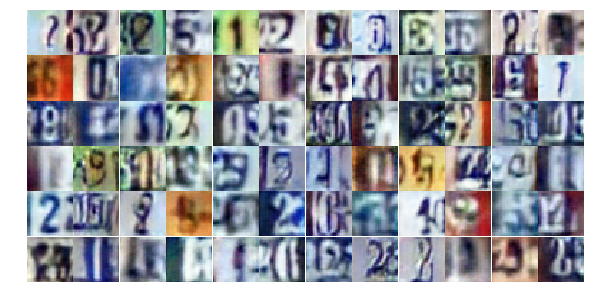

Epoch 11/25... Discriminator Loss: 1.0604... Generator Loss: 0.5983
Epoch 11/25... Discriminator Loss: 0.5460... Generator Loss: 1.2094
Epoch 11/25... Discriminator Loss: 0.9479... Generator Loss: 0.7827
Epoch 11/25... Discriminator Loss: 0.5935... Generator Loss: 2.8897
Epoch 11/25... Discriminator Loss: 0.5647... Generator Loss: 1.2483
Epoch 11/25... Discriminator Loss: 1.2854... Generator Loss: 0.4618
Epoch 11/25... Discriminator Loss: 1.2476... Generator Loss: 0.5232
Epoch 11/25... Discriminator Loss: 1.1101... Generator Loss: 0.5315
Epoch 11/25... Discriminator Loss: 0.5503... Generator Loss: 1.2317
Epoch 11/25... Discriminator Loss: 0.9671... Generator Loss: 0.7600


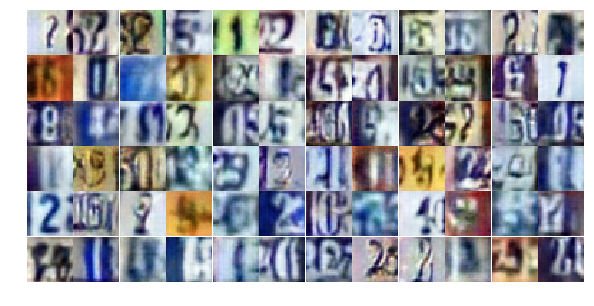

Epoch 11/25... Discriminator Loss: 0.4699... Generator Loss: 1.3758
Epoch 11/25... Discriminator Loss: 0.4380... Generator Loss: 1.4563
Epoch 11/25... Discriminator Loss: 0.7627... Generator Loss: 0.9250
Epoch 11/25... Discriminator Loss: 0.5731... Generator Loss: 2.7729
Epoch 11/25... Discriminator Loss: 0.5763... Generator Loss: 1.2284
Epoch 11/25... Discriminator Loss: 0.4436... Generator Loss: 1.9108
Epoch 11/25... Discriminator Loss: 0.3238... Generator Loss: 1.8293
Epoch 11/25... Discriminator Loss: 0.4483... Generator Loss: 1.5459
Epoch 11/25... Discriminator Loss: 1.1167... Generator Loss: 0.5470
Epoch 11/25... Discriminator Loss: 0.5091... Generator Loss: 1.3241


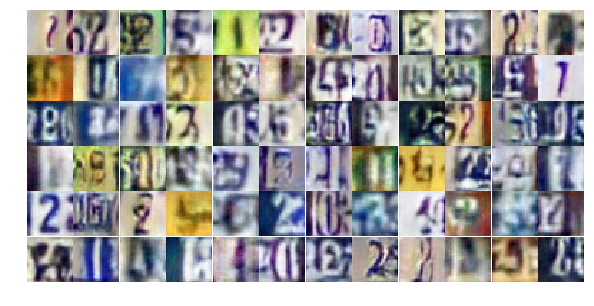

Epoch 11/25... Discriminator Loss: 1.0952... Generator Loss: 0.6174
Epoch 11/25... Discriminator Loss: 0.3482... Generator Loss: 1.8649
Epoch 11/25... Discriminator Loss: 0.7658... Generator Loss: 1.1377
Epoch 11/25... Discriminator Loss: 0.7360... Generator Loss: 0.8974
Epoch 11/25... Discriminator Loss: 0.8671... Generator Loss: 0.7873
Epoch 11/25... Discriminator Loss: 0.7228... Generator Loss: 0.9773
Epoch 11/25... Discriminator Loss: 0.9242... Generator Loss: 0.7570
Epoch 11/25... Discriminator Loss: 0.3252... Generator Loss: 2.0044
Epoch 11/25... Discriminator Loss: 1.6987... Generator Loss: 0.3250
Epoch 11/25... Discriminator Loss: 1.3647... Generator Loss: 0.5054


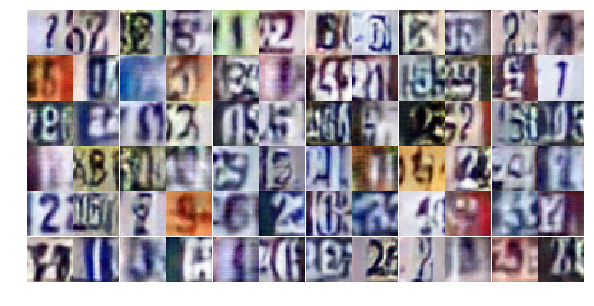

Epoch 12/25... Discriminator Loss: 0.7353... Generator Loss: 2.0249
Epoch 12/25... Discriminator Loss: 0.7368... Generator Loss: 1.0739
Epoch 12/25... Discriminator Loss: 1.1095... Generator Loss: 0.5459
Epoch 12/25... Discriminator Loss: 0.4872... Generator Loss: 1.5670
Epoch 12/25... Discriminator Loss: 0.3619... Generator Loss: 1.8798
Epoch 12/25... Discriminator Loss: 0.5072... Generator Loss: 1.2916
Epoch 12/25... Discriminator Loss: 0.5795... Generator Loss: 1.1252
Epoch 12/25... Discriminator Loss: 0.5818... Generator Loss: 1.7137
Epoch 12/25... Discriminator Loss: 0.6834... Generator Loss: 1.1125
Epoch 12/25... Discriminator Loss: 0.9583... Generator Loss: 0.7495


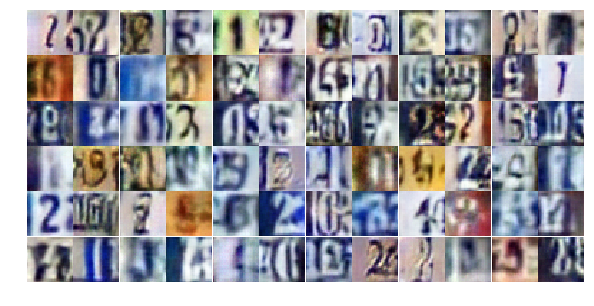

Epoch 12/25... Discriminator Loss: 0.4061... Generator Loss: 1.7806
Epoch 12/25... Discriminator Loss: 0.7216... Generator Loss: 1.0268
Epoch 12/25... Discriminator Loss: 0.5354... Generator Loss: 1.2568
Epoch 12/25... Discriminator Loss: 0.3871... Generator Loss: 2.0295
Epoch 12/25... Discriminator Loss: 0.3677... Generator Loss: 2.1090
Epoch 12/25... Discriminator Loss: 1.4226... Generator Loss: 0.3888
Epoch 12/25... Discriminator Loss: 1.5919... Generator Loss: 0.3091
Epoch 12/25... Discriminator Loss: 0.4327... Generator Loss: 1.8881
Epoch 12/25... Discriminator Loss: 0.4534... Generator Loss: 1.6434
Epoch 12/25... Discriminator Loss: 0.9387... Generator Loss: 0.6735


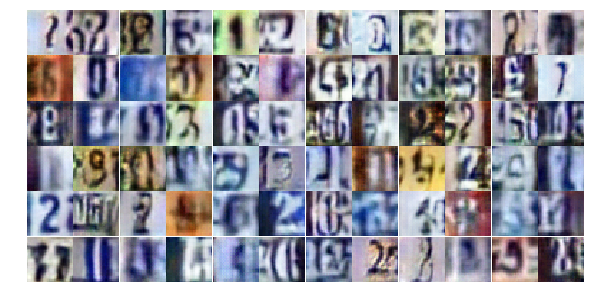

Epoch 12/25... Discriminator Loss: 0.4080... Generator Loss: 1.9958
Epoch 12/25... Discriminator Loss: 0.3434... Generator Loss: 1.5991
Epoch 12/25... Discriminator Loss: 0.5801... Generator Loss: 1.1577
Epoch 12/25... Discriminator Loss: 0.5154... Generator Loss: 1.5448
Epoch 12/25... Discriminator Loss: 0.3379... Generator Loss: 1.9174
Epoch 12/25... Discriminator Loss: 0.4894... Generator Loss: 1.3849
Epoch 12/25... Discriminator Loss: 0.6529... Generator Loss: 1.0159
Epoch 12/25... Discriminator Loss: 0.3537... Generator Loss: 1.8276
Epoch 12/25... Discriminator Loss: 0.6614... Generator Loss: 0.9593
Epoch 12/25... Discriminator Loss: 0.6994... Generator Loss: 0.9592


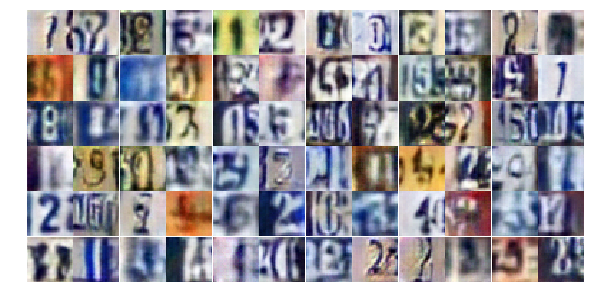

Epoch 12/25... Discriminator Loss: 0.5103... Generator Loss: 1.3444
Epoch 12/25... Discriminator Loss: 0.6027... Generator Loss: 1.1870
Epoch 12/25... Discriminator Loss: 0.7973... Generator Loss: 0.8018
Epoch 12/25... Discriminator Loss: 1.8053... Generator Loss: 0.2520
Epoch 12/25... Discriminator Loss: 0.4464... Generator Loss: 1.9215
Epoch 12/25... Discriminator Loss: 0.6194... Generator Loss: 1.1839
Epoch 12/25... Discriminator Loss: 1.0052... Generator Loss: 0.6488
Epoch 12/25... Discriminator Loss: 0.7594... Generator Loss: 1.0226
Epoch 12/25... Discriminator Loss: 0.4178... Generator Loss: 1.6762
Epoch 12/25... Discriminator Loss: 0.3263... Generator Loss: 1.6432


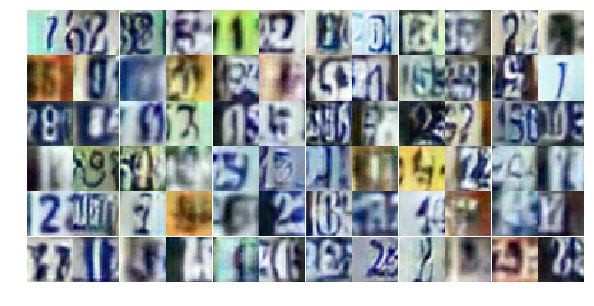

Epoch 12/25... Discriminator Loss: 0.4366... Generator Loss: 1.5287
Epoch 12/25... Discriminator Loss: 0.3639... Generator Loss: 1.6028
Epoch 12/25... Discriminator Loss: 0.4761... Generator Loss: 1.2257
Epoch 12/25... Discriminator Loss: 0.7519... Generator Loss: 0.9456
Epoch 12/25... Discriminator Loss: 2.2613... Generator Loss: 0.2620
Epoch 12/25... Discriminator Loss: 1.6435... Generator Loss: 0.3757
Epoch 12/25... Discriminator Loss: 0.6319... Generator Loss: 1.2572
Epoch 12/25... Discriminator Loss: 0.7861... Generator Loss: 0.8934
Epoch 12/25... Discriminator Loss: 0.4737... Generator Loss: 1.7732
Epoch 12/25... Discriminator Loss: 0.7029... Generator Loss: 1.0071


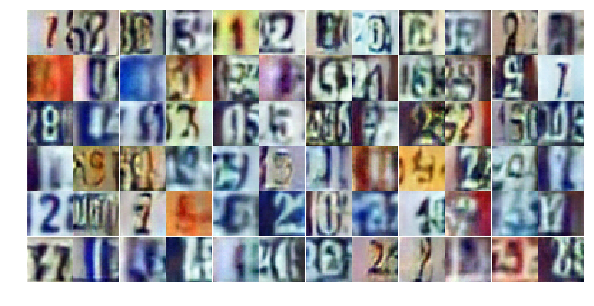

Epoch 12/25... Discriminator Loss: 0.8384... Generator Loss: 0.9633
Epoch 12/25... Discriminator Loss: 0.6582... Generator Loss: 1.1997
Epoch 12/25... Discriminator Loss: 0.9556... Generator Loss: 1.0031
Epoch 12/25... Discriminator Loss: 0.7949... Generator Loss: 1.0477
Epoch 12/25... Discriminator Loss: 0.5698... Generator Loss: 1.2406
Epoch 12/25... Discriminator Loss: 0.5527... Generator Loss: 1.6024
Epoch 12/25... Discriminator Loss: 1.0473... Generator Loss: 0.6063
Epoch 13/25... Discriminator Loss: 0.6338... Generator Loss: 1.0138
Epoch 13/25... Discriminator Loss: 0.5495... Generator Loss: 1.1600
Epoch 13/25... Discriminator Loss: 1.1793... Generator Loss: 0.4992


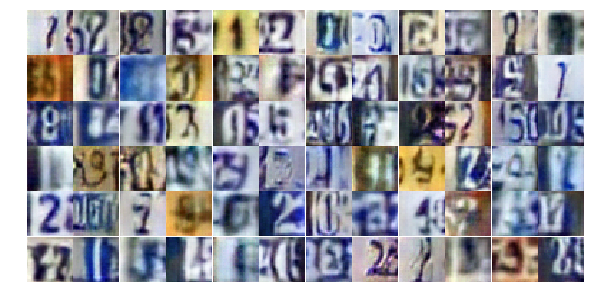

Epoch 13/25... Discriminator Loss: 0.5073... Generator Loss: 1.5006
Epoch 13/25... Discriminator Loss: 0.5940... Generator Loss: 1.2837
Epoch 13/25... Discriminator Loss: 1.0338... Generator Loss: 0.6687
Epoch 13/25... Discriminator Loss: 1.0893... Generator Loss: 0.5951
Epoch 13/25... Discriminator Loss: 0.6131... Generator Loss: 1.1847
Epoch 13/25... Discriminator Loss: 0.6353... Generator Loss: 1.0273
Epoch 13/25... Discriminator Loss: 0.3125... Generator Loss: 2.1703
Epoch 13/25... Discriminator Loss: 0.7482... Generator Loss: 0.8694
Epoch 13/25... Discriminator Loss: 0.5289... Generator Loss: 1.1845
Epoch 13/25... Discriminator Loss: 0.3309... Generator Loss: 2.5165


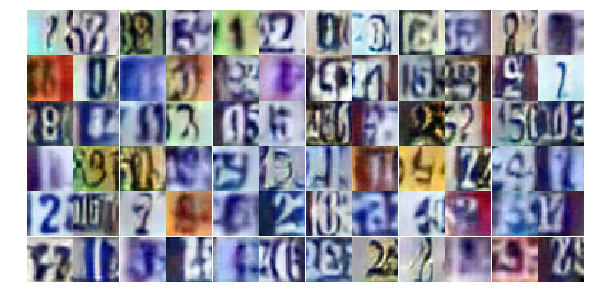

Epoch 13/25... Discriminator Loss: 1.1690... Generator Loss: 3.2243
Epoch 13/25... Discriminator Loss: 0.4690... Generator Loss: 1.5653
Epoch 13/25... Discriminator Loss: 0.8389... Generator Loss: 0.9013
Epoch 13/25... Discriminator Loss: 0.6039... Generator Loss: 1.0924
Epoch 13/25... Discriminator Loss: 0.4502... Generator Loss: 1.9124
Epoch 13/25... Discriminator Loss: 0.7851... Generator Loss: 0.9788
Epoch 13/25... Discriminator Loss: 0.6333... Generator Loss: 1.0838
Epoch 13/25... Discriminator Loss: 1.2095... Generator Loss: 0.5412
Epoch 13/25... Discriminator Loss: 0.4565... Generator Loss: 1.4177
Epoch 13/25... Discriminator Loss: 0.9976... Generator Loss: 0.6292


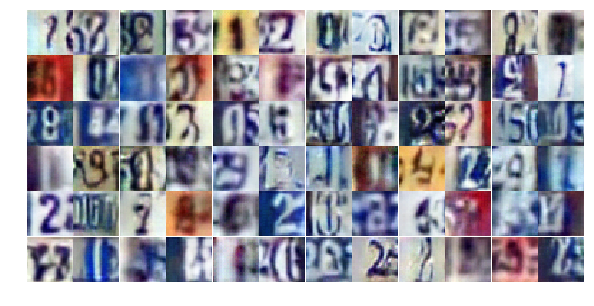

Epoch 13/25... Discriminator Loss: 0.7369... Generator Loss: 0.8909
Epoch 13/25... Discriminator Loss: 0.4761... Generator Loss: 1.5153
Epoch 13/25... Discriminator Loss: 0.3730... Generator Loss: 2.3168
Epoch 13/25... Discriminator Loss: 0.6114... Generator Loss: 1.2002
Epoch 13/25... Discriminator Loss: 0.6746... Generator Loss: 1.0833
Epoch 13/25... Discriminator Loss: 1.2439... Generator Loss: 0.4694
Epoch 13/25... Discriminator Loss: 0.6736... Generator Loss: 1.9018
Epoch 13/25... Discriminator Loss: 0.3749... Generator Loss: 1.7623
Epoch 13/25... Discriminator Loss: 0.5641... Generator Loss: 1.1558
Epoch 13/25... Discriminator Loss: 0.5233... Generator Loss: 1.3935


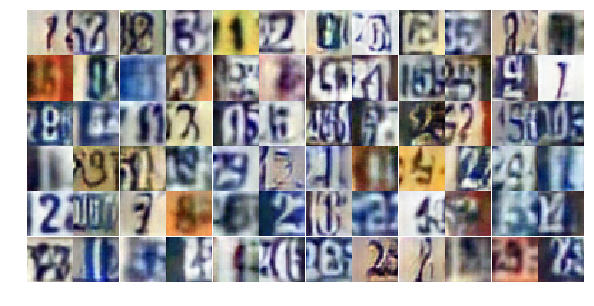

Epoch 13/25... Discriminator Loss: 1.4045... Generator Loss: 0.3758
Epoch 13/25... Discriminator Loss: 2.3323... Generator Loss: 1.7023
Epoch 13/25... Discriminator Loss: 1.5463... Generator Loss: 0.6316
Epoch 13/25... Discriminator Loss: 1.0267... Generator Loss: 0.8942
Epoch 13/25... Discriminator Loss: 0.6904... Generator Loss: 1.1735
Epoch 13/25... Discriminator Loss: 0.5518... Generator Loss: 1.3144
Epoch 13/25... Discriminator Loss: 0.6971... Generator Loss: 0.9634
Epoch 13/25... Discriminator Loss: 0.8469... Generator Loss: 0.8377
Epoch 13/25... Discriminator Loss: 0.8506... Generator Loss: 0.7932
Epoch 13/25... Discriminator Loss: 0.8843... Generator Loss: 0.7691


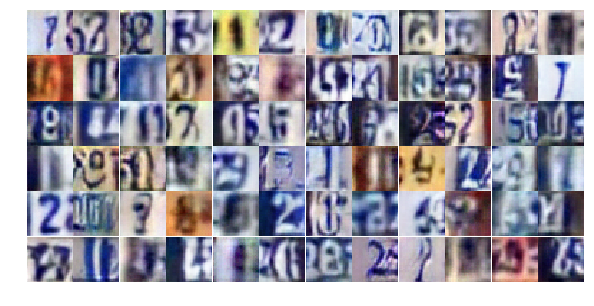

Epoch 13/25... Discriminator Loss: 0.5150... Generator Loss: 1.4623
Epoch 13/25... Discriminator Loss: 0.6724... Generator Loss: 1.2633
Epoch 13/25... Discriminator Loss: 0.9475... Generator Loss: 0.7278
Epoch 13/25... Discriminator Loss: 0.4920... Generator Loss: 1.4478
Epoch 13/25... Discriminator Loss: 1.0740... Generator Loss: 0.6225
Epoch 13/25... Discriminator Loss: 0.8388... Generator Loss: 0.8007
Epoch 13/25... Discriminator Loss: 0.5952... Generator Loss: 1.1660
Epoch 13/25... Discriminator Loss: 0.8294... Generator Loss: 0.7608
Epoch 13/25... Discriminator Loss: 0.8199... Generator Loss: 0.8052
Epoch 13/25... Discriminator Loss: 0.9260... Generator Loss: 0.7131


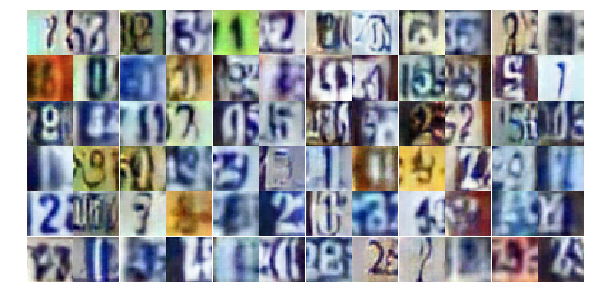

Epoch 13/25... Discriminator Loss: 0.3121... Generator Loss: 2.0355
Epoch 13/25... Discriminator Loss: 1.3257... Generator Loss: 0.4675
Epoch 13/25... Discriminator Loss: 0.6050... Generator Loss: 1.0834
Epoch 13/25... Discriminator Loss: 0.8403... Generator Loss: 0.7596
Epoch 14/25... Discriminator Loss: 0.9253... Generator Loss: 0.6856
Epoch 14/25... Discriminator Loss: 0.7780... Generator Loss: 1.5335
Epoch 14/25... Discriminator Loss: 0.8664... Generator Loss: 0.7848
Epoch 14/25... Discriminator Loss: 0.4850... Generator Loss: 2.2494
Epoch 14/25... Discriminator Loss: 0.6724... Generator Loss: 0.9778
Epoch 14/25... Discriminator Loss: 0.7209... Generator Loss: 1.0098


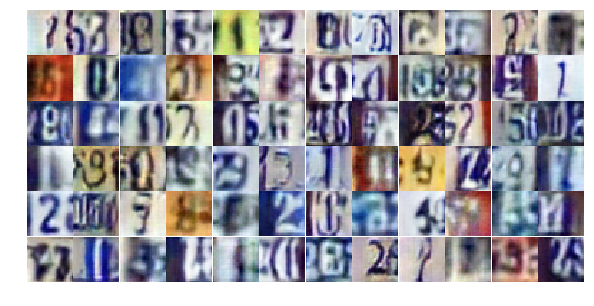

Epoch 14/25... Discriminator Loss: 0.7633... Generator Loss: 1.1917
Epoch 14/25... Discriminator Loss: 0.5724... Generator Loss: 1.1205
Epoch 14/25... Discriminator Loss: 0.6273... Generator Loss: 1.5436
Epoch 14/25... Discriminator Loss: 0.7818... Generator Loss: 0.8891
Epoch 14/25... Discriminator Loss: 1.4120... Generator Loss: 0.3703
Epoch 14/25... Discriminator Loss: 0.3212... Generator Loss: 1.6895
Epoch 14/25... Discriminator Loss: 0.3485... Generator Loss: 1.8370
Epoch 14/25... Discriminator Loss: 1.7378... Generator Loss: 0.2723
Epoch 14/25... Discriminator Loss: 1.1887... Generator Loss: 0.5357
Epoch 14/25... Discriminator Loss: 1.3746... Generator Loss: 0.4258


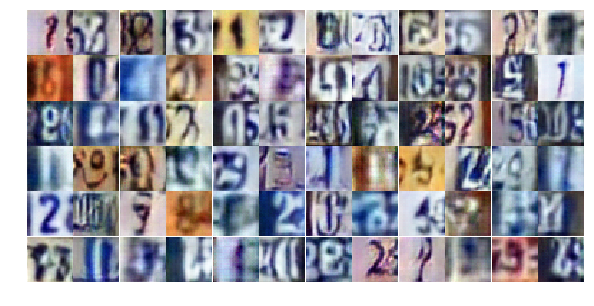

Epoch 14/25... Discriminator Loss: 0.7115... Generator Loss: 0.9403
Epoch 14/25... Discriminator Loss: 1.4592... Generator Loss: 4.0172
Epoch 14/25... Discriminator Loss: 0.9784... Generator Loss: 1.6700
Epoch 14/25... Discriminator Loss: 0.4492... Generator Loss: 1.4857
Epoch 14/25... Discriminator Loss: 1.0225... Generator Loss: 0.6103
Epoch 14/25... Discriminator Loss: 0.8047... Generator Loss: 0.8475
Epoch 14/25... Discriminator Loss: 0.7550... Generator Loss: 0.9150
Epoch 14/25... Discriminator Loss: 0.7653... Generator Loss: 0.8549
Epoch 14/25... Discriminator Loss: 0.5695... Generator Loss: 1.1658
Epoch 14/25... Discriminator Loss: 0.4887... Generator Loss: 2.3758


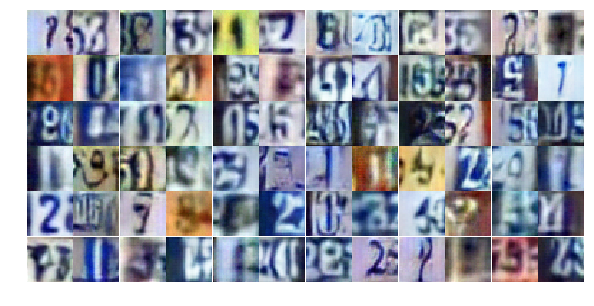

Epoch 14/25... Discriminator Loss: 1.4746... Generator Loss: 0.3841
Epoch 14/25... Discriminator Loss: 0.5368... Generator Loss: 1.2744
Epoch 14/25... Discriminator Loss: 0.4422... Generator Loss: 1.6282
Epoch 14/25... Discriminator Loss: 0.4127... Generator Loss: 1.5442
Epoch 14/25... Discriminator Loss: 0.5388... Generator Loss: 2.1666
Epoch 14/25... Discriminator Loss: 0.5452... Generator Loss: 1.1554
Epoch 14/25... Discriminator Loss: 0.8469... Generator Loss: 0.8189
Epoch 14/25... Discriminator Loss: 0.4048... Generator Loss: 1.5070
Epoch 14/25... Discriminator Loss: 0.4915... Generator Loss: 2.2938
Epoch 14/25... Discriminator Loss: 0.8834... Generator Loss: 0.7568


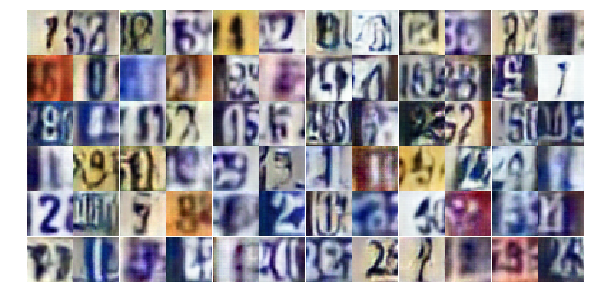

Epoch 14/25... Discriminator Loss: 1.0157... Generator Loss: 0.6245
Epoch 14/25... Discriminator Loss: 1.3895... Generator Loss: 0.3957
Epoch 14/25... Discriminator Loss: 0.8547... Generator Loss: 0.7404
Epoch 14/25... Discriminator Loss: 1.0132... Generator Loss: 0.6682
Epoch 14/25... Discriminator Loss: 0.9157... Generator Loss: 0.7418
Epoch 14/25... Discriminator Loss: 0.7338... Generator Loss: 0.9912
Epoch 14/25... Discriminator Loss: 0.5859... Generator Loss: 1.6166
Epoch 14/25... Discriminator Loss: 0.4858... Generator Loss: 1.4766
Epoch 14/25... Discriminator Loss: 0.5439... Generator Loss: 1.4149
Epoch 14/25... Discriminator Loss: 1.2593... Generator Loss: 0.4669


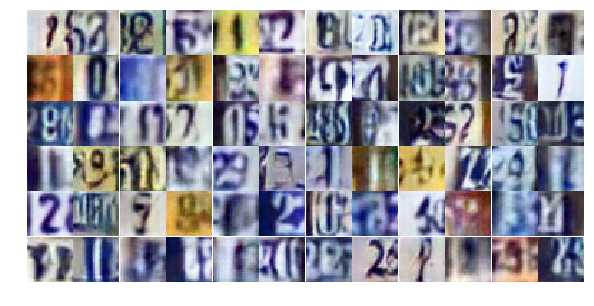

Epoch 14/25... Discriminator Loss: 0.7224... Generator Loss: 1.6372
Epoch 14/25... Discriminator Loss: 0.8006... Generator Loss: 0.8113
Epoch 14/25... Discriminator Loss: 0.5422... Generator Loss: 1.6101
Epoch 14/25... Discriminator Loss: 0.7387... Generator Loss: 0.9719
Epoch 14/25... Discriminator Loss: 0.4218... Generator Loss: 1.5039
Epoch 14/25... Discriminator Loss: 0.7616... Generator Loss: 0.8620
Epoch 14/25... Discriminator Loss: 0.8112... Generator Loss: 2.8844
Epoch 14/25... Discriminator Loss: 1.2762... Generator Loss: 0.4471
Epoch 14/25... Discriminator Loss: 2.1109... Generator Loss: 0.2260
Epoch 14/25... Discriminator Loss: 1.2720... Generator Loss: 0.5111


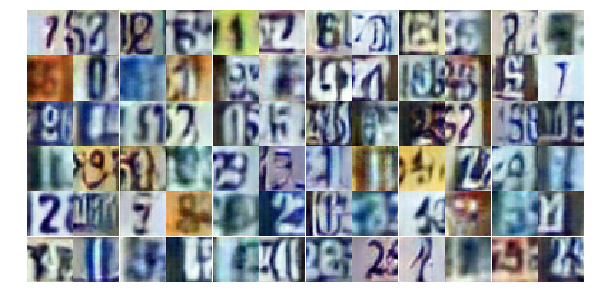

Epoch 14/25... Discriminator Loss: 0.8279... Generator Loss: 0.9409
Epoch 14/25... Discriminator Loss: 0.9014... Generator Loss: 0.7727
Epoch 15/25... Discriminator Loss: 0.5061... Generator Loss: 1.5022
Epoch 15/25... Discriminator Loss: 0.4842... Generator Loss: 1.7446
Epoch 15/25... Discriminator Loss: 0.5839... Generator Loss: 1.3061
Epoch 15/25... Discriminator Loss: 0.5806... Generator Loss: 1.1630
Epoch 15/25... Discriminator Loss: 0.9699... Generator Loss: 0.6742
Epoch 15/25... Discriminator Loss: 0.7353... Generator Loss: 0.9032
Epoch 15/25... Discriminator Loss: 1.1396... Generator Loss: 0.5633
Epoch 15/25... Discriminator Loss: 0.7718... Generator Loss: 0.8493


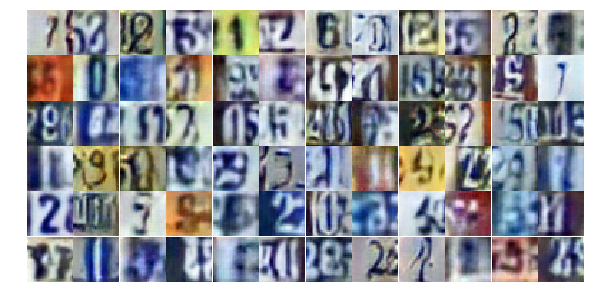

Epoch 15/25... Discriminator Loss: 0.5618... Generator Loss: 1.1633
Epoch 15/25... Discriminator Loss: 0.8687... Generator Loss: 3.3045
Epoch 15/25... Discriminator Loss: 0.9253... Generator Loss: 0.7662
Epoch 15/25... Discriminator Loss: 0.5356... Generator Loss: 1.3398
Epoch 15/25... Discriminator Loss: 0.8762... Generator Loss: 0.9074
Epoch 15/25... Discriminator Loss: 0.4056... Generator Loss: 1.9160
Epoch 15/25... Discriminator Loss: 1.5746... Generator Loss: 0.3350
Epoch 15/25... Discriminator Loss: 0.8904... Generator Loss: 1.4191
Epoch 15/25... Discriminator Loss: 0.7559... Generator Loss: 3.4928
Epoch 15/25... Discriminator Loss: 1.0047... Generator Loss: 0.6763


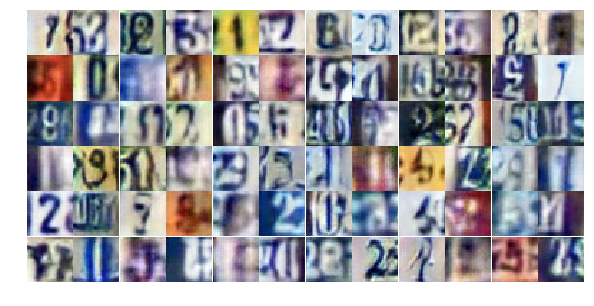

Epoch 15/25... Discriminator Loss: 0.7543... Generator Loss: 0.9333
Epoch 15/25... Discriminator Loss: 0.5748... Generator Loss: 1.2089
Epoch 15/25... Discriminator Loss: 0.9034... Generator Loss: 0.7917
Epoch 15/25... Discriminator Loss: 0.8779... Generator Loss: 0.7719
Epoch 15/25... Discriminator Loss: 1.0398... Generator Loss: 0.6610
Epoch 15/25... Discriminator Loss: 0.6198... Generator Loss: 1.2247
Epoch 15/25... Discriminator Loss: 0.6473... Generator Loss: 1.1535
Epoch 15/25... Discriminator Loss: 0.8859... Generator Loss: 0.8808
Epoch 15/25... Discriminator Loss: 0.5480... Generator Loss: 1.1702
Epoch 15/25... Discriminator Loss: 0.9162... Generator Loss: 0.8084


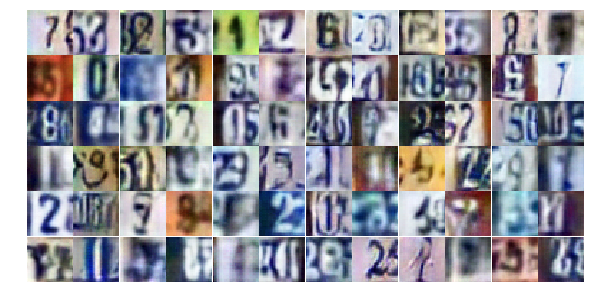

Epoch 15/25... Discriminator Loss: 0.9551... Generator Loss: 0.6378
Epoch 15/25... Discriminator Loss: 0.5404... Generator Loss: 1.9671
Epoch 15/25... Discriminator Loss: 0.3139... Generator Loss: 1.9512
Epoch 15/25... Discriminator Loss: 0.5255... Generator Loss: 1.5384
Epoch 15/25... Discriminator Loss: 0.3989... Generator Loss: 1.7293
Epoch 15/25... Discriminator Loss: 1.2601... Generator Loss: 2.9997
Epoch 15/25... Discriminator Loss: 0.5504... Generator Loss: 1.3790
Epoch 15/25... Discriminator Loss: 0.7160... Generator Loss: 0.8765
Epoch 15/25... Discriminator Loss: 0.5724... Generator Loss: 1.0956
Epoch 15/25... Discriminator Loss: 0.8008... Generator Loss: 1.0016


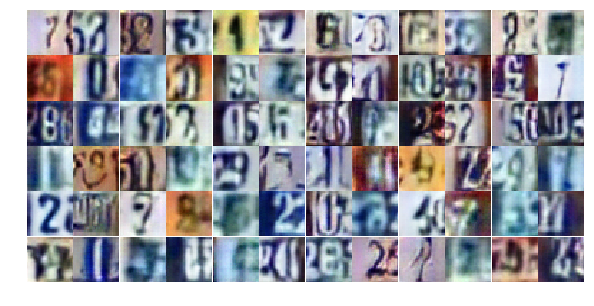

Epoch 15/25... Discriminator Loss: 0.5685... Generator Loss: 1.2591
Epoch 15/25... Discriminator Loss: 1.4126... Generator Loss: 0.4131
Epoch 15/25... Discriminator Loss: 0.7459... Generator Loss: 0.9120
Epoch 15/25... Discriminator Loss: 0.7095... Generator Loss: 1.0201
Epoch 15/25... Discriminator Loss: 0.5532... Generator Loss: 1.2235
Epoch 15/25... Discriminator Loss: 1.5877... Generator Loss: 0.3955
Epoch 15/25... Discriminator Loss: 1.3089... Generator Loss: 4.8234
Epoch 15/25... Discriminator Loss: 0.8102... Generator Loss: 1.6452
Epoch 15/25... Discriminator Loss: 0.8116... Generator Loss: 0.8756
Epoch 15/25... Discriminator Loss: 0.6912... Generator Loss: 1.2908


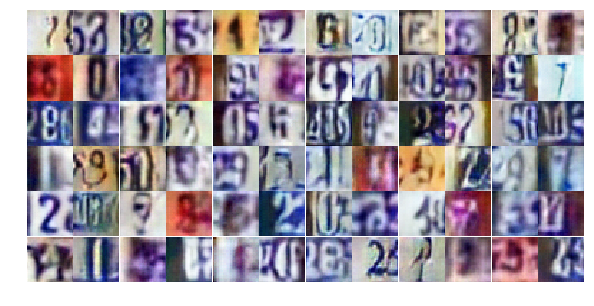

Epoch 15/25... Discriminator Loss: 0.8945... Generator Loss: 0.7783
Epoch 15/25... Discriminator Loss: 0.7604... Generator Loss: 1.0921
Epoch 15/25... Discriminator Loss: 0.3606... Generator Loss: 1.7380
Epoch 15/25... Discriminator Loss: 1.4788... Generator Loss: 0.3777
Epoch 15/25... Discriminator Loss: 0.5356... Generator Loss: 1.2784
Epoch 15/25... Discriminator Loss: 1.4436... Generator Loss: 0.3986
Epoch 15/25... Discriminator Loss: 0.7549... Generator Loss: 0.8753
Epoch 15/25... Discriminator Loss: 0.9686... Generator Loss: 0.7480
Epoch 15/25... Discriminator Loss: 1.2300... Generator Loss: 0.7168
Epoch 16/25... Discriminator Loss: 1.0577... Generator Loss: 0.7582


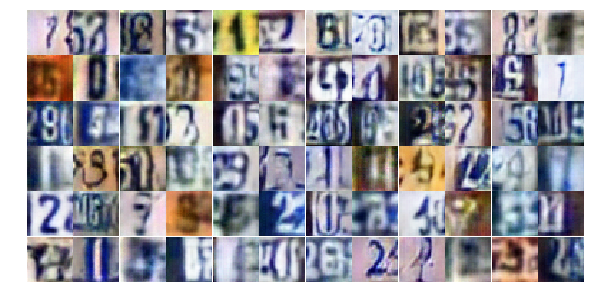

Epoch 16/25... Discriminator Loss: 0.9249... Generator Loss: 0.7154
Epoch 16/25... Discriminator Loss: 0.9086... Generator Loss: 0.7274
Epoch 16/25... Discriminator Loss: 0.7394... Generator Loss: 1.0479
Epoch 16/25... Discriminator Loss: 0.5704... Generator Loss: 1.2507
Epoch 16/25... Discriminator Loss: 0.6209... Generator Loss: 1.8987
Epoch 16/25... Discriminator Loss: 0.7124... Generator Loss: 0.9420
Epoch 16/25... Discriminator Loss: 1.7152... Generator Loss: 0.2712
Epoch 16/25... Discriminator Loss: 1.0038... Generator Loss: 0.6662
Epoch 16/25... Discriminator Loss: 0.5651... Generator Loss: 1.1373
Epoch 16/25... Discriminator Loss: 0.5788... Generator Loss: 1.2404


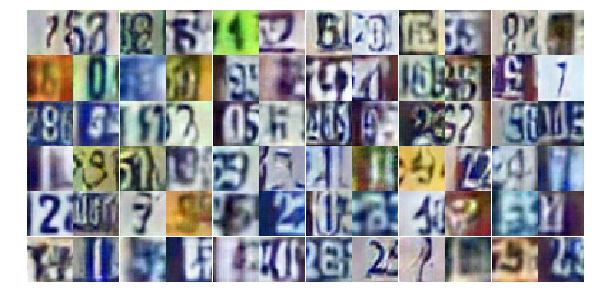

Epoch 16/25... Discriminator Loss: 1.0718... Generator Loss: 0.6164
Epoch 16/25... Discriminator Loss: 0.4863... Generator Loss: 1.7396
Epoch 16/25... Discriminator Loss: 0.6912... Generator Loss: 1.0611
Epoch 16/25... Discriminator Loss: 1.2811... Generator Loss: 0.4819
Epoch 16/25... Discriminator Loss: 0.3665... Generator Loss: 1.7125
Epoch 16/25... Discriminator Loss: 0.6104... Generator Loss: 1.2153
Epoch 16/25... Discriminator Loss: 1.5397... Generator Loss: 0.3330
Epoch 16/25... Discriminator Loss: 0.4400... Generator Loss: 1.6007
Epoch 16/25... Discriminator Loss: 0.5064... Generator Loss: 1.3317
Epoch 16/25... Discriminator Loss: 0.7090... Generator Loss: 0.9069


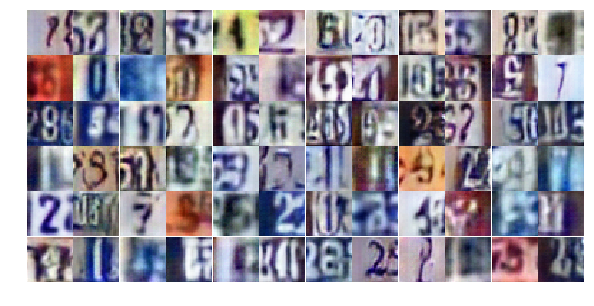

Epoch 16/25... Discriminator Loss: 0.4600... Generator Loss: 1.5688
Epoch 16/25... Discriminator Loss: 0.6513... Generator Loss: 1.0723
Epoch 16/25... Discriminator Loss: 0.6792... Generator Loss: 0.9906
Epoch 16/25... Discriminator Loss: 0.8415... Generator Loss: 0.8483
Epoch 16/25... Discriminator Loss: 0.6240... Generator Loss: 1.6577
Epoch 16/25... Discriminator Loss: 0.9794... Generator Loss: 0.6394
Epoch 16/25... Discriminator Loss: 0.6792... Generator Loss: 1.0729
Epoch 16/25... Discriminator Loss: 0.5089... Generator Loss: 1.3748
Epoch 16/25... Discriminator Loss: 0.7866... Generator Loss: 0.8882
Epoch 16/25... Discriminator Loss: 0.6235... Generator Loss: 1.1021


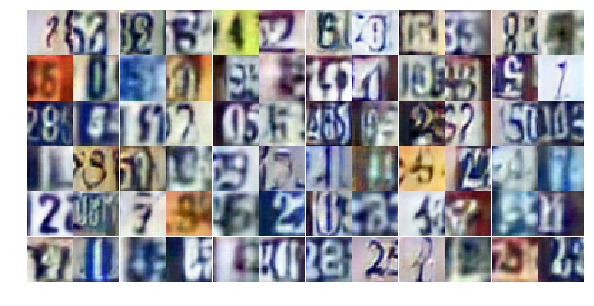

Epoch 16/25... Discriminator Loss: 0.6713... Generator Loss: 0.9430
Epoch 16/25... Discriminator Loss: 0.6885... Generator Loss: 0.9207
Epoch 16/25... Discriminator Loss: 0.7985... Generator Loss: 1.0062
Epoch 16/25... Discriminator Loss: 1.1720... Generator Loss: 0.5926
Epoch 16/25... Discriminator Loss: 0.8706... Generator Loss: 1.0785
Epoch 16/25... Discriminator Loss: 0.7018... Generator Loss: 0.9579
Epoch 16/25... Discriminator Loss: 0.6432... Generator Loss: 1.0239
Epoch 16/25... Discriminator Loss: 1.1153... Generator Loss: 0.5379
Epoch 16/25... Discriminator Loss: 0.6430... Generator Loss: 1.1246
Epoch 16/25... Discriminator Loss: 0.4880... Generator Loss: 1.3507


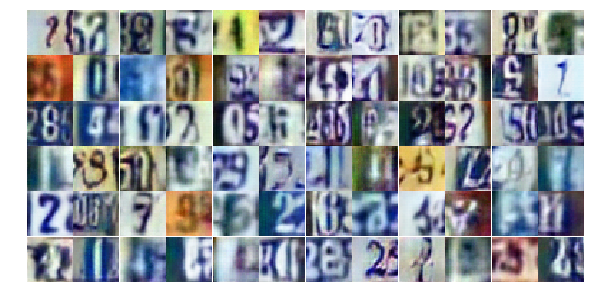

Epoch 16/25... Discriminator Loss: 0.5547... Generator Loss: 1.3015
Epoch 16/25... Discriminator Loss: 0.5997... Generator Loss: 1.8322
Epoch 16/25... Discriminator Loss: 1.0962... Generator Loss: 0.5976
Epoch 16/25... Discriminator Loss: 2.7832... Generator Loss: 4.3121
Epoch 16/25... Discriminator Loss: 1.6397... Generator Loss: 0.3573
Epoch 16/25... Discriminator Loss: 1.2033... Generator Loss: 0.6014
Epoch 16/25... Discriminator Loss: 0.4019... Generator Loss: 1.6721
Epoch 16/25... Discriminator Loss: 0.7250... Generator Loss: 1.1249
Epoch 16/25... Discriminator Loss: 0.6229... Generator Loss: 1.1123
Epoch 16/25... Discriminator Loss: 1.0013... Generator Loss: 0.6156


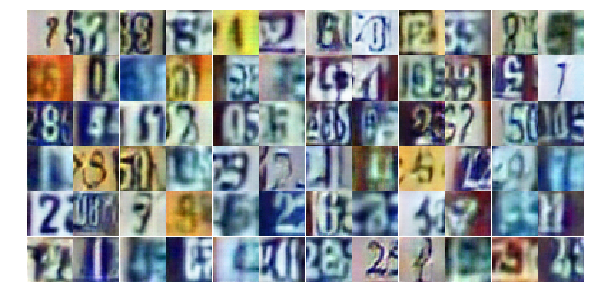

Epoch 16/25... Discriminator Loss: 1.1668... Generator Loss: 0.5537
Epoch 16/25... Discriminator Loss: 0.6958... Generator Loss: 1.0091
Epoch 16/25... Discriminator Loss: 1.1911... Generator Loss: 0.5333
Epoch 16/25... Discriminator Loss: 0.4489... Generator Loss: 1.4347
Epoch 16/25... Discriminator Loss: 0.9099... Generator Loss: 0.6950
Epoch 16/25... Discriminator Loss: 0.5807... Generator Loss: 1.2845
Epoch 17/25... Discriminator Loss: 0.9115... Generator Loss: 0.7082
Epoch 17/25... Discriminator Loss: 0.7488... Generator Loss: 1.1719
Epoch 17/25... Discriminator Loss: 0.8309... Generator Loss: 0.8494
Epoch 17/25... Discriminator Loss: 0.5110... Generator Loss: 1.3925


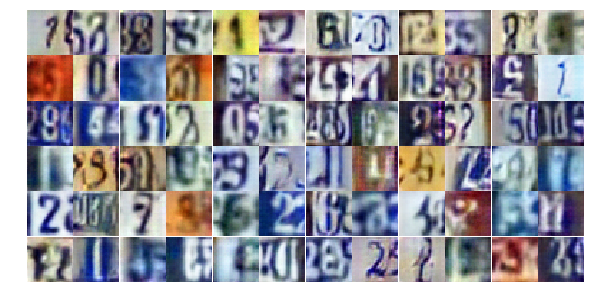

Epoch 17/25... Discriminator Loss: 0.4501... Generator Loss: 1.5132
Epoch 17/25... Discriminator Loss: 0.3659... Generator Loss: 1.6477
Epoch 17/25... Discriminator Loss: 0.8036... Generator Loss: 0.9060
Epoch 17/25... Discriminator Loss: 0.6045... Generator Loss: 1.1886
Epoch 17/25... Discriminator Loss: 1.2943... Generator Loss: 0.4796
Epoch 17/25... Discriminator Loss: 1.0970... Generator Loss: 0.5731
Epoch 17/25... Discriminator Loss: 0.6190... Generator Loss: 1.4288
Epoch 17/25... Discriminator Loss: 0.8822... Generator Loss: 0.7464
Epoch 17/25... Discriminator Loss: 0.3611... Generator Loss: 1.8260
Epoch 17/25... Discriminator Loss: 0.7963... Generator Loss: 0.8486


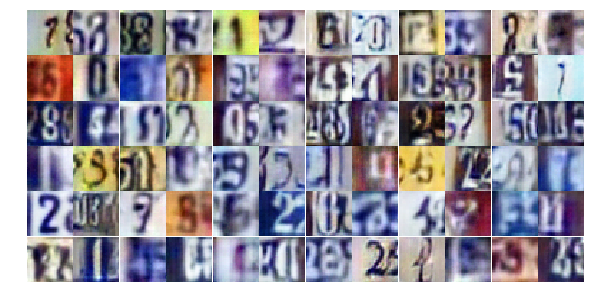

Epoch 17/25... Discriminator Loss: 1.0459... Generator Loss: 0.6396
Epoch 17/25... Discriminator Loss: 0.4984... Generator Loss: 1.8138
Epoch 17/25... Discriminator Loss: 0.6628... Generator Loss: 1.1016
Epoch 17/25... Discriminator Loss: 0.9116... Generator Loss: 0.8127
Epoch 17/25... Discriminator Loss: 0.5559... Generator Loss: 1.3846
Epoch 17/25... Discriminator Loss: 1.1163... Generator Loss: 0.5586
Epoch 17/25... Discriminator Loss: 0.6924... Generator Loss: 1.7729
Epoch 17/25... Discriminator Loss: 0.6309... Generator Loss: 1.0918
Epoch 17/25... Discriminator Loss: 0.5577... Generator Loss: 1.2067
Epoch 17/25... Discriminator Loss: 0.5061... Generator Loss: 1.2387


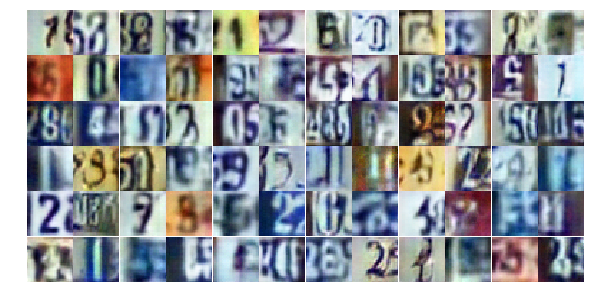

Epoch 17/25... Discriminator Loss: 1.4845... Generator Loss: 0.3455
Epoch 17/25... Discriminator Loss: 0.3422... Generator Loss: 1.8872
Epoch 17/25... Discriminator Loss: 0.5050... Generator Loss: 1.2045
Epoch 17/25... Discriminator Loss: 0.8979... Generator Loss: 0.7719
Epoch 17/25... Discriminator Loss: 1.6828... Generator Loss: 0.3265
Epoch 17/25... Discriminator Loss: 0.5524... Generator Loss: 1.2241
Epoch 17/25... Discriminator Loss: 0.7642... Generator Loss: 0.9154
Epoch 17/25... Discriminator Loss: 0.8209... Generator Loss: 1.0058
Epoch 17/25... Discriminator Loss: 1.1294... Generator Loss: 0.5485
Epoch 17/25... Discriminator Loss: 0.3872... Generator Loss: 1.7526


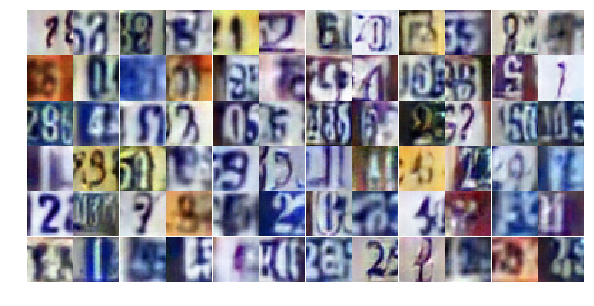

Epoch 17/25... Discriminator Loss: 0.5928... Generator Loss: 1.4221
Epoch 17/25... Discriminator Loss: 1.0931... Generator Loss: 1.6774
Epoch 17/25... Discriminator Loss: 0.7008... Generator Loss: 1.7494
Epoch 17/25... Discriminator Loss: 0.8939... Generator Loss: 0.7575
Epoch 17/25... Discriminator Loss: 1.3409... Generator Loss: 0.4376
Epoch 17/25... Discriminator Loss: 0.6518... Generator Loss: 1.0141
Epoch 17/25... Discriminator Loss: 0.7333... Generator Loss: 1.0525
Epoch 17/25... Discriminator Loss: 0.4677... Generator Loss: 1.4389
Epoch 17/25... Discriminator Loss: 0.3730... Generator Loss: 1.5031
Epoch 17/25... Discriminator Loss: 1.1627... Generator Loss: 0.5514


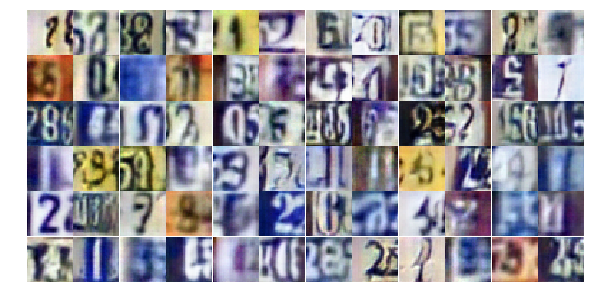

Epoch 17/25... Discriminator Loss: 0.7486... Generator Loss: 1.1392
Epoch 17/25... Discriminator Loss: 0.2755... Generator Loss: 2.1328
Epoch 17/25... Discriminator Loss: 0.8163... Generator Loss: 0.9048
Epoch 17/25... Discriminator Loss: 0.3855... Generator Loss: 1.6945
Epoch 17/25... Discriminator Loss: 0.6655... Generator Loss: 1.0631
Epoch 17/25... Discriminator Loss: 1.0833... Generator Loss: 0.5510
Epoch 17/25... Discriminator Loss: 1.1408... Generator Loss: 0.5503
Epoch 17/25... Discriminator Loss: 0.5465... Generator Loss: 1.4257
Epoch 17/25... Discriminator Loss: 0.7632... Generator Loss: 1.2421
Epoch 17/25... Discriminator Loss: 1.6081... Generator Loss: 0.2922


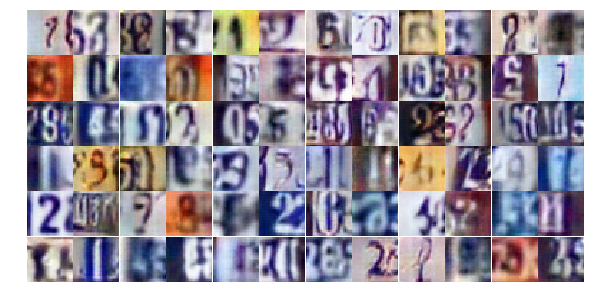

Epoch 17/25... Discriminator Loss: 1.6778... Generator Loss: 0.3068
Epoch 17/25... Discriminator Loss: 1.1074... Generator Loss: 0.5912
Epoch 17/25... Discriminator Loss: 0.7472... Generator Loss: 0.9040
Epoch 17/25... Discriminator Loss: 0.6027... Generator Loss: 1.1635
Epoch 18/25... Discriminator Loss: 1.0596... Generator Loss: 0.6183
Epoch 18/25... Discriminator Loss: 0.9089... Generator Loss: 0.7374
Epoch 18/25... Discriminator Loss: 0.8113... Generator Loss: 0.8395
Epoch 18/25... Discriminator Loss: 0.8077... Generator Loss: 0.8454
Epoch 18/25... Discriminator Loss: 1.2339... Generator Loss: 0.5174
Epoch 18/25... Discriminator Loss: 0.6655... Generator Loss: 1.0067


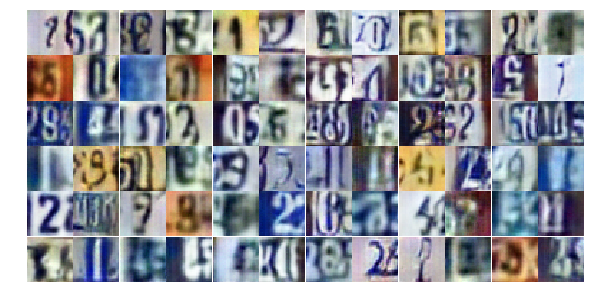

Epoch 18/25... Discriminator Loss: 0.4479... Generator Loss: 1.4784
Epoch 18/25... Discriminator Loss: 1.0127... Generator Loss: 0.6451
Epoch 18/25... Discriminator Loss: 0.8105... Generator Loss: 0.8175
Epoch 18/25... Discriminator Loss: 0.4285... Generator Loss: 1.8128
Epoch 18/25... Discriminator Loss: 0.5535... Generator Loss: 1.2095
Epoch 18/25... Discriminator Loss: 1.3417... Generator Loss: 0.4596
Epoch 18/25... Discriminator Loss: 0.4511... Generator Loss: 1.4768
Epoch 18/25... Discriminator Loss: 0.8721... Generator Loss: 0.8862
Epoch 18/25... Discriminator Loss: 0.5162... Generator Loss: 1.2114
Epoch 18/25... Discriminator Loss: 0.3376... Generator Loss: 1.8091


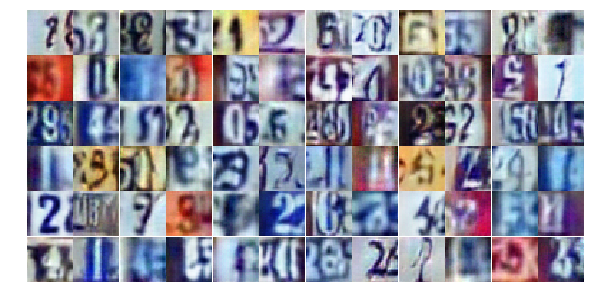

Epoch 18/25... Discriminator Loss: 0.8238... Generator Loss: 1.0204
Epoch 18/25... Discriminator Loss: 0.4771... Generator Loss: 1.9503
Epoch 18/25... Discriminator Loss: 1.3163... Generator Loss: 0.4524
Epoch 18/25... Discriminator Loss: 0.5028... Generator Loss: 1.7541
Epoch 18/25... Discriminator Loss: 0.6836... Generator Loss: 0.9913
Epoch 18/25... Discriminator Loss: 0.8936... Generator Loss: 0.7930
Epoch 18/25... Discriminator Loss: 0.8215... Generator Loss: 0.9078
Epoch 18/25... Discriminator Loss: 0.9218... Generator Loss: 0.7399
Epoch 18/25... Discriminator Loss: 0.8932... Generator Loss: 0.8105
Epoch 18/25... Discriminator Loss: 0.6883... Generator Loss: 1.2494


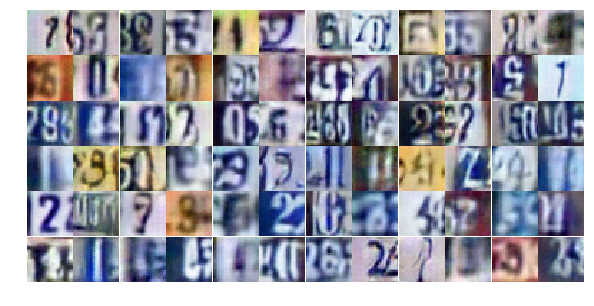

Epoch 18/25... Discriminator Loss: 0.5790... Generator Loss: 1.5434
Epoch 18/25... Discriminator Loss: 0.7602... Generator Loss: 1.2660
Epoch 18/25... Discriminator Loss: 0.8003... Generator Loss: 0.8144
Epoch 18/25... Discriminator Loss: 0.6313... Generator Loss: 1.0363
Epoch 18/25... Discriminator Loss: 0.7709... Generator Loss: 0.8864
Epoch 18/25... Discriminator Loss: 0.5276... Generator Loss: 1.3156
Epoch 18/25... Discriminator Loss: 0.8546... Generator Loss: 0.8773
Epoch 18/25... Discriminator Loss: 0.5185... Generator Loss: 1.5223
Epoch 18/25... Discriminator Loss: 0.5453... Generator Loss: 1.4014
Epoch 18/25... Discriminator Loss: 0.6364... Generator Loss: 1.4109


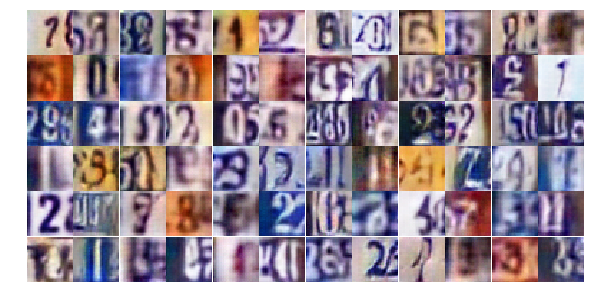

Epoch 18/25... Discriminator Loss: 0.5104... Generator Loss: 1.3021
Epoch 18/25... Discriminator Loss: 1.0328... Generator Loss: 0.6291
Epoch 18/25... Discriminator Loss: 0.7035... Generator Loss: 0.9994
Epoch 18/25... Discriminator Loss: 0.5175... Generator Loss: 1.5503
Epoch 18/25... Discriminator Loss: 1.0669... Generator Loss: 0.6261
Epoch 18/25... Discriminator Loss: 0.4125... Generator Loss: 1.4726
Epoch 18/25... Discriminator Loss: 0.8647... Generator Loss: 0.7580
Epoch 18/25... Discriminator Loss: 2.6383... Generator Loss: 3.6391
Epoch 18/25... Discriminator Loss: 1.2904... Generator Loss: 0.5690
Epoch 18/25... Discriminator Loss: 0.3722... Generator Loss: 2.3631


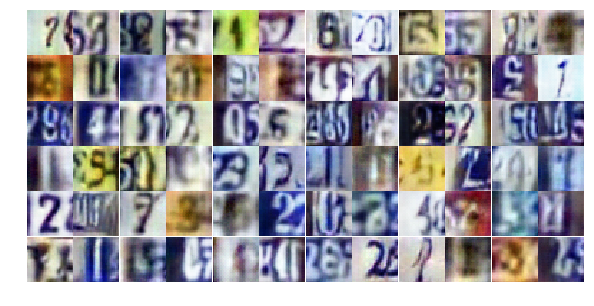

Epoch 18/25... Discriminator Loss: 0.7058... Generator Loss: 1.0808
Epoch 18/25... Discriminator Loss: 0.6908... Generator Loss: 1.0719
Epoch 18/25... Discriminator Loss: 0.7468... Generator Loss: 1.1425
Epoch 18/25... Discriminator Loss: 0.9043... Generator Loss: 0.9329
Epoch 18/25... Discriminator Loss: 0.6578... Generator Loss: 1.1466
Epoch 18/25... Discriminator Loss: 0.7145... Generator Loss: 1.0295
Epoch 18/25... Discriminator Loss: 0.7109... Generator Loss: 1.0075
Epoch 18/25... Discriminator Loss: 0.5705... Generator Loss: 1.2151
Epoch 18/25... Discriminator Loss: 1.2163... Generator Loss: 0.5135
Epoch 18/25... Discriminator Loss: 1.0551... Generator Loss: 0.6767


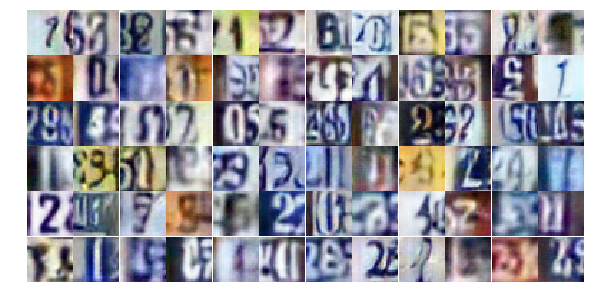

Epoch 18/25... Discriminator Loss: 0.6123... Generator Loss: 1.3307
Epoch 19/25... Discriminator Loss: 1.4494... Generator Loss: 0.3945
Epoch 19/25... Discriminator Loss: 1.3138... Generator Loss: 0.4180
Epoch 19/25... Discriminator Loss: 0.9480... Generator Loss: 0.7316
Epoch 19/25... Discriminator Loss: 0.6753... Generator Loss: 0.9927
Epoch 19/25... Discriminator Loss: 0.9036... Generator Loss: 0.7865
Epoch 19/25... Discriminator Loss: 0.5205... Generator Loss: 1.6533
Epoch 19/25... Discriminator Loss: 1.0312... Generator Loss: 0.6177
Epoch 19/25... Discriminator Loss: 0.6497... Generator Loss: 1.0762
Epoch 19/25... Discriminator Loss: 0.8256... Generator Loss: 0.8025


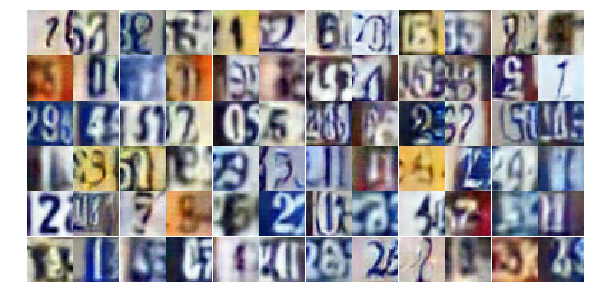

Epoch 19/25... Discriminator Loss: 0.7265... Generator Loss: 0.9200
Epoch 19/25... Discriminator Loss: 0.6873... Generator Loss: 1.2037
Epoch 19/25... Discriminator Loss: 0.8021... Generator Loss: 1.0030
Epoch 19/25... Discriminator Loss: 0.8404... Generator Loss: 0.7563
Epoch 19/25... Discriminator Loss: 0.8320... Generator Loss: 0.7856
Epoch 19/25... Discriminator Loss: 0.8193... Generator Loss: 0.8310
Epoch 19/25... Discriminator Loss: 0.9169... Generator Loss: 0.7253
Epoch 19/25... Discriminator Loss: 0.6274... Generator Loss: 1.0801
Epoch 19/25... Discriminator Loss: 0.7625... Generator Loss: 1.3226
Epoch 19/25... Discriminator Loss: 1.7535... Generator Loss: 0.2852


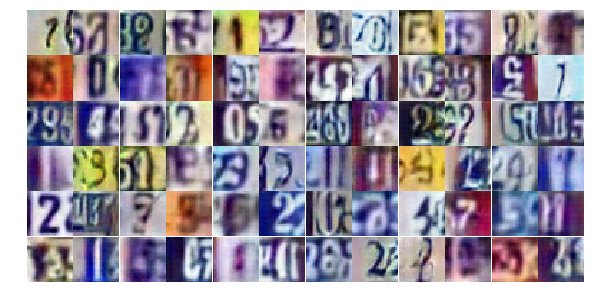

Epoch 19/25... Discriminator Loss: 0.5567... Generator Loss: 1.1735
Epoch 19/25... Discriminator Loss: 1.0268... Generator Loss: 0.6928
Epoch 19/25... Discriminator Loss: 1.2957... Generator Loss: 0.4847
Epoch 19/25... Discriminator Loss: 0.7047... Generator Loss: 1.1154
Epoch 19/25... Discriminator Loss: 1.1899... Generator Loss: 0.5840
Epoch 19/25... Discriminator Loss: 1.0604... Generator Loss: 0.6496
Epoch 19/25... Discriminator Loss: 1.0326... Generator Loss: 0.6715
Epoch 19/25... Discriminator Loss: 0.6590... Generator Loss: 1.0815
Epoch 19/25... Discriminator Loss: 0.9574... Generator Loss: 0.6994
Epoch 19/25... Discriminator Loss: 0.7008... Generator Loss: 0.9211


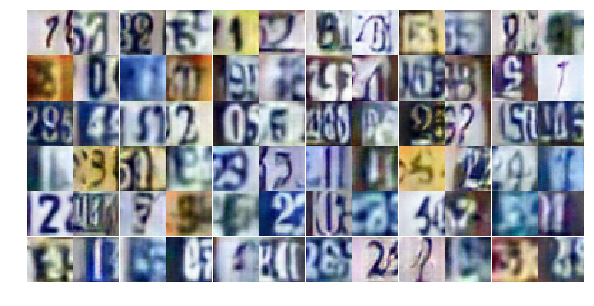

Epoch 19/25... Discriminator Loss: 0.8671... Generator Loss: 0.8089
Epoch 19/25... Discriminator Loss: 0.6800... Generator Loss: 1.0630
Epoch 19/25... Discriminator Loss: 0.7732... Generator Loss: 0.8485
Epoch 19/25... Discriminator Loss: 0.6443... Generator Loss: 0.9793
Epoch 19/25... Discriminator Loss: 0.7557... Generator Loss: 0.9604
Epoch 19/25... Discriminator Loss: 1.3622... Generator Loss: 0.4827
Epoch 19/25... Discriminator Loss: 0.9734... Generator Loss: 0.7443
Epoch 19/25... Discriminator Loss: 0.4198... Generator Loss: 1.6266
Epoch 19/25... Discriminator Loss: 0.6741... Generator Loss: 1.1072
Epoch 19/25... Discriminator Loss: 0.4231... Generator Loss: 1.8581


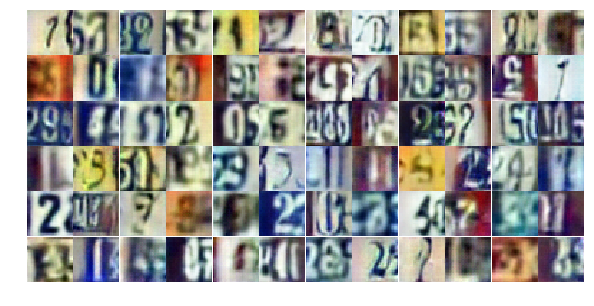

Epoch 19/25... Discriminator Loss: 0.5324... Generator Loss: 1.5932
Epoch 19/25... Discriminator Loss: 1.3593... Generator Loss: 0.4219
Epoch 19/25... Discriminator Loss: 1.1635... Generator Loss: 0.5111
Epoch 19/25... Discriminator Loss: 0.5005... Generator Loss: 1.4576
Epoch 19/25... Discriminator Loss: 0.6837... Generator Loss: 1.0794
Epoch 19/25... Discriminator Loss: 0.4284... Generator Loss: 2.5571
Epoch 19/25... Discriminator Loss: 0.9910... Generator Loss: 0.8610
Epoch 19/25... Discriminator Loss: 0.4485... Generator Loss: 1.3479
Epoch 19/25... Discriminator Loss: 0.5626... Generator Loss: 1.3719
Epoch 19/25... Discriminator Loss: 0.7909... Generator Loss: 0.8499


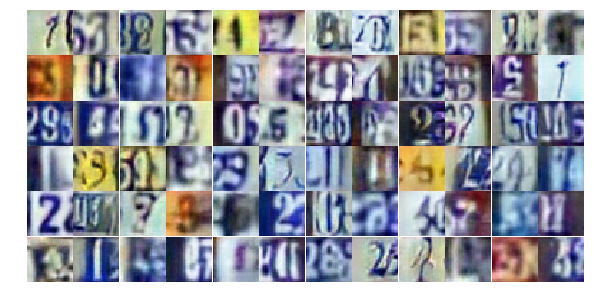

Epoch 19/25... Discriminator Loss: 0.8403... Generator Loss: 0.8002
Epoch 19/25... Discriminator Loss: 0.8692... Generator Loss: 0.7825
Epoch 19/25... Discriminator Loss: 0.6417... Generator Loss: 1.6588
Epoch 19/25... Discriminator Loss: 0.6820... Generator Loss: 1.0191
Epoch 19/25... Discriminator Loss: 1.2221... Generator Loss: 3.6218
Epoch 19/25... Discriminator Loss: 0.8363... Generator Loss: 0.9300
Epoch 19/25... Discriminator Loss: 1.8729... Generator Loss: 0.3553
Epoch 19/25... Discriminator Loss: 0.6195... Generator Loss: 1.1772
Epoch 20/25... Discriminator Loss: 0.8155... Generator Loss: 0.8280
Epoch 20/25... Discriminator Loss: 0.9351... Generator Loss: 0.7090


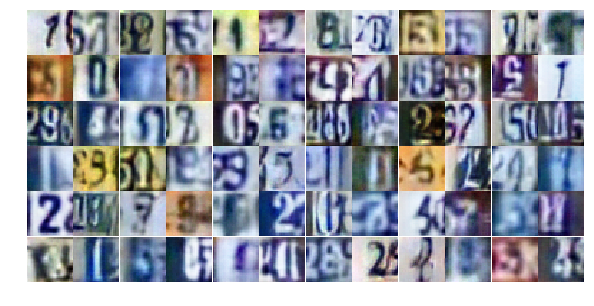

Epoch 20/25... Discriminator Loss: 0.5767... Generator Loss: 1.1991
Epoch 20/25... Discriminator Loss: 1.0076... Generator Loss: 0.7108
Epoch 20/25... Discriminator Loss: 1.5020... Generator Loss: 0.3702
Epoch 20/25... Discriminator Loss: 1.0925... Generator Loss: 0.6657
Epoch 20/25... Discriminator Loss: 0.4612... Generator Loss: 1.4523
Epoch 20/25... Discriminator Loss: 0.4738... Generator Loss: 1.5280
Epoch 20/25... Discriminator Loss: 1.0482... Generator Loss: 0.6342
Epoch 20/25... Discriminator Loss: 0.7934... Generator Loss: 0.8937
Epoch 20/25... Discriminator Loss: 0.7972... Generator Loss: 0.8363
Epoch 20/25... Discriminator Loss: 1.0446... Generator Loss: 0.6357


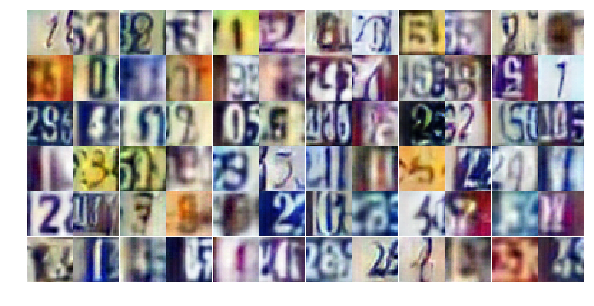

Epoch 20/25... Discriminator Loss: 2.3357... Generator Loss: 0.1979
Epoch 20/25... Discriminator Loss: 0.9057... Generator Loss: 1.0574
Epoch 20/25... Discriminator Loss: 0.6572... Generator Loss: 1.3993
Epoch 20/25... Discriminator Loss: 0.9653... Generator Loss: 0.7966
Epoch 20/25... Discriminator Loss: 0.6766... Generator Loss: 1.5506
Epoch 20/25... Discriminator Loss: 1.1866... Generator Loss: 1.0893
Epoch 20/25... Discriminator Loss: 1.5119... Generator Loss: 0.4648
Epoch 20/25... Discriminator Loss: 0.8049... Generator Loss: 1.0128
Epoch 20/25... Discriminator Loss: 0.7468... Generator Loss: 0.9170
Epoch 20/25... Discriminator Loss: 1.1468... Generator Loss: 0.5775


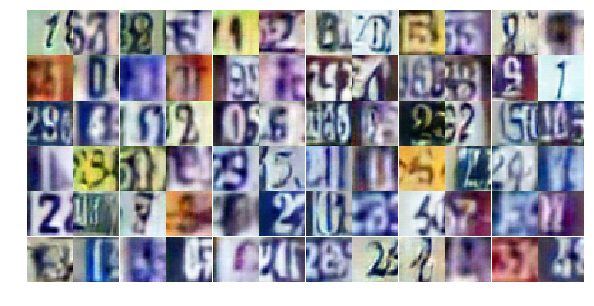

Epoch 20/25... Discriminator Loss: 0.5223... Generator Loss: 1.2872
Epoch 20/25... Discriminator Loss: 0.9091... Generator Loss: 0.7634
Epoch 20/25... Discriminator Loss: 0.4046... Generator Loss: 1.4687
Epoch 20/25... Discriminator Loss: 1.4840... Generator Loss: 0.3949
Epoch 20/25... Discriminator Loss: 0.8728... Generator Loss: 0.8088
Epoch 20/25... Discriminator Loss: 0.4095... Generator Loss: 1.7960
Epoch 20/25... Discriminator Loss: 0.5815... Generator Loss: 1.2813
Epoch 20/25... Discriminator Loss: 1.8336... Generator Loss: 0.2813
Epoch 20/25... Discriminator Loss: 0.8795... Generator Loss: 0.8266
Epoch 20/25... Discriminator Loss: 0.5772... Generator Loss: 1.1658


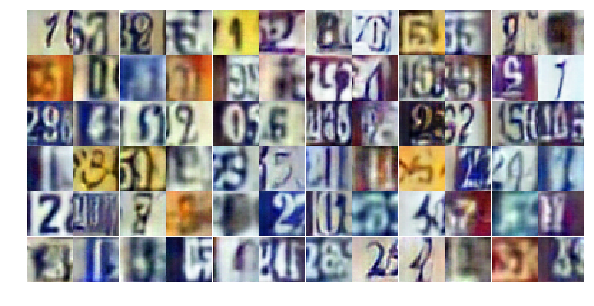

Epoch 20/25... Discriminator Loss: 0.9858... Generator Loss: 0.7258
Epoch 20/25... Discriminator Loss: 0.5751... Generator Loss: 1.1026
Epoch 20/25... Discriminator Loss: 1.1424... Generator Loss: 0.5758
Epoch 20/25... Discriminator Loss: 0.4881... Generator Loss: 1.4430
Epoch 20/25... Discriminator Loss: 1.0185... Generator Loss: 0.6858
Epoch 20/25... Discriminator Loss: 0.5753... Generator Loss: 1.3690
Epoch 20/25... Discriminator Loss: 0.8285... Generator Loss: 0.9146
Epoch 20/25... Discriminator Loss: 0.8953... Generator Loss: 0.7868
Epoch 20/25... Discriminator Loss: 0.7599... Generator Loss: 0.9019
Epoch 20/25... Discriminator Loss: 0.8251... Generator Loss: 0.8067


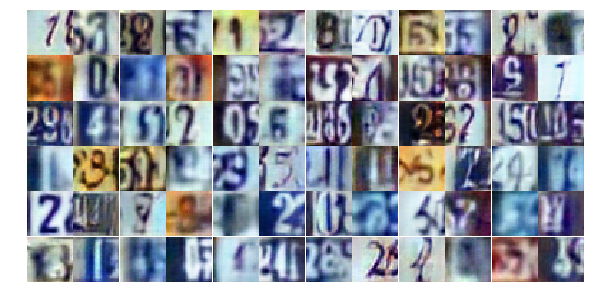

Epoch 20/25... Discriminator Loss: 1.0880... Generator Loss: 0.6774
Epoch 20/25... Discriminator Loss: 1.2457... Generator Loss: 0.4518
Epoch 20/25... Discriminator Loss: 0.6847... Generator Loss: 2.3270
Epoch 20/25... Discriminator Loss: 0.6846... Generator Loss: 0.9667
Epoch 20/25... Discriminator Loss: 0.7517... Generator Loss: 0.9569
Epoch 20/25... Discriminator Loss: 0.9658... Generator Loss: 0.7317
Epoch 20/25... Discriminator Loss: 0.9891... Generator Loss: 0.6547
Epoch 20/25... Discriminator Loss: 0.4639... Generator Loss: 1.4405
Epoch 20/25... Discriminator Loss: 0.9977... Generator Loss: 0.6243
Epoch 20/25... Discriminator Loss: 0.6838... Generator Loss: 0.9646


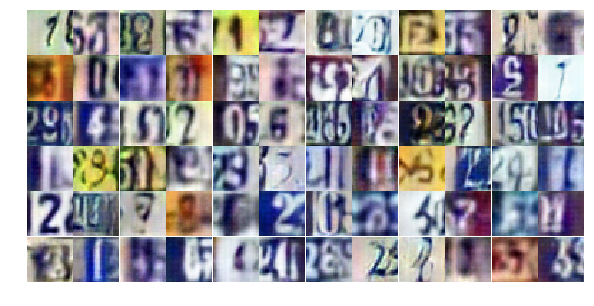

Epoch 20/25... Discriminator Loss: 0.4018... Generator Loss: 1.7728
Epoch 20/25... Discriminator Loss: 0.9029... Generator Loss: 2.0385
Epoch 20/25... Discriminator Loss: 0.7169... Generator Loss: 1.1876
Epoch 20/25... Discriminator Loss: 1.6962... Generator Loss: 0.3569
Epoch 20/25... Discriminator Loss: 1.0693... Generator Loss: 0.6156
Epoch 20/25... Discriminator Loss: 0.5746... Generator Loss: 1.1795
Epoch 21/25... Discriminator Loss: 1.1351... Generator Loss: 0.5659
Epoch 21/25... Discriminator Loss: 1.1921... Generator Loss: 0.5419
Epoch 21/25... Discriminator Loss: 1.2154... Generator Loss: 0.5049
Epoch 21/25... Discriminator Loss: 0.8676... Generator Loss: 0.8933


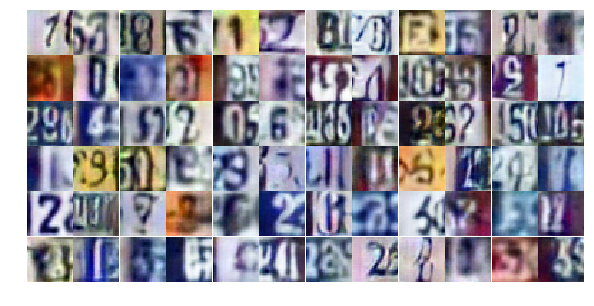

Epoch 21/25... Discriminator Loss: 0.9723... Generator Loss: 0.7230
Epoch 21/25... Discriminator Loss: 1.2938... Generator Loss: 0.4837
Epoch 21/25... Discriminator Loss: 0.3174... Generator Loss: 2.0018
Epoch 21/25... Discriminator Loss: 0.5623... Generator Loss: 1.0603
Epoch 21/25... Discriminator Loss: 0.7564... Generator Loss: 0.9847
Epoch 21/25... Discriminator Loss: 0.4047... Generator Loss: 1.6088
Epoch 21/25... Discriminator Loss: 0.6233... Generator Loss: 1.1276
Epoch 21/25... Discriminator Loss: 1.3654... Generator Loss: 0.5334
Epoch 21/25... Discriminator Loss: 0.7918... Generator Loss: 0.8587
Epoch 21/25... Discriminator Loss: 1.3705... Generator Loss: 0.4011


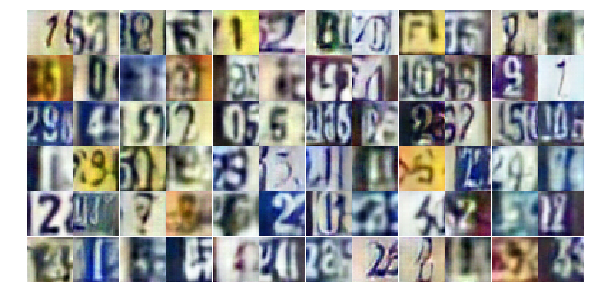

Epoch 21/25... Discriminator Loss: 0.2819... Generator Loss: 1.8521
Epoch 21/25... Discriminator Loss: 0.6746... Generator Loss: 0.9881
Epoch 21/25... Discriminator Loss: 1.3002... Generator Loss: 0.6186
Epoch 21/25... Discriminator Loss: 1.3587... Generator Loss: 0.4250
Epoch 21/25... Discriminator Loss: 0.4992... Generator Loss: 1.6852
Epoch 21/25... Discriminator Loss: 1.0648... Generator Loss: 0.7848
Epoch 21/25... Discriminator Loss: 0.7508... Generator Loss: 0.9158
Epoch 21/25... Discriminator Loss: 0.4570... Generator Loss: 1.6655
Epoch 21/25... Discriminator Loss: 0.5561... Generator Loss: 1.4546
Epoch 21/25... Discriminator Loss: 0.6053... Generator Loss: 1.2261


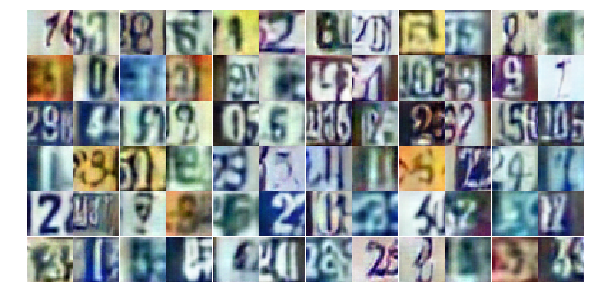

Epoch 21/25... Discriminator Loss: 1.3644... Generator Loss: 0.4486
Epoch 21/25... Discriminator Loss: 0.3434... Generator Loss: 1.8478
Epoch 21/25... Discriminator Loss: 0.9897... Generator Loss: 0.7223
Epoch 21/25... Discriminator Loss: 0.7685... Generator Loss: 1.0828
Epoch 21/25... Discriminator Loss: 0.7679... Generator Loss: 1.1254
Epoch 21/25... Discriminator Loss: 1.0099... Generator Loss: 0.8572
Epoch 21/25... Discriminator Loss: 0.5667... Generator Loss: 1.1288
Epoch 21/25... Discriminator Loss: 1.0117... Generator Loss: 0.6468
Epoch 21/25... Discriminator Loss: 1.9240... Generator Loss: 0.3173
Epoch 21/25... Discriminator Loss: 2.0321... Generator Loss: 0.2938


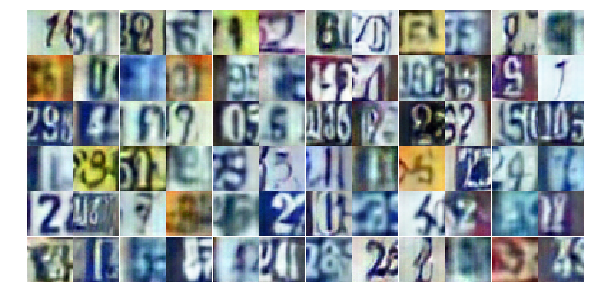

Epoch 21/25... Discriminator Loss: 0.9907... Generator Loss: 0.7262
Epoch 21/25... Discriminator Loss: 0.5855... Generator Loss: 1.1944
Epoch 21/25... Discriminator Loss: 0.6307... Generator Loss: 1.1339
Epoch 21/25... Discriminator Loss: 0.5271... Generator Loss: 1.2879
Epoch 21/25... Discriminator Loss: 0.6200... Generator Loss: 0.9894
Epoch 21/25... Discriminator Loss: 0.9503... Generator Loss: 0.7731
Epoch 21/25... Discriminator Loss: 0.9680... Generator Loss: 0.6461
Epoch 21/25... Discriminator Loss: 1.4360... Generator Loss: 0.3860
Epoch 21/25... Discriminator Loss: 0.7431... Generator Loss: 0.9077
Epoch 21/25... Discriminator Loss: 0.4810... Generator Loss: 1.6106


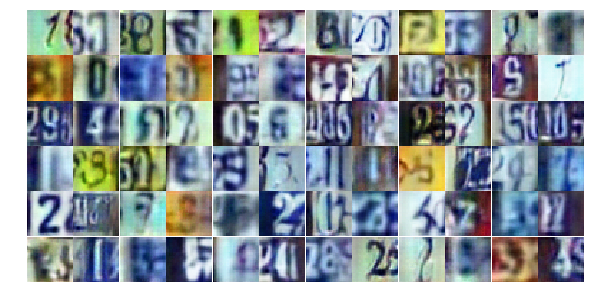

Epoch 21/25... Discriminator Loss: 0.8405... Generator Loss: 0.8371
Epoch 21/25... Discriminator Loss: 1.0897... Generator Loss: 0.7324
Epoch 21/25... Discriminator Loss: 0.6220... Generator Loss: 1.1191
Epoch 21/25... Discriminator Loss: 0.6985... Generator Loss: 1.2437
Epoch 21/25... Discriminator Loss: 0.3655... Generator Loss: 1.9364
Epoch 21/25... Discriminator Loss: 0.7116... Generator Loss: 1.0723
Epoch 21/25... Discriminator Loss: 0.9092... Generator Loss: 0.7198
Epoch 21/25... Discriminator Loss: 0.8872... Generator Loss: 0.7528
Epoch 21/25... Discriminator Loss: 0.9045... Generator Loss: 0.7220
Epoch 21/25... Discriminator Loss: 0.8392... Generator Loss: 0.8567


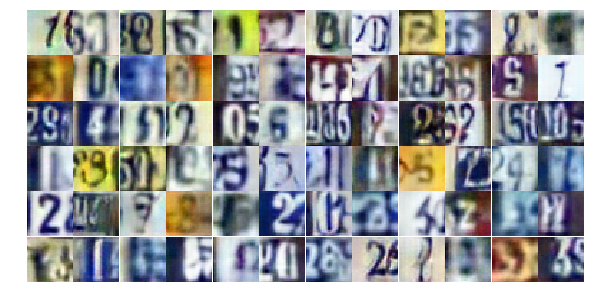

Epoch 21/25... Discriminator Loss: 0.4721... Generator Loss: 1.6730
Epoch 21/25... Discriminator Loss: 0.9848... Generator Loss: 0.8076
Epoch 21/25... Discriminator Loss: 0.6096... Generator Loss: 1.1055
Epoch 22/25... Discriminator Loss: 0.7802... Generator Loss: 0.9979
Epoch 22/25... Discriminator Loss: 0.6774... Generator Loss: 1.2568
Epoch 22/25... Discriminator Loss: 0.9291... Generator Loss: 0.7266
Epoch 22/25... Discriminator Loss: 0.5232... Generator Loss: 1.2923
Epoch 22/25... Discriminator Loss: 0.4251... Generator Loss: 1.4220
Epoch 22/25... Discriminator Loss: 0.8271... Generator Loss: 0.8066
Epoch 22/25... Discriminator Loss: 0.6607... Generator Loss: 1.7027


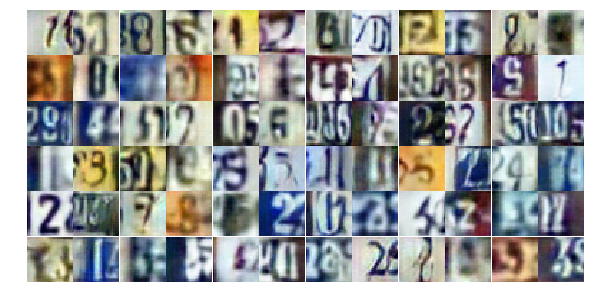

Epoch 22/25... Discriminator Loss: 0.5421... Generator Loss: 1.5749
Epoch 22/25... Discriminator Loss: 0.9903... Generator Loss: 0.6552
Epoch 22/25... Discriminator Loss: 1.6068... Generator Loss: 0.3113
Epoch 22/25... Discriminator Loss: 0.6429... Generator Loss: 1.0475
Epoch 22/25... Discriminator Loss: 1.6973... Generator Loss: 0.3141
Epoch 22/25... Discriminator Loss: 0.6357... Generator Loss: 1.2161
Epoch 22/25... Discriminator Loss: 0.6129... Generator Loss: 1.3082
Epoch 22/25... Discriminator Loss: 0.4719... Generator Loss: 1.8795
Epoch 22/25... Discriminator Loss: 1.1174... Generator Loss: 0.5573
Epoch 22/25... Discriminator Loss: 1.7344... Generator Loss: 0.3218


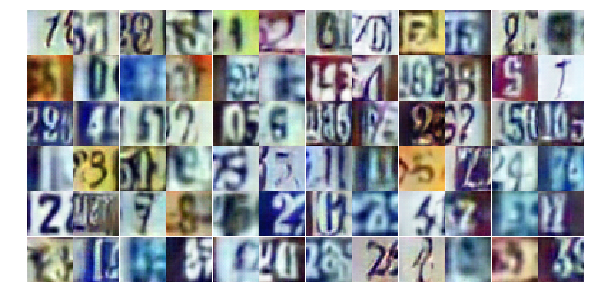

Epoch 22/25... Discriminator Loss: 1.3776... Generator Loss: 6.1698
Epoch 22/25... Discriminator Loss: 0.5339... Generator Loss: 1.5378
Epoch 22/25... Discriminator Loss: 1.2710... Generator Loss: 0.5362
Epoch 22/25... Discriminator Loss: 0.4215... Generator Loss: 1.5846
Epoch 22/25... Discriminator Loss: 0.5631... Generator Loss: 1.0978
Epoch 22/25... Discriminator Loss: 0.7010... Generator Loss: 1.2866
Epoch 22/25... Discriminator Loss: 0.4910... Generator Loss: 1.4850
Epoch 22/25... Discriminator Loss: 0.3679... Generator Loss: 1.5969
Epoch 22/25... Discriminator Loss: 0.4595... Generator Loss: 1.3315
Epoch 22/25... Discriminator Loss: 1.1741... Generator Loss: 0.5277


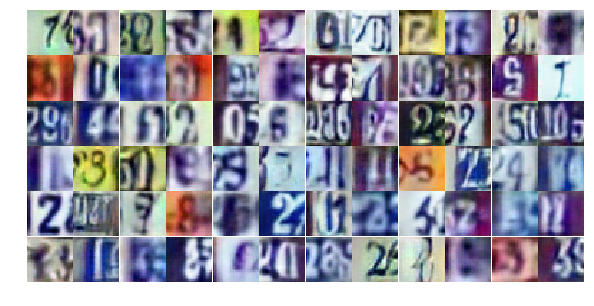

Epoch 22/25... Discriminator Loss: 0.3103... Generator Loss: 1.9399
Epoch 22/25... Discriminator Loss: 0.5539... Generator Loss: 1.2675
Epoch 22/25... Discriminator Loss: 0.5915... Generator Loss: 1.3039
Epoch 22/25... Discriminator Loss: 0.8466... Generator Loss: 0.7983
Epoch 22/25... Discriminator Loss: 1.0677... Generator Loss: 0.5956
Epoch 22/25... Discriminator Loss: 0.9217... Generator Loss: 0.7853
Epoch 22/25... Discriminator Loss: 1.4425... Generator Loss: 0.5392
Epoch 22/25... Discriminator Loss: 0.6464... Generator Loss: 1.5471
Epoch 22/25... Discriminator Loss: 1.4461... Generator Loss: 0.4252
Epoch 22/25... Discriminator Loss: 0.7240... Generator Loss: 0.9882


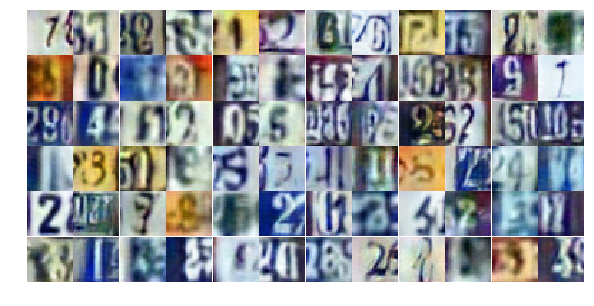

Epoch 22/25... Discriminator Loss: 0.9101... Generator Loss: 0.7200
Epoch 22/25... Discriminator Loss: 0.4922... Generator Loss: 1.5490
Epoch 22/25... Discriminator Loss: 0.4014... Generator Loss: 1.3635
Epoch 22/25... Discriminator Loss: 0.5616... Generator Loss: 1.2703
Epoch 22/25... Discriminator Loss: 0.4936... Generator Loss: 1.2270
Epoch 22/25... Discriminator Loss: 0.2971... Generator Loss: 1.9437
Epoch 22/25... Discriminator Loss: 0.6184... Generator Loss: 1.1991
Epoch 22/25... Discriminator Loss: 0.4991... Generator Loss: 1.9358
Epoch 22/25... Discriminator Loss: 1.6604... Generator Loss: 0.3346
Epoch 22/25... Discriminator Loss: 0.5842... Generator Loss: 1.2475


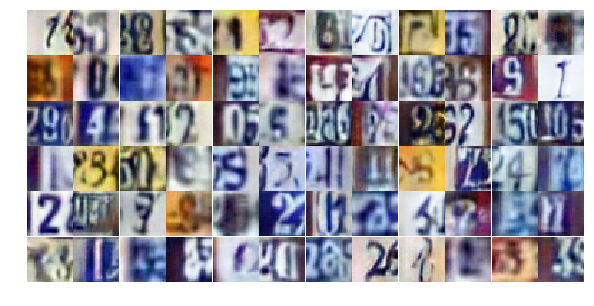

Epoch 22/25... Discriminator Loss: 0.9036... Generator Loss: 0.8264
Epoch 22/25... Discriminator Loss: 0.6598... Generator Loss: 1.0587
Epoch 22/25... Discriminator Loss: 0.6519... Generator Loss: 1.1977
Epoch 22/25... Discriminator Loss: 1.0956... Generator Loss: 0.6045
Epoch 22/25... Discriminator Loss: 1.2234... Generator Loss: 0.5121
Epoch 22/25... Discriminator Loss: 1.0490... Generator Loss: 4.7283
Epoch 22/25... Discriminator Loss: 1.7667... Generator Loss: 0.4045
Epoch 22/25... Discriminator Loss: 0.9851... Generator Loss: 0.6837
Epoch 22/25... Discriminator Loss: 0.8442... Generator Loss: 1.5412
Epoch 22/25... Discriminator Loss: 0.6670... Generator Loss: 1.0376


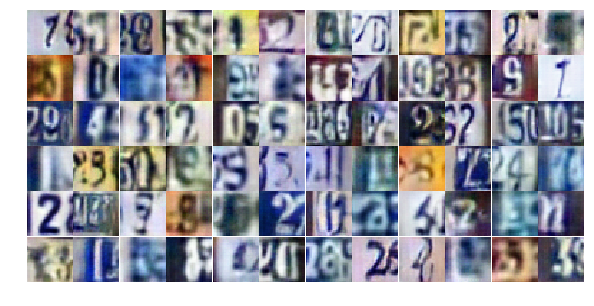

Epoch 23/25... Discriminator Loss: 0.8114... Generator Loss: 0.8533
Epoch 23/25... Discriminator Loss: 0.4522... Generator Loss: 1.4123
Epoch 23/25... Discriminator Loss: 0.6839... Generator Loss: 1.0059
Epoch 23/25... Discriminator Loss: 0.6730... Generator Loss: 1.0577
Epoch 23/25... Discriminator Loss: 0.6224... Generator Loss: 1.2448
Epoch 23/25... Discriminator Loss: 1.8234... Generator Loss: 0.2722
Epoch 23/25... Discriminator Loss: 1.1422... Generator Loss: 0.5756
Epoch 23/25... Discriminator Loss: 0.6462... Generator Loss: 0.9761
Epoch 23/25... Discriminator Loss: 0.7017... Generator Loss: 0.9699
Epoch 23/25... Discriminator Loss: 0.4923... Generator Loss: 1.3224


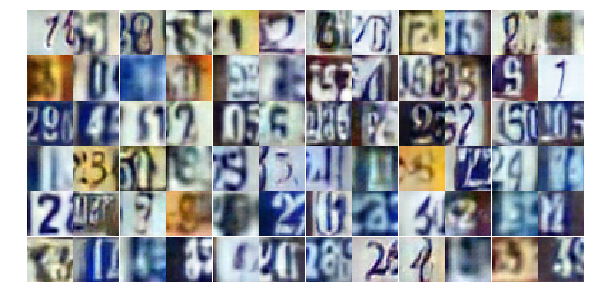

Epoch 23/25... Discriminator Loss: 0.5100... Generator Loss: 1.7223
Epoch 23/25... Discriminator Loss: 0.8049... Generator Loss: 0.8030
Epoch 23/25... Discriminator Loss: 0.8071... Generator Loss: 0.9514
Epoch 23/25... Discriminator Loss: 0.8593... Generator Loss: 0.8353
Epoch 23/25... Discriminator Loss: 0.7816... Generator Loss: 0.9141
Epoch 23/25... Discriminator Loss: 0.6407... Generator Loss: 1.1201
Epoch 23/25... Discriminator Loss: 1.0072... Generator Loss: 0.6729
Epoch 23/25... Discriminator Loss: 0.5437... Generator Loss: 1.9134
Epoch 23/25... Discriminator Loss: 0.9391... Generator Loss: 0.7150
Epoch 23/25... Discriminator Loss: 0.5881... Generator Loss: 1.9193


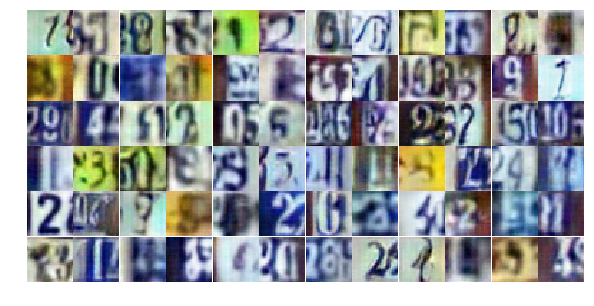

Epoch 23/25... Discriminator Loss: 1.1958... Generator Loss: 0.6129
Epoch 23/25... Discriminator Loss: 0.8028... Generator Loss: 0.8157
Epoch 23/25... Discriminator Loss: 0.7236... Generator Loss: 1.0097
Epoch 23/25... Discriminator Loss: 0.5555... Generator Loss: 1.2864
Epoch 23/25... Discriminator Loss: 0.4400... Generator Loss: 1.6831
Epoch 23/25... Discriminator Loss: 0.7326... Generator Loss: 2.5224
Epoch 23/25... Discriminator Loss: 0.5188... Generator Loss: 1.5300
Epoch 23/25... Discriminator Loss: 0.6961... Generator Loss: 1.0872
Epoch 23/25... Discriminator Loss: 0.8578... Generator Loss: 0.8413
Epoch 23/25... Discriminator Loss: 0.6806... Generator Loss: 1.3747


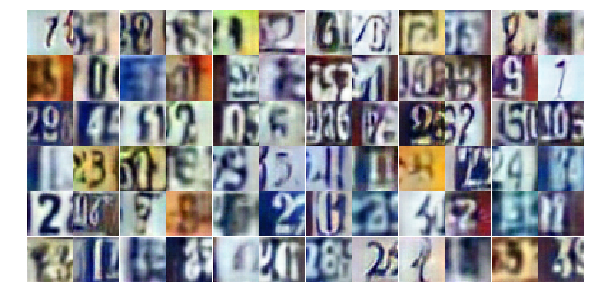

Epoch 23/25... Discriminator Loss: 0.5187... Generator Loss: 1.2758
Epoch 23/25... Discriminator Loss: 0.8333... Generator Loss: 0.8110
Epoch 23/25... Discriminator Loss: 0.4752... Generator Loss: 1.5581
Epoch 23/25... Discriminator Loss: 1.5495... Generator Loss: 0.3266
Epoch 23/25... Discriminator Loss: 0.9948... Generator Loss: 0.7532
Epoch 23/25... Discriminator Loss: 1.1875... Generator Loss: 0.6474
Epoch 23/25... Discriminator Loss: 1.3827... Generator Loss: 0.4549
Epoch 23/25... Discriminator Loss: 0.6581... Generator Loss: 1.1071
Epoch 23/25... Discriminator Loss: 0.3580... Generator Loss: 1.6484
Epoch 23/25... Discriminator Loss: 0.5339... Generator Loss: 1.2127


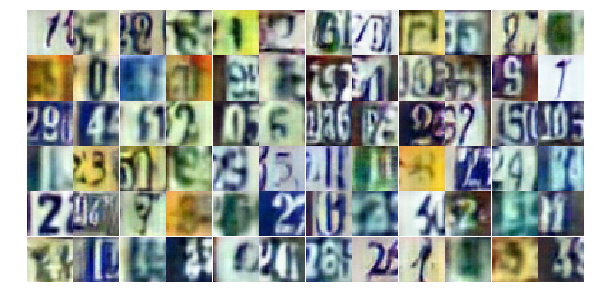

Epoch 23/25... Discriminator Loss: 1.2295... Generator Loss: 0.5313
Epoch 23/25... Discriminator Loss: 0.7961... Generator Loss: 0.9140
Epoch 23/25... Discriminator Loss: 0.7391... Generator Loss: 0.9999
Epoch 23/25... Discriminator Loss: 0.5518... Generator Loss: 1.2765
Epoch 23/25... Discriminator Loss: 0.7569... Generator Loss: 1.7873
Epoch 23/25... Discriminator Loss: 1.0795... Generator Loss: 0.6349
Epoch 23/25... Discriminator Loss: 0.5793... Generator Loss: 1.1967
Epoch 23/25... Discriminator Loss: 0.8638... Generator Loss: 0.9326
Epoch 23/25... Discriminator Loss: 0.6652... Generator Loss: 1.0410
Epoch 23/25... Discriminator Loss: 0.5601... Generator Loss: 1.2485


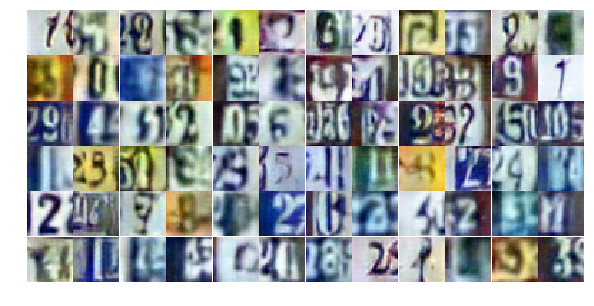

Epoch 23/25... Discriminator Loss: 0.5958... Generator Loss: 1.1583
Epoch 23/25... Discriminator Loss: 1.1916... Generator Loss: 0.5314
Epoch 23/25... Discriminator Loss: 1.0061... Generator Loss: 0.6438
Epoch 23/25... Discriminator Loss: 0.3892... Generator Loss: 1.5094
Epoch 23/25... Discriminator Loss: 1.4646... Generator Loss: 0.4406
Epoch 23/25... Discriminator Loss: 0.9543... Generator Loss: 3.3827
Epoch 23/25... Discriminator Loss: 1.1482... Generator Loss: 0.8165
Epoch 24/25... Discriminator Loss: 0.5857... Generator Loss: 1.3641
Epoch 24/25... Discriminator Loss: 1.0195... Generator Loss: 0.7115
Epoch 24/25... Discriminator Loss: 0.9119... Generator Loss: 1.1071


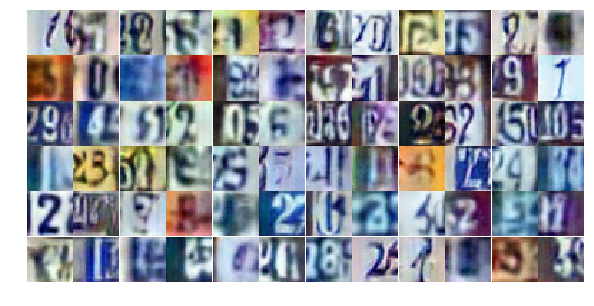

Epoch 24/25... Discriminator Loss: 0.6728... Generator Loss: 0.9592
Epoch 24/25... Discriminator Loss: 0.6701... Generator Loss: 0.9599
Epoch 24/25... Discriminator Loss: 0.8144... Generator Loss: 0.8341
Epoch 24/25... Discriminator Loss: 0.8824... Generator Loss: 1.8354
Epoch 24/25... Discriminator Loss: 0.7295... Generator Loss: 0.9514
Epoch 24/25... Discriminator Loss: 0.6464... Generator Loss: 1.0493
Epoch 24/25... Discriminator Loss: 0.6589... Generator Loss: 1.1040
Epoch 24/25... Discriminator Loss: 1.9293... Generator Loss: 0.2391
Epoch 24/25... Discriminator Loss: 0.3097... Generator Loss: 1.9158
Epoch 24/25... Discriminator Loss: 0.5721... Generator Loss: 1.2178


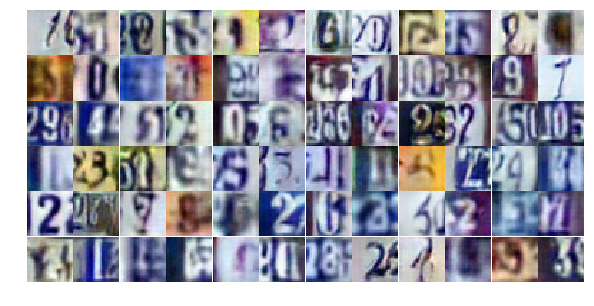

Epoch 24/25... Discriminator Loss: 1.2506... Generator Loss: 0.5241
Epoch 24/25... Discriminator Loss: 1.1527... Generator Loss: 0.5612
Epoch 24/25... Discriminator Loss: 1.1926... Generator Loss: 0.5406
Epoch 24/25... Discriminator Loss: 0.6728... Generator Loss: 1.0135
Epoch 24/25... Discriminator Loss: 1.2040... Generator Loss: 2.0921
Epoch 24/25... Discriminator Loss: 7.1213... Generator Loss: 0.0039
Epoch 24/25... Discriminator Loss: 1.2073... Generator Loss: 0.6950
Epoch 24/25... Discriminator Loss: 1.1012... Generator Loss: 0.7256
Epoch 24/25... Discriminator Loss: 0.7753... Generator Loss: 1.0861
Epoch 24/25... Discriminator Loss: 0.6455... Generator Loss: 1.0256


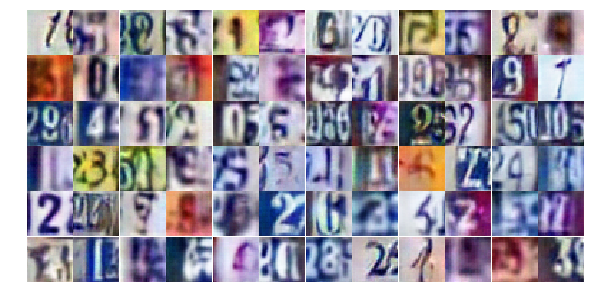

Epoch 24/25... Discriminator Loss: 0.6932... Generator Loss: 1.0888
Epoch 24/25... Discriminator Loss: 0.6349... Generator Loss: 1.5925
Epoch 24/25... Discriminator Loss: 0.6136... Generator Loss: 1.4419
Epoch 24/25... Discriminator Loss: 1.1901... Generator Loss: 0.6307
Epoch 24/25... Discriminator Loss: 0.9448... Generator Loss: 0.7008
Epoch 24/25... Discriminator Loss: 0.5919... Generator Loss: 1.1143
Epoch 24/25... Discriminator Loss: 0.4460... Generator Loss: 1.3696
Epoch 24/25... Discriminator Loss: 0.6596... Generator Loss: 1.1287
Epoch 24/25... Discriminator Loss: 0.7608... Generator Loss: 0.9578
Epoch 24/25... Discriminator Loss: 1.1930... Generator Loss: 0.5182


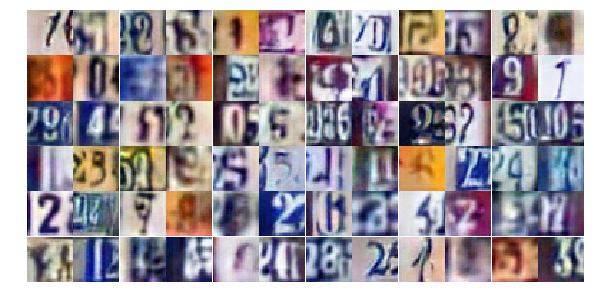

Epoch 24/25... Discriminator Loss: 0.5630... Generator Loss: 1.1107
Epoch 24/25... Discriminator Loss: 0.7921... Generator Loss: 0.9382
Epoch 24/25... Discriminator Loss: 0.8081... Generator Loss: 0.8817
Epoch 24/25... Discriminator Loss: 1.3346... Generator Loss: 0.4263
Epoch 24/25... Discriminator Loss: 0.9797... Generator Loss: 0.6887
Epoch 24/25... Discriminator Loss: 0.6829... Generator Loss: 0.9991
Epoch 24/25... Discriminator Loss: 1.4002... Generator Loss: 0.4274
Epoch 24/25... Discriminator Loss: 0.8749... Generator Loss: 0.7373
Epoch 24/25... Discriminator Loss: 0.9614... Generator Loss: 0.7131
Epoch 24/25... Discriminator Loss: 0.5704... Generator Loss: 1.3787


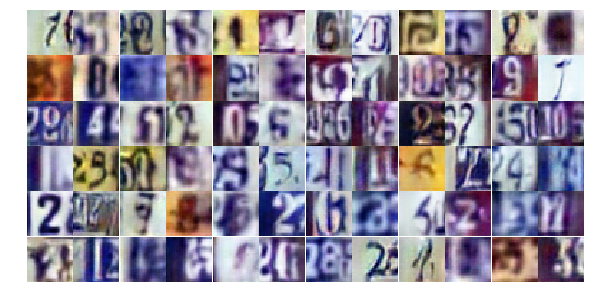

Epoch 24/25... Discriminator Loss: 0.8727... Generator Loss: 0.7602
Epoch 24/25... Discriminator Loss: 1.4624... Generator Loss: 0.3669
Epoch 24/25... Discriminator Loss: 1.3850... Generator Loss: 0.4541
Epoch 24/25... Discriminator Loss: 0.7951... Generator Loss: 0.9980
Epoch 24/25... Discriminator Loss: 1.5934... Generator Loss: 0.3766
Epoch 24/25... Discriminator Loss: 0.7839... Generator Loss: 1.0176
Epoch 24/25... Discriminator Loss: 0.8611... Generator Loss: 0.8900
Epoch 24/25... Discriminator Loss: 0.5857... Generator Loss: 1.1516
Epoch 24/25... Discriminator Loss: 0.7410... Generator Loss: 1.7759
Epoch 24/25... Discriminator Loss: 0.9929... Generator Loss: 0.7286


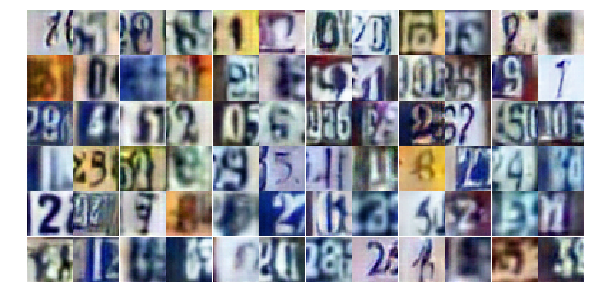

Epoch 24/25... Discriminator Loss: 0.6297... Generator Loss: 1.1008
Epoch 24/25... Discriminator Loss: 1.4551... Generator Loss: 0.3805
Epoch 24/25... Discriminator Loss: 1.0124... Generator Loss: 0.6332
Epoch 24/25... Discriminator Loss: 0.7460... Generator Loss: 0.9062
Epoch 24/25... Discriminator Loss: 1.2103... Generator Loss: 0.4993
Epoch 25/25... Discriminator Loss: 0.8097... Generator Loss: 0.9294
Epoch 25/25... Discriminator Loss: 0.5198... Generator Loss: 1.5916
Epoch 25/25... Discriminator Loss: 0.6879... Generator Loss: 1.0368
Epoch 25/25... Discriminator Loss: 0.7563... Generator Loss: 0.9074
Epoch 25/25... Discriminator Loss: 0.6792... Generator Loss: 0.9992


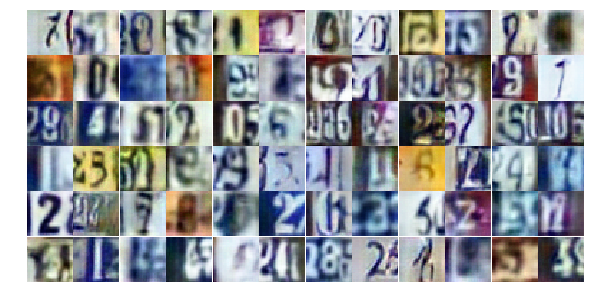

Epoch 25/25... Discriminator Loss: 0.9845... Generator Loss: 0.6178
Epoch 25/25... Discriminator Loss: 1.3039... Generator Loss: 0.5714
Epoch 25/25... Discriminator Loss: 0.4409... Generator Loss: 1.4405
Epoch 25/25... Discriminator Loss: 0.7942... Generator Loss: 2.7500
Epoch 25/25... Discriminator Loss: 0.6314... Generator Loss: 1.1220
Epoch 25/25... Discriminator Loss: 0.7692... Generator Loss: 0.8715
Epoch 25/25... Discriminator Loss: 0.6738... Generator Loss: 1.0784
Epoch 25/25... Discriminator Loss: 0.6433... Generator Loss: 1.1791
Epoch 25/25... Discriminator Loss: 0.4201... Generator Loss: 1.6508
Epoch 25/25... Discriminator Loss: 0.9597... Generator Loss: 0.7310


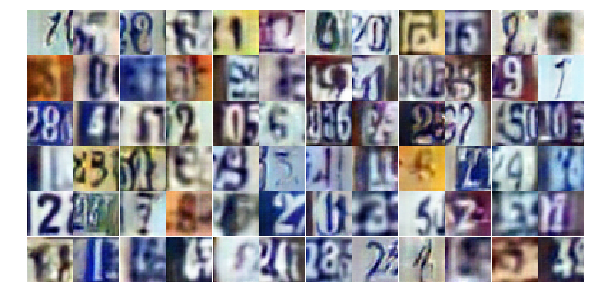

Epoch 25/25... Discriminator Loss: 1.0275... Generator Loss: 0.6363
Epoch 25/25... Discriminator Loss: 0.3999... Generator Loss: 1.4861
Epoch 25/25... Discriminator Loss: 1.0396... Generator Loss: 0.6846
Epoch 25/25... Discriminator Loss: 0.5643... Generator Loss: 1.3064
Epoch 25/25... Discriminator Loss: 0.8986... Generator Loss: 0.7433
Epoch 25/25... Discriminator Loss: 0.7999... Generator Loss: 0.8940
Epoch 25/25... Discriminator Loss: 1.2201... Generator Loss: 0.5180
Epoch 25/25... Discriminator Loss: 0.8825... Generator Loss: 1.4678
Epoch 25/25... Discriminator Loss: 0.4780... Generator Loss: 1.5353
Epoch 25/25... Discriminator Loss: 0.4939... Generator Loss: 1.3767


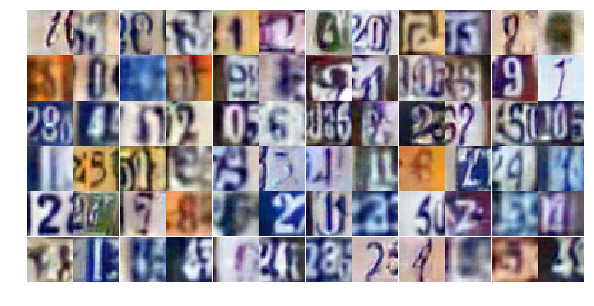

Epoch 25/25... Discriminator Loss: 1.3370... Generator Loss: 0.4486
Epoch 25/25... Discriminator Loss: 0.3942... Generator Loss: 1.8562
Epoch 25/25... Discriminator Loss: 1.8963... Generator Loss: 0.3482
Epoch 25/25... Discriminator Loss: 0.4278... Generator Loss: 1.4552
Epoch 25/25... Discriminator Loss: 0.8105... Generator Loss: 0.9568
Epoch 25/25... Discriminator Loss: 0.6568... Generator Loss: 0.9687
Epoch 25/25... Discriminator Loss: 0.5583... Generator Loss: 1.6783
Epoch 25/25... Discriminator Loss: 0.6441... Generator Loss: 1.4358
Epoch 25/25... Discriminator Loss: 0.8764... Generator Loss: 1.2941
Epoch 25/25... Discriminator Loss: 0.4407... Generator Loss: 1.4642


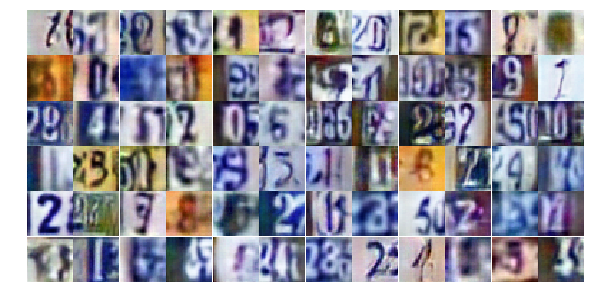

Epoch 25/25... Discriminator Loss: 0.7001... Generator Loss: 0.9601
Epoch 25/25... Discriminator Loss: 0.5022... Generator Loss: 1.3532
Epoch 25/25... Discriminator Loss: 0.7262... Generator Loss: 0.9476
Epoch 25/25... Discriminator Loss: 0.7084... Generator Loss: 1.0267
Epoch 25/25... Discriminator Loss: 1.1381... Generator Loss: 0.5575
Epoch 25/25... Discriminator Loss: 1.4595... Generator Loss: 0.4459
Epoch 25/25... Discriminator Loss: 0.6024... Generator Loss: 1.3050
Epoch 25/25... Discriminator Loss: 0.7636... Generator Loss: 0.9208
Epoch 25/25... Discriminator Loss: 1.8393... Generator Loss: 0.3006
Epoch 25/25... Discriminator Loss: 1.0724... Generator Loss: 0.6655


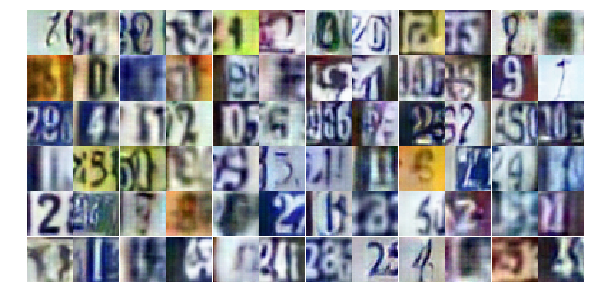

Epoch 25/25... Discriminator Loss: 2.1329... Generator Loss: 3.5107
Epoch 25/25... Discriminator Loss: 1.0533... Generator Loss: 0.7183
Epoch 25/25... Discriminator Loss: 1.4304... Generator Loss: 0.4540
Epoch 25/25... Discriminator Loss: 1.3464... Generator Loss: 0.5448
Epoch 25/25... Discriminator Loss: 1.0540... Generator Loss: 0.6313
Epoch 25/25... Discriminator Loss: 0.3812... Generator Loss: 1.7763
Epoch 25/25... Discriminator Loss: 1.0005... Generator Loss: 0.6574
Epoch 25/25... Discriminator Loss: 0.4880... Generator Loss: 1.3629
Epoch 25/25... Discriminator Loss: 0.8499... Generator Loss: 0.8262
Epoch 25/25... Discriminator Loss: 0.9220... Generator Loss: 0.6725


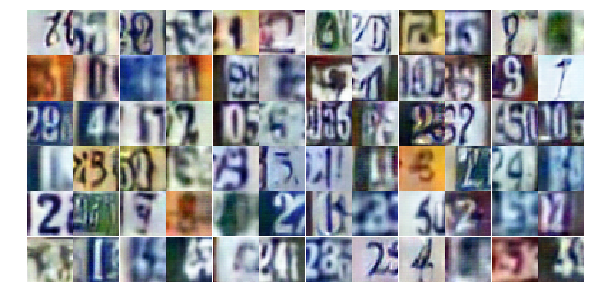

Epoch 25/25... Discriminator Loss: 0.4489... Generator Loss: 1.4713
Epoch 25/25... Discriminator Loss: 1.7895... Generator Loss: 0.2885


In [27]:
# Load the data and train the network here
dataset = Dataset(trainset, testset)
losses, samples = train(net, dataset, epochs, batch_size, figsize=(10,5))

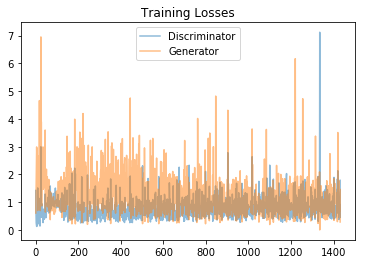

In [28]:
fig, ax = plt.subplots()
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses.T[1], label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

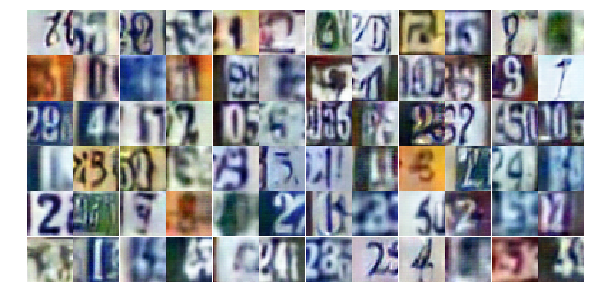

In [29]:
_ = view_samples(-1, samples, 6, 12, figsize=(10,5))